## Initialization

In [742]:
import numpy as np
import numpy.ma as ma
import matplotlib.pyplot as plt
import operator as op
import inspect

In [743]:
from wpca import PCA, WPCA, EMPCA
from tga import TGA

In [744]:
import bossdata
print(bossdata.__version__)

0.3.1


In [745]:
import bossdata.path
import bossdata.remote
import bossdata.meta 
import bossdata.spec as spec
import bossdata.plate as plate

In [746]:
import os
os.environ["BOSS_DATA_URL"] = 'http://dr12.sdss3.org'
os.environ["BOSS_LOCAL_ROOT"] = '/mnt/kunjias/sdss'
os.environ["BOSS_SAS_PATH"] = '/sas/dr12/boss'
os.environ["BOSS_REDUX_VERSION"]='v5_7_0'

In [747]:
os.getcwd()

'/data/notebooks/kunjias'

In [748]:
finder = bossdata.path.Finder()
mirror = bossdata.remote.Manager()

### Extract Sky Fibers
A function that return a numpy array of sky fiber IDs given a plate number.

In [749]:
def get_skyfiber(plate_number = 4042, mjd=55626):
    '''Return a numpy array of sky fiber IDs from a given plate
    
    Parameters
    -----------
    plate_number: Specified plate number. Default plate number is 4042.
    mjd: modified julian date of the observation associated with input plate. Default mjd is 55626.
    
    Output
    -------
    An array of sky fiber IDs.
    '''
    
    plate_file_path = finder.get_plate_spec_path(plate_number, mjd)
    plate_file = mirror.get(plate_file_path, progress_min_size=2, auto_download=True, local_paths=None)
    whole_plate = plate.PlateFile(plate_file)
    plug_map = whole_plate.plug_map
    plug_map_by_OBJTYPE = plug_map.group_by('OBJTYPE')
    
    #print(plug_map_by_OBJTYPE.groups.keys)
    #print(plug_map_by_OBJTYPE.groups.indices)
    #print(plug_map.group_by(['OBJTYPE','FIBERID']).groups.keys)
    
    sky = plug_map_by_OBJTYPE.groups[3]
    sky_fibers = np.array(sky['FIBERID'])
    sky_number = len(sky_fibers)
    
    print("Plate", plate_number, "contains", sky_number, "sky_fibers")
    return sky_fibers

In [1018]:
def classify_fiber(plate_number = 4042, mjd=55626):
    '''Return numpy arrays of fiber IDs group by type from a given plate.
    
    Parameters
    -----------
    plate_number: Specified plate number. Default plate number is 4042.
    mjd: modified julian date of the observation associated with input plate. Default mjd is 55626.
    
    Output
    -------
    An array of sky fiber IDs.
    '''
    
    plate_file_path = finder.get_plate_spec_path(plate_number, mjd)
    plate_file = mirror.get(plate_file_path, progress_min_size=2, auto_download=True, local_paths=None)
    whole_plate = plate.PlateFile(plate_file)
    plug_map = whole_plate.plug_map
    plug_map_by_OBJTYPE = plug_map.group_by('OBJTYPE')
    
    sky = plug_map_by_OBJTYPE.groups[3]
    sky_fibers = np.array(sky['FIBERID'])
    sky_number = len(sky_fibers)
        
    galaxy = plug_map_by_OBJTYPE.groups[0]
    galaxy_fibers = np.array(galaxy['FIBERID'])
    galaxy_number = len(galaxy_fibers)
    
    QSO = plug_map_by_OBJTYPE.groups[2]
    QSO_fibers = np.array(QSO['FIBERID'])
    QSO_number = len(QSO_fibers)
    
    Fstar = plug_map_by_OBJTYPE.groups[4]
    Fstar_fibers = np.array(Fstar['FIBERID'])
    Fstar_number = len(Fstar_fibers)
   
    print("Plate", plate_number, "contains", sky_number, "sky fibers,",
          galaxy_number, "galaxy fibers", QSO_number, "QSO fiber", 
          Fstar_number, "F type star fibers")
    yield sky_fibers
    yield galaxy_fibers
    yield QSO_fibers
    yield Fstar_fibers

#### Fibers by object type
There are 1000 fibers in total. Fibers 1-500 are in spectrograph I, fibers 501-1000 are in spectrograph II. Here, we focus on sky, galaxy, and QSO fibers in spectrograph I.

In [775]:
fibers1 = np.arange(1,501,1)

In [776]:
fibers2 = np.arange(501,1001,1)

In [777]:
fibers = np.arange(1,1001,1)

One function that select out fibers belonging to spectrograph I.

In [70]:
def spec1_fiber(fibers):
    '''Return a numpy array of fibers in spectrograph one.'''
    fibers1 = []
    for i in range(0,len(fibers)):
        if fibers[i] < 501:
            fibers1.append(fibers[i])
    fibers1_number = len(fibers1)
    print("Spectrograph 1 contains", fibers1_number, "fibers")
    return fibers1

#### Valid Exposure Data
A function that returns a masked array of valid data from given plate and exposure with specified fiber and spectrograph input.

In [83]:
def get_valid_data(plate_number, mjd, exposure, fiber_number, index, fibers, combined):
    '''Compute masked array of valid data from a given plate at specific mjd and exposure time.
    
    Parameters
    -----------
    plate_number: Specified plate number. Default plate number is 4042.
    
    mjd: modified julian date of the observation associated with input plate. Default mjd is 55626.
    
    exposure: Science exposure sequence number specifying requested exposure.
    
    fiber_number: fiber number to identify which spectrograph to retreive the exposure data,
    1-500 for spectrograph 1, and 501-1000 for spectrograph 2.
    
    index: identification for spectrograph, 1 for first spectrograph, and 2 for second spectrograph.
    
    fibers: a list of fiber IDs to obtain the spectra from
    
    combined: 
    
    Output
    -------
    A masked array of valid data of the input plate at specified exposure.
    '''
    combined_plan_path = finder.get_plate_plan_path(plate_number,mjd, combined=True)
    combined_plan_file = mirror.get(combined_plan_path, progress_min_size=2,auto_download=True, local_paths=None)
    combined_plan = plate.Plan(combined_plan_file)
    exp_spec_path = combined_plan.get_exposure_name(sequence_number=exposure,band='red',fiber=fiber_number,ftype='spCFrame')
    exp_spec_file = mirror.get(exp_spec_path)
    exp_spec_frame = plate.FrameFile(exp_spec_file, index, calibrated = True)
    valid_spec = exp_spec_frame.get_valid_data(fibers,pixel_quality_mask=None, include_wdisp=False, include_sky=True, use_ivar=True, use_loglam=False)
    
    return valid_spec

The valid data masked array contains 4 fields, 'wavelength', 'flux','ivar', and 'subtracted sky'. The total flux is sum of 'flux' and 'subtracted sky'.

#### Wavelength and Flux
Wavelength, SDSS predicted object flux, and total flux matrix of each fiber type across all exposures in spectrograph I.

In [182]:
def get_field(valid_data):
    "Compute masked array of wavelength and flux from a given masked array of valid data."
    wavelength = valid_data['wavelength']
    sdss_flux = valid_data['flux']
    sdss_sky = valid_data['sky']
    total_flux = np.ma.array(sdss_flux.data+sdss_sky.data, mask=list(map(op.and_,sdss_flux.mask,sdss_sky.mask)))
    
    yield wavelength
    yield sdss_flux
    yield sdss_sky
    yield total_flux

Weights by inverse variance, weighted average subtracted total flux, and scaled flux by subtracting weighted average and divided by noise standard deviation.

In [885]:
def get_weighted(valid_data):
    '''Compute masked array of inverse variance, weights, and weighted average
    from a given masked array of valid data.'''
    
    inverse_variance = valid_data['ivar']
    weights_median = np.ma.median(inverse_variance, axis=0)
    weights_filled = np.ma.filled(inverse_variance, fill_value = weights_median)
    weights_filled_zero = np.ma.filled(weights_filled, fill_value =0)
    
    a, b, c, d = get_field(valid_data)
    weighted_average = np.ma.average(d, axis=0,weights=weights_filled, returned=False)
    
    
    weighted_average_resized = np.tile(weighted_average,(d.shape[0],1))
    wa_residuals = np.ma.array(d.data - weighted_average_resized.data, mask = list(map(op.and_, d.mask, weighted_average.mask)))
    
    wa_residuals_scaled = np.ma.array(wa_residuals * (inverse_variance.data**0.5), mask = list(map(op.and_, wa_residuals.mask,inverse_variance.mask)))
    wa_residuals_scaled_median = np.ma.median(wa_residuals_scaled, axis=0)
    wa_residuals_mf = np.ma.filled(wa_residuals_scaled, fill_value=wa_residuals_scaled_median)
    wa_residuals_sf = np.ma.filled(wa_residuals_mf,fill_value=0)
    
    yield weights_filled
    yield wa_residuals
    yield wa_residuals_sf

In [547]:
import numpy as np
np.seterr(divide='ignore', invalid='ignore')

{'divide': 'ignore', 'invalid': 'ignore', 'over': 'warn', 'under': 'ignore'}

## Plate 5298

In [1332]:
plate5298_sky, plate5298_galaxy, plate5298_QSO, plate5298_Fstar = classify_fiber(5298, 55979)

Plate 5298 contains 99 sky fibers, 640 galaxy fibers 174 QSO fiber 20 F type star fibers


In [1333]:
plate5298_fibers1 = np.arange(1,501,1)

In [1334]:
plate5298_fibers2 = np.arange(501,1001,1)

In [1335]:
plate5298_fibers = np.arange(1,1001,1)

In [1336]:
plate5298_sky_fibers1 = spec1_fiber(plate5298_sky)

Spectrograph 1 contains 49 fibers


In [1337]:
plate5298_galaxy_fibers1 = spec1_fiber(plate5298_galaxy)

Spectrograph 1 contains 318 fibers


In [1338]:
plate5298_QSO_fibers1 = spec1_fiber(plate5298_QSO)

Spectrograph 1 contains 83 fibers


In [1339]:
plate5298_Fstar_fibers1 = spec1_fiber(plate5298_Fstar)

Spectrograph 1 contains 10 fibers


#### All exposures in Plate 5298
All exposure data for all fibers in plate 5298, spectrograph I.

In [1340]:
plate5298_spec1_exposure0= get_valid_data(plate_number=5298, mjd=55979, exposure=0, fiber_number= plate5298_fibers1[0], index=1, fibers= plate5298_fibers1,combined = True)

spCFrame-r1-00140163.fits 100%|###################################|   2.1 KiB/s


In [1341]:
plate5298_spec1_exposure1= get_valid_data(plate_number=5298, mjd=55979, exposure=1, fiber_number= plate5298_fibers1[0], index=1, fibers= plate5298_fibers1,combined = True)

spCFrame-r1-00140164.fits 100%|###################################|   3.3 KiB/s


In [1342]:
plate5298_spec1_exposure2= get_valid_data(plate_number=5298, mjd=55979, exposure=2, fiber_number= plate5298_fibers1[0], index=1, fibers= plate5298_fibers1,combined = True)

spCFrame-r1-00140165.fits 100%|###################################|   1.6 KiB/s


In [1343]:
plate5298_spec1_exposure3= get_valid_data(plate_number=5298, mjd=55979, exposure=3, fiber_number= plate5298_fibers1[0], index=1, fibers= plate5298_fibers1,combined = True)

spCFrame-r1-00140166.fits 100%|###################################|   1.0 KiB/s


Stack all exposure data of all fibers in spectrograph I, plate 5298.

In [1347]:
plate5298_spec1_all= np.ma.vstack((plate5298_spec1_exposure0, plate5298_spec1_exposure1, plate5298_spec1_exposure2,plate5298_spec1_exposure3)) 

In [1348]:
plate5298_spec1_all.shape

(2000, 4128)

Exposure data of 4 exposures, indexed 0,1,2,3 are available, giving a dimension of 2000 rows ($500*4$ fibers) since there are 500 fibers in total in spectrograph I.

All exposure data for sky fibers in plate 5298, spectrograph I.

In [1349]:
plate5298_spec1sky_exposure0= get_valid_data(plate_number=5298, mjd=55979, exposure=0, fiber_number= plate5298_sky_fibers1[0], index=1, fibers=plate5298_sky_fibers1,combined = True)

In [1350]:
plate5298_spec1sky_exposure1= get_valid_data(plate_number=5298, mjd=55979, exposure=1, fiber_number= plate5298_sky_fibers1[0], index=1, fibers=plate5298_sky_fibers1,combined = True)

In [1351]:
plate5298_spec1sky_exposure2= get_valid_data(plate_number=5298, mjd=55979, exposure=2, fiber_number= plate5298_sky_fibers1[0], index=1, fibers=plate5298_sky_fibers1,combined = True)

In [1352]:
plate5298_spec1sky_exposure3= get_valid_data(plate_number=5298, mjd=55979, exposure=3, fiber_number= plate5298_sky_fibers1[0], index=1, fibers=plate5298_sky_fibers1,combined = True)

Stack all exposure data of sky fibers in spectrograph I, plate 5298.

In [1356]:
plate5298_spec1_all_sky = np.ma.vstack((plate5298_spec1sky_exposure0, plate5298_spec1sky_exposure1, plate5298_spec1sky_exposure2, plate5298_spec1sky_exposure3))

In [1357]:
plate5298_spec1_all_sky.shape

(196, 4128)

All exposure data for galaxy fibers in plate 5298, spectrograph I.

In [1359]:
plate5298_spec1galaxy_exposure0= get_valid_data(plate_number=5298, mjd=55979, exposure=0, fiber_number= plate5298_galaxy_fibers1[0], index=1, fibers=plate5298_galaxy_fibers1,combined = True)

In [1360]:
plate5298_spec1galaxy_exposure1= get_valid_data(plate_number=5298, mjd=55979, exposure=1, fiber_number= plate5298_galaxy_fibers1[0], index=1, fibers=plate5298_galaxy_fibers1,combined = True)

In [1361]:
plate5298_spec1galaxy_exposure2= get_valid_data(plate_number=5298, mjd=55979, exposure=2, fiber_number= plate5298_galaxy_fibers1[0], index=1, fibers=plate5298_galaxy_fibers1,combined = True)

In [1362]:
plate5298_spec1galaxy_exposure3= get_valid_data(plate_number=5298, mjd=55979, exposure=3, fiber_number= plate5298_galaxy_fibers1[0], index=1, fibers=plate5298_galaxy_fibers1,combined = True)

Stack all exposure data of galaxy fibers in spectrograph I, plate 5298.

In [1363]:
plate5298_spec1_all_galaxy = np.ma.vstack((plate5298_spec1galaxy_exposure0, plate5298_spec1galaxy_exposure1, plate5298_spec1galaxy_exposure2, plate5298_spec1galaxy_exposure3))

In [1364]:
plate5298_spec1_all_galaxy.shape

(1272, 4128)

All exposure data for QSO fibers in plate 5298, spectrograph I.

In [1372]:
plate5298_spec1QSO_exposure0= get_valid_data(plate_number=5298, mjd=55979, exposure=0, fiber_number= plate5298_QSO_fibers1[0], index=1, fibers=plate5298_QSO_fibers1,combined = True)

In [1373]:
plate5298_spec1QSO_exposure1= get_valid_data(plate_number=5298, mjd=55979, exposure=1, fiber_number= plate5298_QSO_fibers1[0], index=1, fibers=plate5298_QSO_fibers1,combined = True)

In [1374]:
plate5298_spec1QSO_exposure2= get_valid_data(plate_number=5298, mjd=55979, exposure=2, fiber_number= plate5298_QSO_fibers1[0], index=1, fibers=plate5298_QSO_fibers1,combined = True)

In [1375]:
plate5298_spec1QSO_exposure3= get_valid_data(plate_number=5298, mjd=55979, exposure=3, fiber_number= plate5298_QSO_fibers1[0], index=1, fibers=plate5298_QSO_fibers1,combined = True)

Stack all exposure data of QSO fibers in spectrograph I, plate 5298.

In [1376]:
plate5298_spec1_all_QSO = np.ma.vstack((plate5298_spec1QSO_exposure0, plate5298_spec1QSO_exposure1, plate5298_spec1QSO_exposure2, plate5298_spec1QSO_exposure3))

In [1377]:
plate5298_spec1_all_QSO.shape

(332, 4128)

All exposure data for Fstar fibers in plate 5298, spectrograph I.

In [1379]:
plate5298_spec1Fstar_exposure0= get_valid_data(plate_number=5298, mjd=55979, exposure=0, fiber_number= plate5298_Fstar_fibers1[0], index=1, fibers=plate5298_Fstar_fibers1,combined = True)

In [1380]:
plate5298_spec1Fstar_exposure1= get_valid_data(plate_number=5298, mjd=55979, exposure=1, fiber_number= plate5298_Fstar_fibers1[0], index=1, fibers=plate5298_Fstar_fibers1,combined = True)

In [1381]:
plate5298_spec1Fstar_exposure2= get_valid_data(plate_number=5298, mjd=55979, exposure=2, fiber_number= plate5298_Fstar_fibers1[0], index=1, fibers=plate5298_Fstar_fibers1,combined = True)

In [1382]:
plate5298_spec1Fstar_exposure3= get_valid_data(plate_number=5298, mjd=55979, exposure=3, fiber_number= plate5298_Fstar_fibers1[0], index=1, fibers=plate5298_Fstar_fibers1,combined = True)

Stack all exposure data of Fstar fibers in spectrograph I, plate 5298.

In [1383]:
plate5298_spec1_all_Fstar = np.ma.vstack((plate5298_spec1Fstar_exposure0, plate5298_spec1Fstar_exposure1, plate5298_spec1Fstar_exposure2, plate5298_spec1Fstar_exposure3))

In [1384]:
plate5298_spec1_all_Fstar.shape

(40, 4128)

Wavelength, SDSS estimated flux and sky signal, Total flux and sky signal of plate 5298.

##### All fibers (2000)

In [1366]:
plate5298_spec1_wavelength, plate5298_spec1_sdss_flux, plate5298_spec1_sdss_sky, plate5298_spec1_total_flux = get_field(plate5298_spec1_all)

In [1367]:
plate5298_spec1_wavelength.shape

(2000, 4128)

#####  Sky fibers (196)

In [1385]:
plate5298_spec1_sky_wavelength, plate5298_spec1_sky_sdss_flux, plate5298_spec1_sky_sdss_sky, plate5298_spec1_sky_total_flux = get_field(plate5298_spec1_all_sky)

In [1386]:
plate5298_spec1_sky_wavelength.shape

(196, 4128)

In [2158]:
196/4

49.0

Sky fibers, Exposure[0]

In [1387]:
plate5298_spec1_sky_wavelength0, plate5298_spec1_sky_sdss_flux0, plate5298_spec1_sky_sdss_sky0, plate5298_spec1_sky_total_flux0 = get_field(plate5298_spec1sky_exposure0)

In [1595]:
plate5298_spec1_sky_wavelength0.shape

(49, 4128)

In [1653]:
plate5298_spec1_sky_wavelength1, plate5298_spec1_sky_sdss_flux1, plate5298_spec1_sky_sdss_sky1, plate5298_spec1_sky_total_flux1 = get_field(plate5298_spec1sky_exposure1)

In [1654]:
plate5298_spec1_sky_wavelength1.shape

(49, 4128)

The sky fiber indexed 35 from exposure, plate 5298 is taken as example to compare pca projection results.

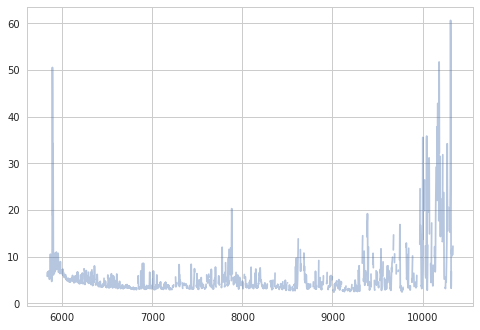

In [1706]:
x = plate5298_spec1_sky_wavelength1[35]
y = plate5298_spec1_sky_sdss_sky1[35]

plt.plot(x,y,'-',alpha=0.4)
plt.show()

##### Galaxy fibers (1272)

In [1368]:
plate5298_spec1_galaxy_wavelength, plate5298_spec1_galaxy_sdss_flux, plate5298_spec1_galaxy_sdss_sky, plate5298_spec1_galaxy_total_flux = get_field(plate5298_spec1_all_galaxy)

In [1393]:
plate5298_spec1_galaxy_wavelength.shape

(1272, 4128)

In [2160]:
1272/4

318.0

Galaxy Exposure[0]

In [1593]:
plate5298_spec1_galaxy_wavelength0, plate5298_spec1_galaxy_sdss_flux0, plate5298_spec1_galaxy_sdss_sky0, plate5298_spec1_galaxy_total_flux0 = get_field(plate5298_spec1galaxy_exposure0)

In [1594]:
plate5298_spec1_galaxy_wavelength0.shape

(318, 4128)

Galaxy Exposure[1]

In [1657]:
plate5298_spec1_galaxy_wavelength1, plate5298_spec1_galaxy_sdss_flux1, plate5298_spec1_galaxy_sdss_sky1, plate5298_spec1_galaxy_total_flux1 = get_field(plate5298_spec1galaxy_exposure1)

In [1658]:
plate5298_spec1_galaxy_wavelength1.shape

(318, 4128)

The galaxy fiber indexed 80 from exposure 1, plate 5298 is taken as an example.

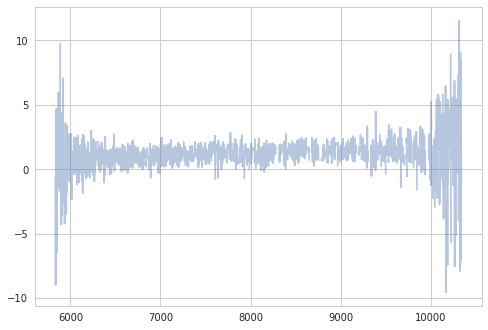

In [1678]:
x = plate5298_spec1_galaxy_wavelength1[80]
y = plate5298_spec1_galaxy_sdss_flux1[80]

plt.plot(x,y,'-',alpha=0.4)
plt.show()

##### QSO fibers (332)

In [1388]:
plate5298_spec1_QSO_wavelength, plate5298_spec1_QSO_sdss_flux, plate5298_spec1_QSO_sdss_sky, plate5298_spec1_QSO_total_flux = get_field(plate5298_spec1_all_QSO)

In [1389]:
plate5298_spec1_QSO_wavelength.shape

(332, 4128)

In [2161]:
332/4

83.0

QSO Exposure[0]

In [1601]:
plate5298_spec1_QSO_wavelength0, plate5298_spec1_QSO_sdss_flux0, plate5298_spec1_QSO_sdss_sky0, plate5298_spec1_QSO_total_flux0 = get_field(plate5298_spec1QSO_exposure0)

In [1602]:
plate5298_spec1_QSO_wavelength0.shape

(83, 4128)

QSO Exposure[1]

In [1663]:
plate5298_spec1_QSO_wavelength1, plate5298_spec1_QSO_sdss_flux1, plate5298_spec1_QSO_sdss_sky1, plate5298_spec1_QSO_total_flux1 = get_field(plate5298_spec1QSO_exposure1)

In [1664]:
plate5298_spec1_QSO_wavelength1.shape

(83, 4128)

The QSO fiber indexed 80 from exposure 1, plate5298 is taken as an example.

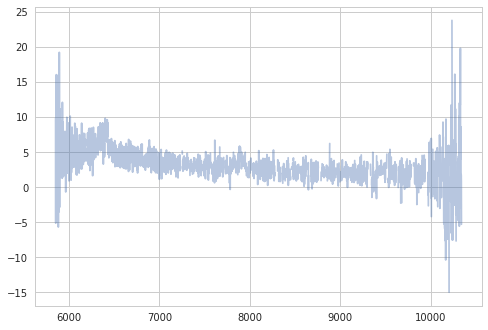

In [1677]:
x = plate5298_spec1_QSO_wavelength1[80]
y = plate5298_spec1_QSO_sdss_flux1[80]

plt.plot(x,y,'-',alpha=0.4)
plt.show()

Fstar fibers (40)

In [1391]:
plate5298_spec1_Fstar_wavelength, plate5298_spec1_Fstar_sdss_flux, plate5298_spec1_Fstar_sdss_sky, plate5298_spec1_Fstar_total_flux = get_field(plate5298_spec1_all_Fstar)

In [1394]:
plate5298_spec1_Fstar_wavelength.shape

(40, 4128)

Fstar exposure[0]

In [1605]:
plate5298_spec1_Fstar_wavelength0, plate5298_spec1_Fstar_sdss_flux0, plate5298_spec1_Fstar_sdss_sky0, plate5298_spec1_Fstar_total_flux0 = get_field(plate5298_spec1Fstar_exposure0)

In [1606]:
plate5298_spec1_Fstar_wavelength0.shape

(10, 4128)

Fstar exposure[1]

In [1635]:
plate5298_spec1_Fstar_wavelength1, plate5298_spec1_Fstar_sdss_flux1, plate5298_spec1_Fstar_sdss_sky1, plate5298_spec1_Fstar_total_flux1 = get_field(plate5298_spec1Fstar_exposure1)

In [1636]:
plate5298_spec1_Fstar_wavelength1.shape

(10, 4128)

The Fstar fiber indexed 2 from exposure 1, plate5298 is taken as an example.

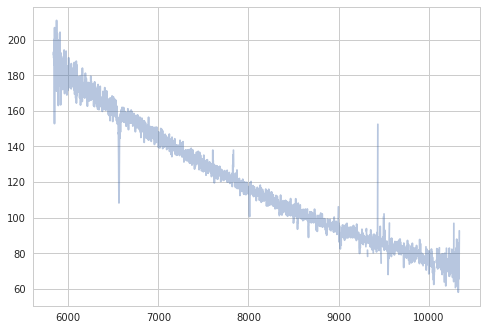

In [1645]:
x = plate5298_spec1_Fstar_wavelength1[2]
y = plate5298_spec1_Fstar_sdss_flux1[2]

plt.plot(x,y,'-',alpha=0.4)
plt.show()

Fstar exposure[3]

In [1646]:
plate5298_spec1_Fstar_wavelength3, plate5298_spec1_Fstar_sdss_flux3, plate5298_spec1_Fstar_sdss_sky3, plate5298_spec1_Fstar_total_flux3 = get_field(plate5298_spec1Fstar_exposure3)

In [1647]:
plate5298_spec1_Fstar_wavelength3.shape

(10, 4128)

### Principal Component Analysis Methods

#### Three Algorithms
- Standard PCA
- Weighted PCA
- Robust PCA

#### Two Methods
* Reconstruction of sky signals for sky fibers
* Projection of sky signals for object fibers (galaxy, QSO, Fstar)
    * Projection of sky signals for sky fibers is also taken to compare with reconstruction result.

### PCA Results Comparison on plate 5298, spectrograph I

There are 500 fibers in spectrograph I, Plate 5298 with 49 sky fibers, 93 QSO fibers, 318 Galaxy fibers, and 10 F-Star fibers.

Data from 4 exposures of this spectrograph are gathered to compute the PCA models.

Single fiber from each object type is then taken to compare the sky estimation from each PCA methods.

#### Sky Reconstruction

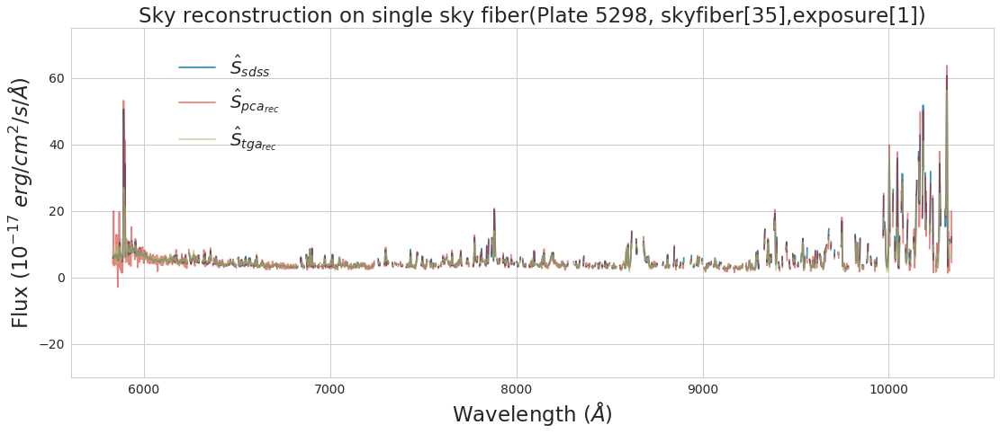

In [2184]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Sky reconstruction on single sky fiber(Plate 5298, skyfiber[35],exposure[1])',fontsize=23)
ax.set_ylim(-30, 75)

x = plate5298_spec1_sky_wavelength1[35]
sdss = plate5298_spec1_sky_sdss_sky1[35]
pca_rec = plate5298_pca_sky_196[84]
wpca_rec = plate5298_wpca_sky_196[84]
tga_rec=plate5298_tga_sky_20[84]

ax.plot(x, sdss, '-', color='b', alpha=0.8, label='$\hat{S}_{sdss}$')
ax.plot(x, pca_rec, '-', color='r', alpha=0.5, label='$\hat{S}_{pca_{rec}}$')
ax.plot(x, tga_rec, '-', color='g', alpha=0.6, label='$\hat{S}_{tga_{rec}}$')

# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

#### Sky Projection for Sky fiber

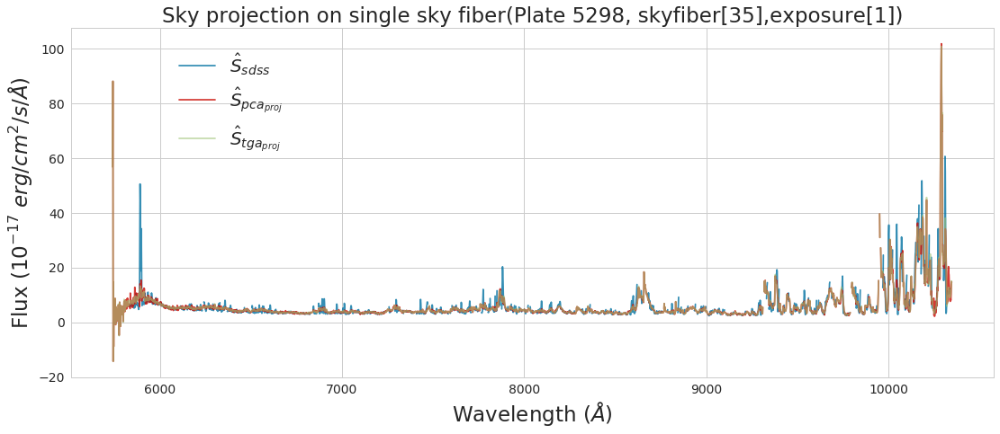

In [2103]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Sky projection on single sky fiber(Plate 5298, Fstarfiber[2],exposure[1])',fontsize=23)


x = plate5298_spec1_Fstar_wavelength1[35]
sdss = plate5298_spec1_Fstar_sdss_sky1[35]
pca_proj = plate5298_pca_proj_Fstar_196[84]
tga_proj = plate5298_tga_projected_Fstar_20[84]

ax.plot(x, sdss, '-', color='b', alpha=0.8, label='$\hat{S}_{sdss}$')
ax.plot(x, pca_proj, '-', color='r', alpha=0.8, label='$\hat{S}_{pca_{proj}}$')
ax.plot(x, tga_proj, '-', color='g', alpha=0.6, label='$\hat{S}_{tga_{proj}}$')

#ax.text(6000, 2.8, 'Difference of Sky Spectra Projection', fontsize=25)

# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

#### Sky Projection for QSO

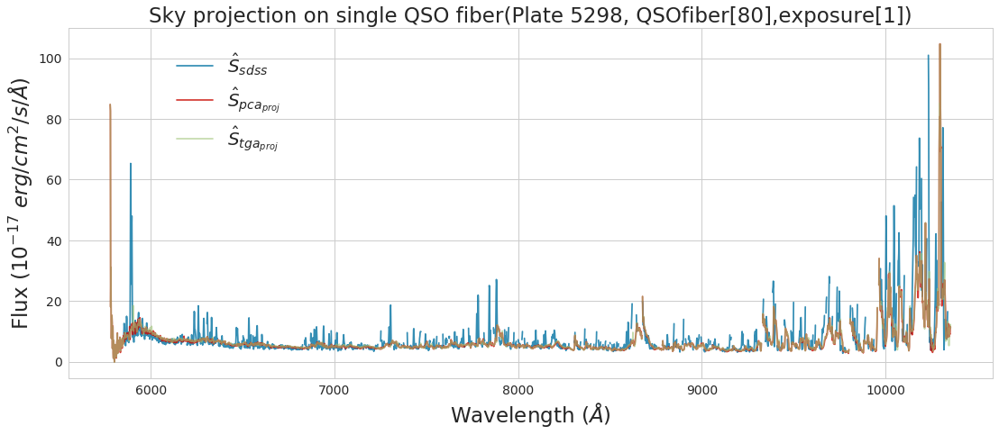

In [2155]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Sky projection on single QSO fiber(Plate 5298, QSOfiber[80],exposure[1])',fontsize=23)


x = plate5298_spec1_QSO_wavelength1[80]
sdss = plate5298_spec1_QSO_sdss_sky1[80]
pca_proj = plate5298_pca_proj_QSO_196[163]
tga_proj = plate5298_tga_projected_QSO_20[163]

ax.plot(x, sdss, '-', color='b', alpha=0.8, label='$\hat{S}_{sdss}$')
ax.plot(x, pca_proj, '-', color='r', alpha=0.8, label='$\hat{S}_{pca_{proj}}$')
ax.plot(x, tga_proj, '-', color='g', alpha=0.6, label='$\hat{S}_{tga_{proj}}$')

# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

#### Sky Projection for Fstar

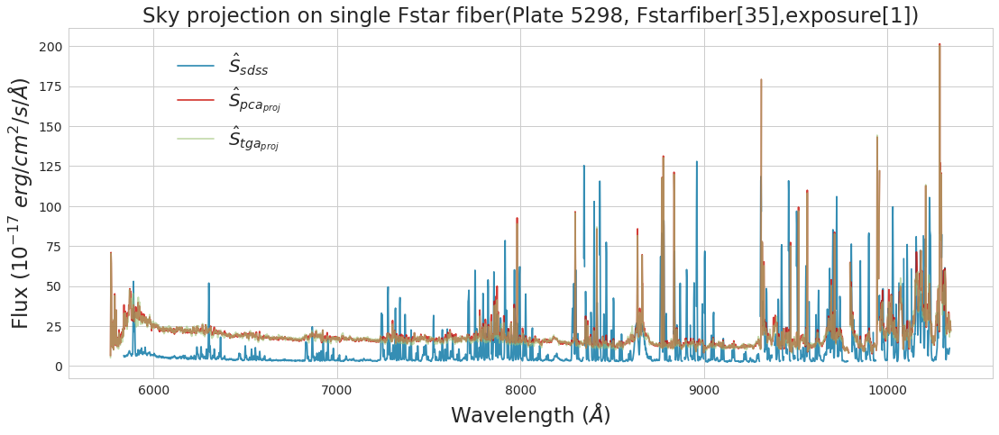

In [2154]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Sky projection on single Fstar fiber(Plate 5298, Fstarfiber[35],exposure[1])',fontsize=23)


x = plate5298_spec1_Fstar_wavelength1[2]
sdss = plate5298_spec1_Fstar_sdss_sky1[2]
pca_proj = plate5298_pca_proj_Fstar_196[12]
tga_proj = plate5298_tga_projected_Fstar_20[12]

ax.plot(x, sdss, '-', color='b', alpha=0.8, label='$\hat{S}_{sdss}$')
ax.plot(x, pca_proj, '-', color='r', alpha=0.8, label='$\hat{S}_{pca_{proj}}$')
ax.plot(x, tga_proj, '-', color='g', alpha=0.6, label='$\hat{S}_{tga_{proj}}$')

# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

#### Sky Projection for Galaxy

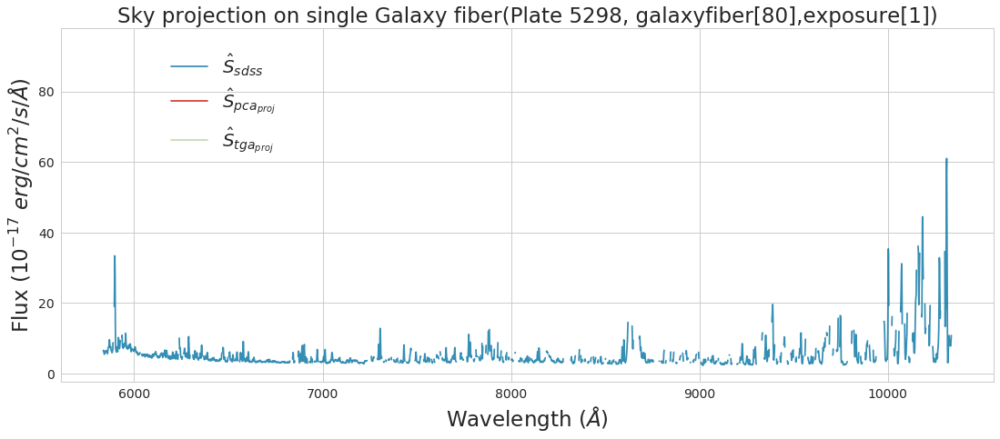

In [2149]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Sky projection on single Galaxy fiber(Plate 5298, galaxyfiber[80],exposure[1])',fontsize=23)


x = plate5298_spec1_galaxy_wavelength1[80]
sdss = plate5298_spec1_galaxy_sdss_sky1[80]
pca_proj = plate5298_pca_proj_galaxy_196[398]
tga_proj = plate5298_tga_projected_galaxy_20[398]

ax.plot(x, sdss, '-', color='b', alpha=0.8, label='$\hat{S}_{sdss}$')
ax.plot(x, pca_proj, '-', color='r', alpha=0.8, label='$\hat{S}_{pca_{proj}}$')
ax.plot(x, tga_proj, '-', color='g', alpha=0.6, label='$\hat{S}_{tga_{proj}}$')

# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

In [2185]:
plate5298_pca_proj_galaxy_196

(1272, 4128)

### Object signal estimation for QSO

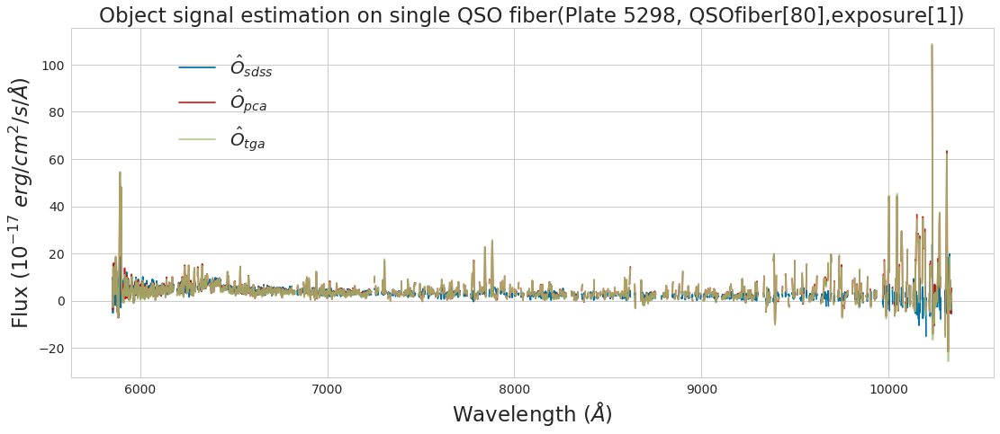

In [2157]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Object signal estimation on single QSO fiber(Plate 5298, QSOfiber[80],exposure[1])',fontsize=23)


x = plate5298_spec1_QSO_wavelength1[80]
sdss = plate5298_spec1_QSO_sdss_flux1[80]
pca= plate5298_spec1_QSO_total_flux1[80]-plate5298_pca_proj_QSO_196[163]
tga= plate5298_spec1_QSO_total_flux1[80]-plate5298_tga_projected_QSO_20[163]

ax.plot(x, sdss, '-', color='b', alpha=1, label='$\hat{O}_{sdss}$')
ax.plot(x, pca, '-', color='r', alpha=0.9, label='$\hat{O}_{pca}$')
ax.plot(x, tga, '-', color='g', alpha=0.8, label='$\hat{O}_{tga}$')
# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

#### Object Signal Estimation for Fstar

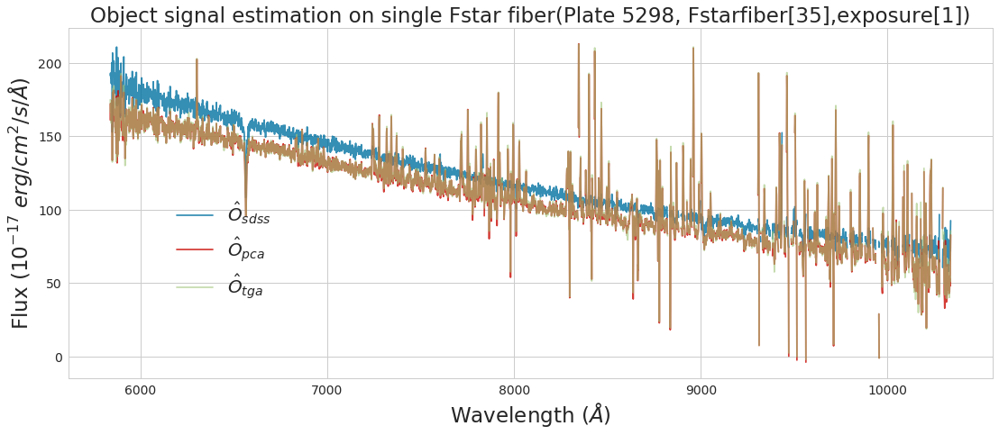

In [2151]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Object signal estimation on single Fstar fiber(Plate 5298, Fstarfiber[35],exposure[1])',fontsize=23)


x = plate5298_spec1_Fstar_wavelength1[2]
sdss = plate5298_spec1_Fstar_sdss_flux1[2]
pca_proj = plate5298_spec1_Fstar_total_flux1[2]- plate5298_pca_proj_Fstar_196[12]
tga_proj = plate5298_spec1_Fstar_total_flux1[2]- plate5298_tga_projected_Fstar_20[12]

ax.plot(x, sdss, '-', color='b', alpha=0.8, label='$\hat{O}_{sdss}$')
ax.plot(x, pca_proj, '-', color='r', alpha=0.8, label='$\hat{O}_{pca}$')
ax.plot(x, tga_proj, '-', color='g', alpha=0.6, label='$\hat{O}_{tga}$')

# Put legend on
ax.legend(loc=[0.11, 0.2], fontsize=20);

#### Object signal estimation for Galaxy

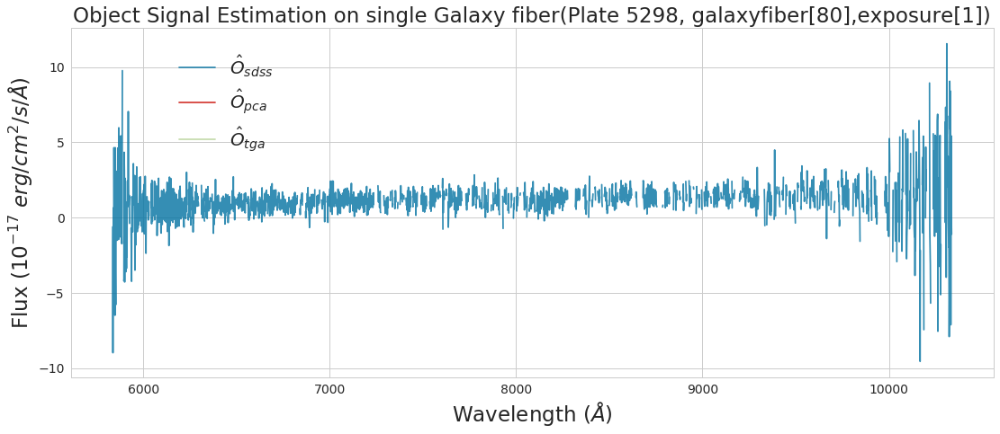

In [2187]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Object Signal Estimation on single Galaxy fiber(Plate 5298, galaxyfiber[80],exposure[1])',fontsize=23)


x = plate5298_spec1_galaxy_wavelength1[80]
sdss = plate5298_spec1_galaxy_sdss_flux1[80]
pca_proj = plate5298_spec1_galaxy_total_flux1[80]- plate5298_pca_proj_galaxy_196[398]
tga_proj = plate5298_spec1_galaxy_total_flux1[80]- plate5298_tga_projected_galaxy_20[398]

ax.plot(x, sdss, '-', color='b', alpha=0.8, label='$\hat{O}_{sdss}$')
ax.plot(x, pca_proj, '-', color='r', alpha=0.8, label='$\hat{O}_{pca}$')
ax.plot(x, tga_proj, '-', color='g', alpha=0.6, label='$\hat{O}_{tga}$')

# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

## Standard PCA

Sky signal projection

In [2082]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler

def pca_model(sky_data, object_data, ncomp):
    '''Compute the pca modeled sky signal.
    
    Parameters
    -------------
    sky_flux: Masked array of valid data from sky fibers to produce the pca model
    object_flux: Masked array of valid data from taget object fibers to project the pca result
    ncomp: number of principal components to keep
    
    Return
    --------
    
    '''
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #normalized sky signal subtracted by weighted average and weighted by noise
    
    sky_wa_normalized = sky_wa_residuals*(sky_iv**0.5)
    
    sky_wa_normalized_M = np.ma.median(sky_wa_normalized, axis=0)
    sky_wa_normalized_filled = np.ma.filled(np.ma.filled(sky_wa_normalized, fill_value=sky_wa_normalized_M),fill_value=0)
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_normalized_filled)
    
    pca_sky = decomposition.PCA(n_components = ncomp)
    pca_sky.fit(standardized_sky)
    
    eigenvectors = pca_sky.components_
    
    variance_sum = 0
    for n in range(ncomp):
        variance_sum = variance_sum + pca_sky.explained_variance_ratio_[n]
    print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    #Extract information from input object data
    object_sdss_flux = object_data['flux']
    object_sdss_sky = object_data['sky']
    object_total_flux = np.ma.array(object_sdss_flux.data+object_sdss_sky.data,
                                mask=list(map(op.and_,object_sdss_flux.mask,object_sdss_sky.mask)))

    object_iv = object_data['ivar']
    object_weights_M = np.ma.median(object_iv, axis=0)
    object_weights_filled = np.ma.filled(object_iv, fill_value=object_weights_M)
    
    #weighted average of object fibers
    object_wa= np.ma.average(object_total_flux, axis=0,weights=object_weights_filled, returned=False)
    object_wa_resized = np.tile(object_wa, (object_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    object_wa_residuals = np.ma.array(object_total_flux.data - object_wa_resized.data,
                                  mask=list(map(op.and_, object_total_flux.mask,object_wa_resized.mask)))
    
    #normalized object signal subtracted by weighted average and weighted by noise
    object_wa_normalized = object_wa_residuals*(object_iv.data**0.5)
    
    object_wa_normalized_M = np.ma.median(object_wa_normalized, axis=0)
    object_wa_normalized_filled = np.ma.filled(np.ma.filled(object_wa_normalized, fill_value=object_wa_normalized_M),fill_value=0)
    
    #Standardization of object input signal to prepare for PCA
    scaler_object = StandardScaler()
    standardized_object = scaler_object.fit_transform(object_wa_normalized_filled)
    
    #Principal coomponent amplitude of target object flux
    reduced_object = np.dot(standardized_object,eigenvectors.T)
    
    #Reverse normalization to original data dimension
    projection_object_standardized = np.dot(reduced_object,eigenvectors)
                                               
    projection= scaler_sky.inverse_transform(projection_object_standardized)
    
    #projection_sky_standardized = projection_wa_normalized*(object_iv**(-0.5)) + object_weights_filled
    
    #projection = scaler_sky.inverse_transform(projection_object_standardized)
    
    #weighted average and weights of projection result
    #projection_wa= np.tile(sky_wa, (projection.shape[0],1))
    #projection_weights = np.tile(np.ma.median(sky_weights_filled,axis=0),(projection.shape[0],1))
    
    projection_wa= np.tile(object_wa, (projection.shape[0],1))
    projection_weights = np.tile(np.ma.median(object_weights_filled,axis=0),(projection.shape[0],1))
    
    modeled_sky = projection * (projection_weights**(-0.5)) + projection_wa
    
    return modeled_sky

Sky Signal Reconstruction

In [2120]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler

def pca_sky(sky_data, ncomp):
    '''Compute the pca modeled sky information
    
    Parameters
    -------------
    sky_flux: Masked array of valid data from sky fibers to produce the pca model
    ncomp: number of principal components to keep
    
    Return
    --------
    
    '''
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #normalized sky signal subtracted by weighted average and weighted by noise
    
    sky_wa_normalized = sky_wa_residuals*(sky_iv**0.5)
    
    sky_wa_normalized_M = np.ma.median(sky_wa_normalized, axis=0)
    sky_wa_normalized_filled = np.ma.filled(np.ma.filled(sky_wa_normalized, fill_value=sky_wa_normalized_M),fill_value=0)
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_normalized_filled)
    
    pca_sky = decomposition.PCA(n_components = ncomp)
    pca_sky.fit(standardized_sky)
    
    eigenvectors = pca_sky.components_
    
    variance_sum = 0
    for n in range(ncomp):
        variance_sum = variance_sum + pca_sky.explained_variance_ratio_[n]
    print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    reduced_sky = pca_sky.fit_transform(standardized_sky)
   
    #Reconstruction of input sky information 
    projection_standardized = pca_sky.inverse_transform(reduced_sky)
    
    #Reverse standardization
    projection= scaler_sky.inverse_transform(projection_standardized)
    
    
    #Reverse normalization to original data dimension
    modeled_sky = projection * (sky_iv**(-0.5)) + sky_wa_resized
    
    return modeled_sky

## Weighted PCA

Sky signal projection

In [2229]:
from wpca import WPCA
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler

def wpca_model(sky_data, object_data, ncomp):
    '''Compute the weighted pca modeled sky signal.
    
    Parameters
    -------------
    sky_flux: Masked array of valid data from sky fibers to produce the pca model
    object_flux: Masked array of valid data from taget object fibers to project the pca result
    weights: 
    ncomp: number of principal components to keep
    
    Return
    --------
    
    '''
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_residuals)
    scaler_variance = scaler_sky.var_
    
    weights = sky_weights_filled*scaler_variance
    
    if weights is None:
        kwds = {}
    else:
        kwds = {'weights': weights}
        
    wpca_sky = WPCA(n_components = ncomp).fit(standardized_sky, **kwds)
    
    #variance_sum = 0
    #for n in range(ncomp):
    #    variance_sum = variance_sum + wpca_sky.explained_variance_ratio_[n]
    #print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    #reduced_sky = pca_sky.fit_transform(standardized_sky)
    eigenvectors = wpca_sky.components_
    
    #Extract information from input object data
    object_sdss_flux = object_data['flux']
    object_sdss_sky = object_data['sky']
    object_total_flux = np.ma.array(object_sdss_flux.data+object_sdss_sky.data,
                                mask=list(map(op.and_,object_sdss_flux.mask,object_sdss_sky.mask)))

    object_iv = object_data['ivar']
    object_weights_M = np.ma.median(object_iv, axis=0)
    object_weights_filled = np.ma.filled(object_iv, fill_value=object_weights_M)
    
    #weighted average of object fibers
    object_wa= np.ma.average(object_total_flux, axis=0,weights=object_weights_filled, returned=False)
    object_wa_resized = np.tile(object_wa, (object_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    object_wa_residuals = np.ma.array(object_total_flux.data - object_wa_resized.data,
                                  mask=list(map(op.and_, object_total_flux.mask,object_wa_resized.mask)))
    
    #normalized object signal subtracted by weighted average and weighted by noise
    object_wa_normalized = np.ma.array(object_wa_residuals*(object_iv.data**0.5),
                                      mask = list(map(op.and_, object_wa_residuals.mask,object_iv.mask)))
    
    object_wa_normalized_M = np.ma.median(object_wa_normalized, axis=0)
    object_wa_normalized_filled = np.ma.filled(object_wa_normalized, fill_value=object_wa_normalized_M)
    
    #Principal coomponent amplitude of target object flux
    amplitudes = np.dot(object_wa_normalized_filled, eigenvectors.T)
    projection_wa_normalized = np.dot(amplitudes[:],eigenvectors[:])
    
    #Reverse normalization to original data dimension
    projection_standardized = projection_wa_normalized*(object_iv**(-0.5)) + object_weights_filled
    
    projection = scaler_sky.inverse_transform(projection_standardized)
    
    #weighted average and weights of projection result
    projection_wa= np.tile(sky_wa, (projection.shape[0],1))
    
    modeled_sky = projection + projection_wa
    
    return modeled_sky

Sky Signal Reconstruction

In [2085]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler
from wpca import WPCA

def wpca_sky(sky_data,ncomp):
    '''Compute the pca modeled sky information
    
    Parameters
    -------------
    sky_flux: Masked array of valid data from sky fibers to produce the pca model
    ncomp: number of principal components to keep
    
    Return
    --------
    
    '''
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_residuals)
    standardized_weights = scaler_sky.transform(sky_weights_filled)
    
    # Weighted PCA
    wpca_sky = WPCA(n_components = ncomp).fit(standardized_sky, standardized_weights)
    
    eigenvectors = wpca_sky.components_
    
    variance_sum = 0
    for n in range(ncomp):
        variance_sum = variance_sum + wpca_sky.explained_variance_ratio_[n]
    print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    #reduced_sky = wpca_sky.fit_transform(standardized_sky, **kwds)
    
    #Reconstruction of input sky information 
    projection_standardized = WPCA(n_components = ncomp).fit_reconstruct(standardized_sky, standardized_weights)
    
    #Reverse standardization
    projection = scaler_sky.inverse_transform(projection_standardized)
    
    #Reverse normalization to original data dimension
    modeled_sky = projection + sky_wa_resized

    return modeled_sky

## Robust PCA

Sky signal projection

In [2113]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler
from tga import TGA

def tga_model(sky_data, object_data, ncomp, random_n):
    "Compute the Robust PCA model sky signal"
    
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #normalized sky signal subtracted by weighted average and weighted by noise
    
    sky_wa_normalized = sky_wa_residuals*(sky_iv**0.5)
    sky_wa_normalized_M = np.ma.median(sky_wa_normalized, axis=0)
    sky_wa_normalized_filled = np.ma.filled(np.ma.filled(sky_wa_normalized, fill_value=sky_wa_normalized_M),fill_value=0)
    
    #Standardization of sky input signal to prepare for Robust PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_normalized_filled)
    
    #Trimmed Grassmann Average as robust PCA
    tga_sky =TGA(n_components = ncomp,random_state = random_n)
    tga_sky.fit(standardized_sky)
    
    eigenvectors = tga_sky.components_
    
    #Extract information from input object data
    object_sdss_flux = object_data['flux']
    object_sdss_sky = object_data['sky']
    object_total_flux = np.ma.array(object_sdss_flux.data+object_sdss_sky.data,
                                mask=list(map(op.and_,object_sdss_flux.mask,object_sdss_sky.mask)))

    object_iv = object_data['ivar']
    object_weights_M = np.ma.median(object_iv, axis=0)
    object_weights_filled = np.ma.filled(object_iv, fill_value=object_weights_M)
    
    #weighted average of object fibers
    object_wa= np.ma.average(object_total_flux, axis=0,weights=object_weights_filled, returned=False)
    object_wa_resized = np.tile(object_wa, (object_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    object_wa_residuals = np.ma.array(object_total_flux.data - object_wa_resized.data,
                                  mask=list(map(op.and_, object_total_flux.mask,object_wa_resized.mask)))
    
    #normalized object signal subtracted by weighted average and weighted by noise
    object_wa_normalized = object_wa_residuals*(object_iv.data**0.5)
    object_wa_normalized_M = np.ma.median(object_wa_normalized, axis=0)
    object_wa_normalized_filled = np.ma.filled(np.ma.filled(object_wa_normalized, fill_value=object_wa_normalized_M),fill_value=0)
    
    #Standardization of object input signal to prepare for PCA
    scaler_object = StandardScaler()
    standardized_object = scaler_object.fit_transform(object_wa_normalized_filled)
    
    #Principal coomponent amplitude of target object flux
    reduced_object = np.dot(standardized_object, eigenvectors.T)
    
    #Reverse normalization to original data dimension
    projection_object_standardized = np.dot(reduced_object,eigenvectors)
                                               
    projection= scaler_sky.inverse_transform(projection_object_standardized)
    
    #projection_sky_standardized = projection_wa_normalized*(object_iv**(-0.5)) + object_weights_filled
    
    #projection = scaler_sky.inverse_transform(projection_object_standardized)
    
    #weighted average and weights of projection result
    #projection_wa= np.tile(sky_wa, (projection.shape[0],1))
    #projection_weights = np.tile(np.ma.median(sky_weights_filled,axis=0),(projection.shape[0],1))
    
    projection_wa= np.tile(object_wa, (projection.shape[0],1))
    projection_weights = np.tile(np.ma.median(object_weights_filled,axis=0),(projection.shape[0],1))
    
    modeled_sky = projection * (projection_weights**(-0.5)) + projection_wa
    
    return modeled_sky

Sky signal reconstruction

In [2086]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler
from tga import TGA

def tga_sky(sky_data, ncomp, random_n):
    "Compute the Robust PCA model sky signal"
    
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #normalized sky signal subtracted by weighted average and weighted by noise
    
    sky_wa_normalized = sky_wa_residuals*(sky_iv**0.5)
    
    sky_wa_normalized_M = np.ma.median(sky_wa_normalized, axis=0)
    sky_wa_normalized_filled = np.ma.filled(np.ma.filled(sky_wa_normalized, fill_value=sky_wa_normalized_M),fill_value=0)
    
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_normalized_filled)
    
    tga_sky = TGA(n_components = ncomp,random_state = random_n)
    tga_sky.fit(standardized_sky)
    
    #variance_sum = 0
    #for n in range(ncomp):
    #    variance_sum = variance_sum + pca_sky.explained_variance_ratio_[n]
    #print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    reduced_sky = tga_sky.fit_transform(standardized_sky)
   
    #Reconstruction of input sky information 
    projection_standardized = tga_sky.inverse_transform(reduced_sky)
    
    #Reverse standardization
    projection= scaler_sky.inverse_transform(projection_standardized)
    #Reverse normalization to original data dimension
    modeled_sky = projection * (sky_iv**(-0.5)) + sky_wa_resized
    
    return modeled_sky

----
## Below are data and results for other plates, please disregard them at this point

In [2165]:
plate5298_pca_sky_196 = pca_sky(plate5298_spec1_all_sky,ncomp=196)

196 components explain 100.00000080326683 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


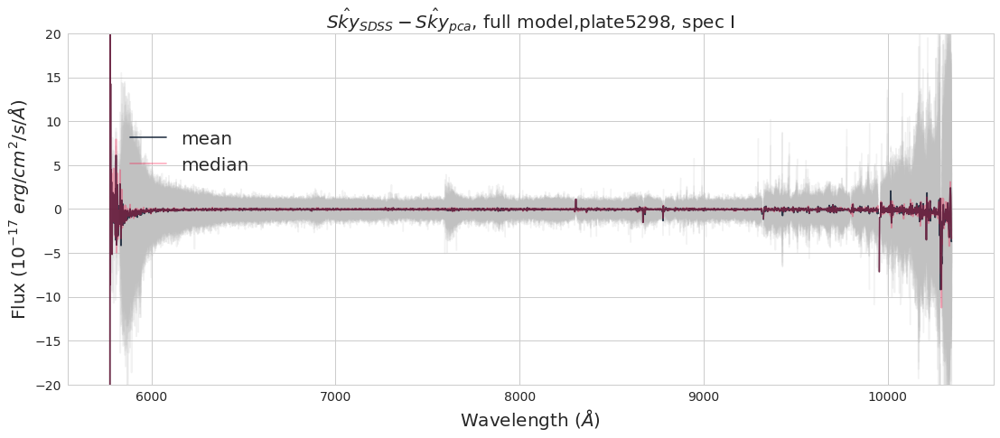

In [2169]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-20,20)

#Standard PCA result compared to total flux
plate5298_pca_sky_196_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_pca_sky_196

for flux in plate5298_pca_sky_196_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_sky_196_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_sky_196_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("$\hat{Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

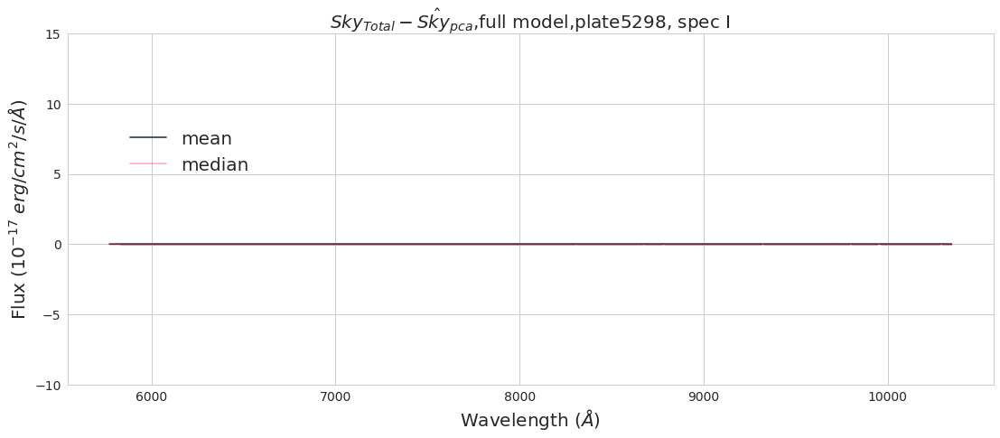

In [2183]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-10,15)
#Standard PCA result compared to total flux
plate5298_pca_sky_196_Totalres = plate5298_spec1_sky_total_flux - plate5298_pca_sky_196

for flux in plate5298_pca_sky_196_Totalres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_sky_196_Totalres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_sky_196_Totalres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$,full model,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

In [2162]:
plate5298_pca_sky_126 = pca_sky(plate5298_spec1_all_sky,ncomp=126)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


126 components explain 90.06376876495779 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


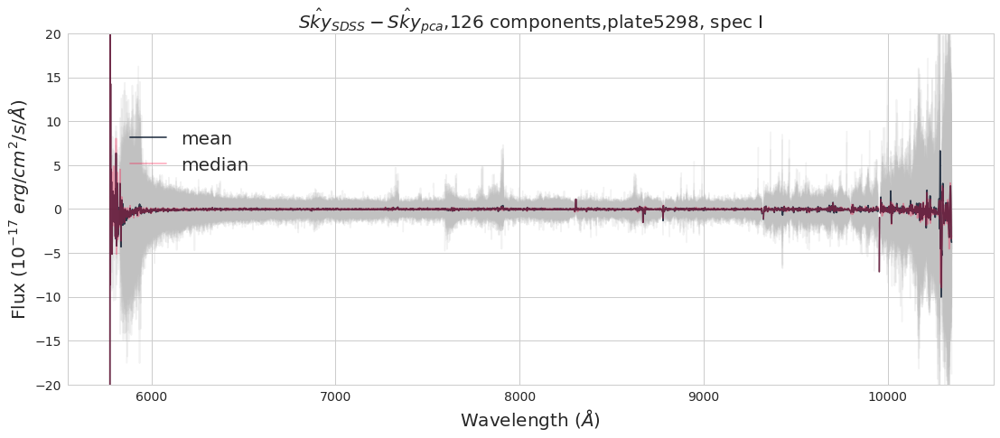

In [2170]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-20,20)

#Standard PCA result compared to total flux
plate5298_pca_sky_126_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_pca_sky_126

for flux in plate5298_pca_sky_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_sky_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_sky_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("$\hat{Sky}_{SDSS} - \hat{Sky}_{pca}$,126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

PCA Sky projection

In [2189]:
plate5298_pca_proj_sky_196 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_sky,ncomp=196)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


196 components explain 100.00000080326683 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2722 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


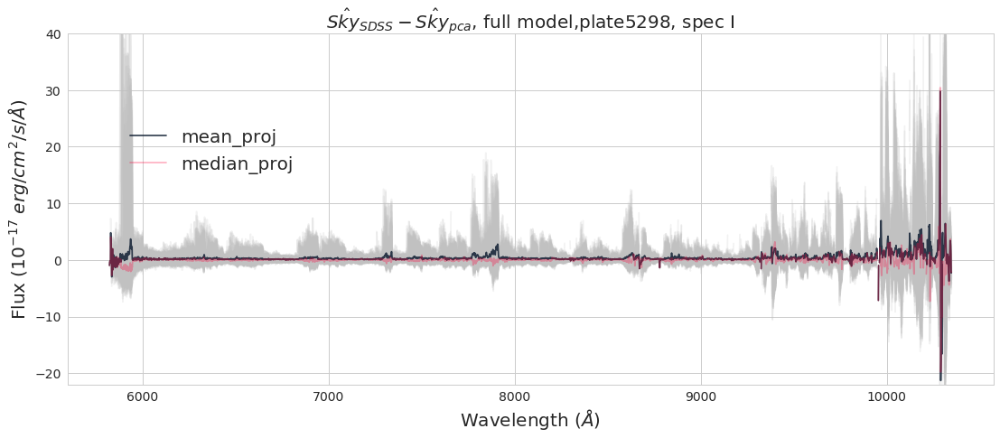

In [2193]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-22,40)

#Standard PCA result compared to total flux
plate5298_pca_proj_sky_196_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_pca_proj_sky_196

for flux in plate5298_pca_proj_sky_196_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_proj_sky_196_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_proj_sky_196_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


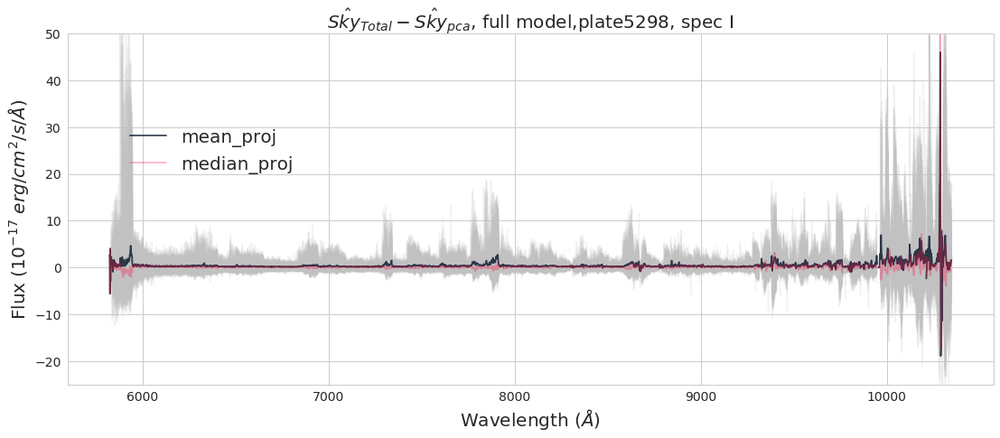

In [2200]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-25,50)

#Standard PCA result compared to total flux
plate5298_pca_proj_sky_196_Totalres = plate5298_spec1_sky_total_flux - plate5298_pca_proj_sky_196

for flux in plate5298_pca_proj_sky_196_Totalres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_proj_sky_196_Totalres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_proj_sky_196_Totalres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

In [2194]:
plate5298_pca_proj_sky_126 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_sky,ncomp=126)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


126 components explain 90.04185135709122 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2722 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


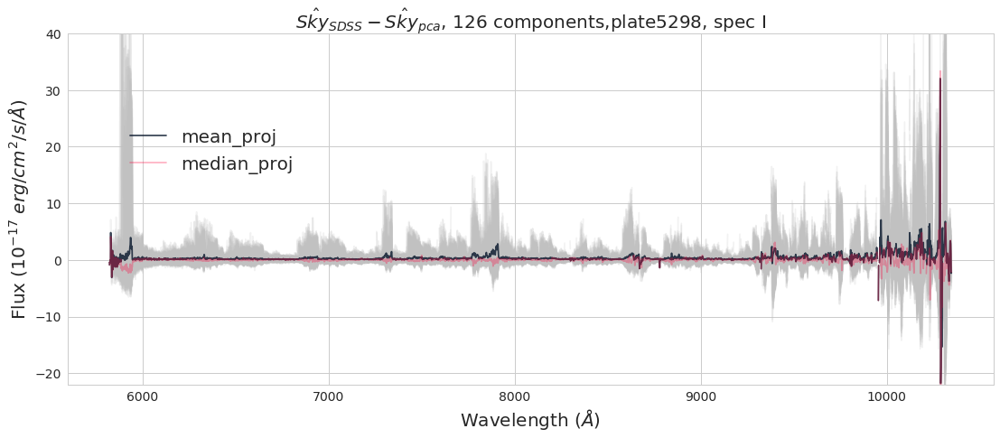

In [2195]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-22,40)

#Standard PCA result compared to total flux
plate5298_pca_proj_sky_126_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_pca_proj_sky_126

for flux in plate5298_pca_proj_sky_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_proj_sky_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_proj_sky_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{Sky}_{SDSS} - \hat{Sky}_{pca}$, 126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


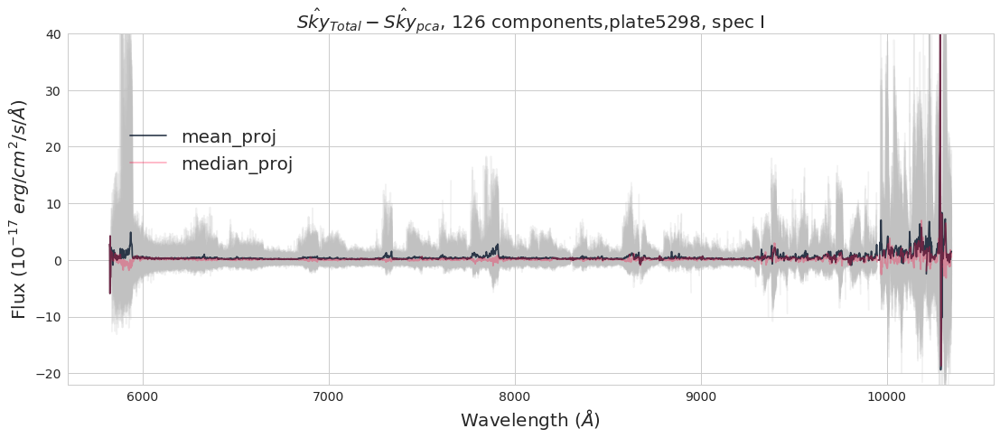

In [2201]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-22,40)

#Standard PCA result compared to total flux
plate5298_pca_proj_sky_126_Totalres = plate5298_spec1_sky_total_flux - plate5298_pca_proj_sky_126

for flux in plate5298_pca_proj_sky_126_Totalres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_proj_sky_126_Totalres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_proj_sky_126_Totalres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{Sky}_{Total} - \hat{Sky}_{pca}$, 126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

In [2202]:
plate5298_pca_proj_QSO_126 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,ncomp=126)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


126 components explain 90.05076743196696 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


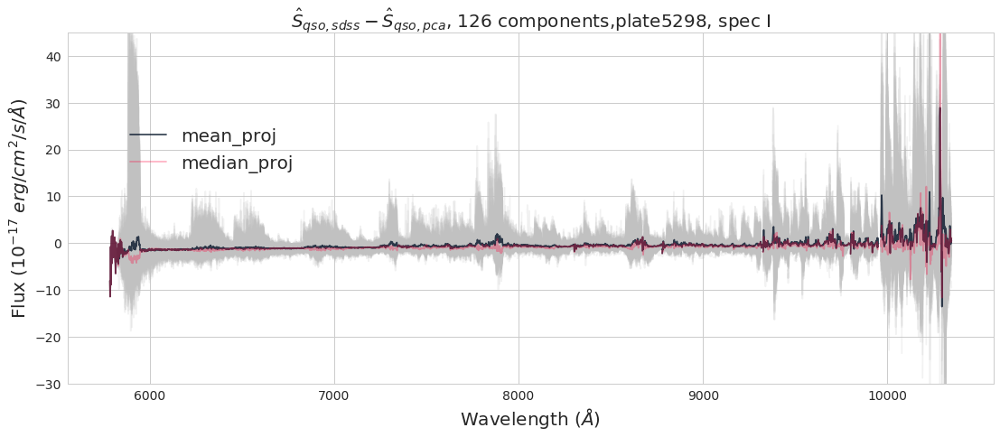

In [2208]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-30,45)

#Standard PCA result compared to total flux
plate5298_pca_proj_QSO_126_SDSSres = plate5298_spec1_QSO_sdss_sky - plate5298_pca_proj_QSO_126

for flux in plate5298_pca_proj_QSO_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmean(plate5298_pca_proj_QSO_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmedian(plate5298_pca_proj_QSO_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{S}_{qso,sdss} - \hat{S}_{qso,pca}$, 126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

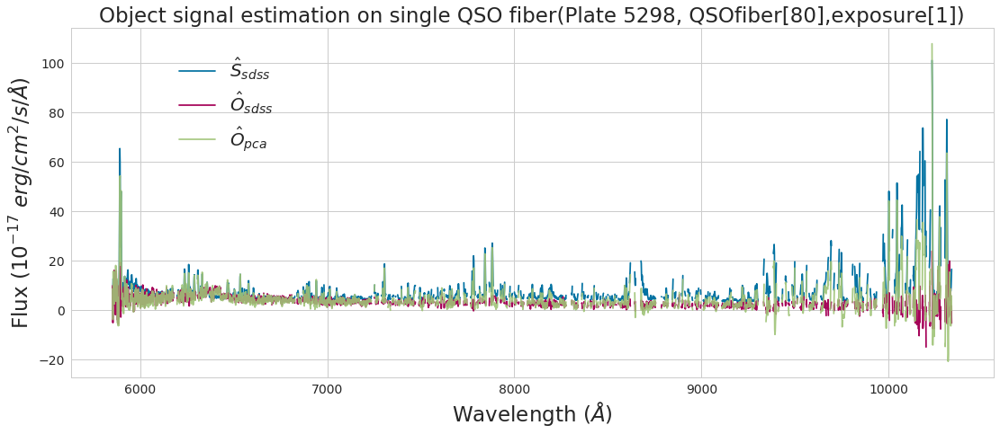

In [2212]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Object signal estimation on single QSO fiber(Plate 5298, QSOfiber[80],exposure[1])',fontsize=23)


x = plate5298_spec1_QSO_wavelength1[80]
sdss = plate5298_spec1_QSO_sdss_flux1[80]
pca= plate5298_spec1_QSO_total_flux1[80]- plate5298_pca_proj_QSO_126[163]
sky = plate5298_spec1_QSO_sdss_sky1[80]
#tga= plate5298_spec1_QSO_total_flux1[80]-plate5298_tga_projected_QSO_20[163]

ax.plot(x, sky,'-',color='b',alpha=1, label='$\hat{S}_{sdss}$')
ax.plot(x, sdss, '-', color='m', alpha=1, label='$\hat{O}_{sdss}$')
ax.plot(x, pca, '-', color='g', alpha=0.9, label='$\hat{O}_{pca}$')
#ax.plot(x, tga, '-', color='g', alpha=0.8, label='$\hat{O}_{tga}$')
# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

In [2213]:
plate5298_pca_proj_Fstar_126 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_Fstar,ncomp=126)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


126 components explain 90.05818476434797 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 769 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


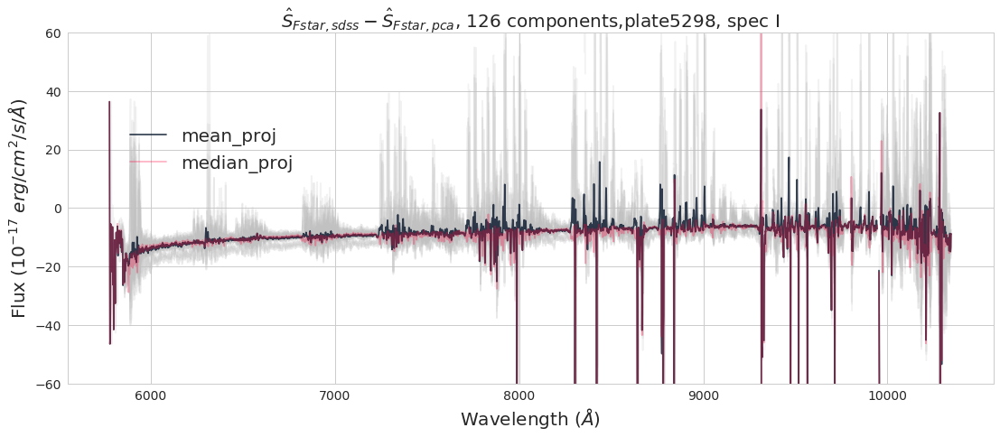

In [2216]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-60,60)

#Standard PCA result compared to total flux
plate5298_pca_proj_Fstar_126_SDSSres = plate5298_spec1_Fstar_sdss_sky - plate5298_pca_proj_Fstar_126

for flux in plate5298_pca_proj_Fstar_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_Fstar_wavelength[0,:],np.nanmean(plate5298_pca_proj_Fstar_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_Fstar_wavelength[0,:],np.nanmedian(plate5298_pca_proj_Fstar_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{S}_{Fstar,sdss} - \hat{S}_{Fstar,pca}$, 126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

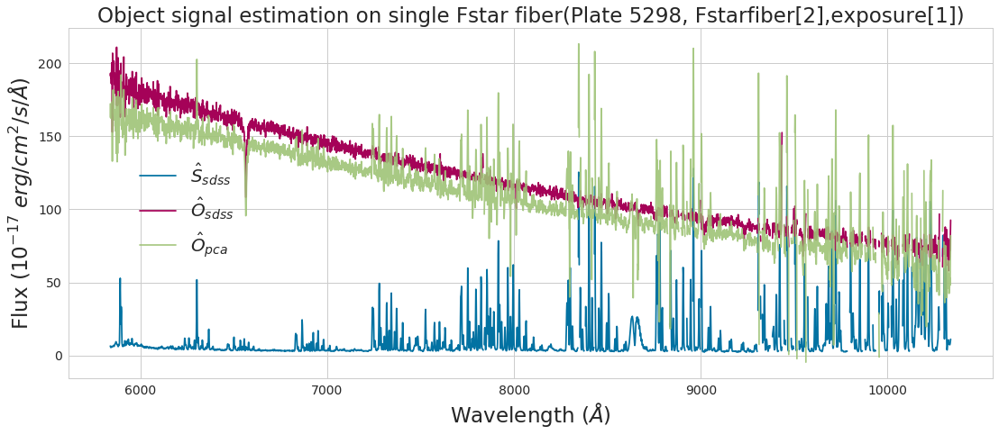

In [2221]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Object signal estimation on single Fstar fiber(Plate 5298, Fstarfiber[2],exposure[1])',fontsize=23)


x = plate5298_spec1_Fstar_wavelength1[2]
sdss = plate5298_spec1_Fstar_sdss_flux1[2]
pca= plate5298_spec1_Fstar_total_flux1[2]- plate5298_pca_proj_Fstar_126[12]
sky = plate5298_spec1_Fstar_sdss_sky1[2]
#tga= plate5298_spec1_QSO_total_flux1[80]-plate5298_tga_projected_QSO_20[163]

ax.plot(x, sky,'-',color='b',alpha=1, label='$\hat{S}_{sdss}$')
ax.plot(x, sdss, '-', color='m', alpha=1, label='$\hat{O}_{sdss}$')
ax.plot(x, pca, '-', color='g', alpha=0.9, label='$\hat{O}_{pca}$')
#ax.plot(x, tga, '-', color='g', alpha=0.8, label='$\hat{O}_{tga}$')
# Put legend on
ax.legend(loc=[0.07, 0.32], fontsize=20);

In [2222]:
plate5298_pca_proj_galaxy_126 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_galaxy,ncomp=126)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


126 components explain 90.03019264200702 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 3188 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


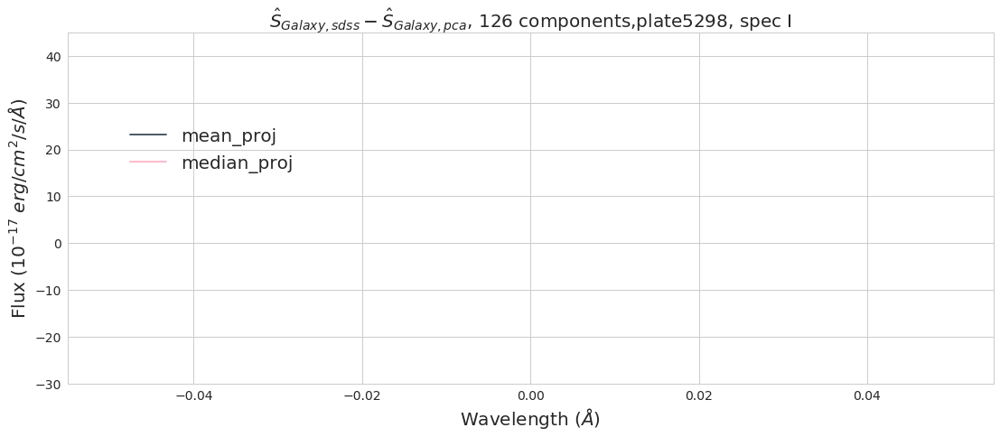

In [2224]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-30,45)

#Standard PCA result compared to total flux
plate5298_pca_proj_galaxy_126_SDSSres = plate5298_spec1_galaxy_sdss_sky - plate5298_pca_proj_galaxy_126

for flux in plate5298_pca_proj_galaxy_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_galaxy_wavelength[0,:],np.nanmean(plate5298_pca_proj_galaxy_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_galaxy_wavelength[0,:],np.nanmedian(plate5298_pca_proj_galaxy_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{S}_{Galaxy,sdss} - \hat{S}_{Galaxy,pca}$, 126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

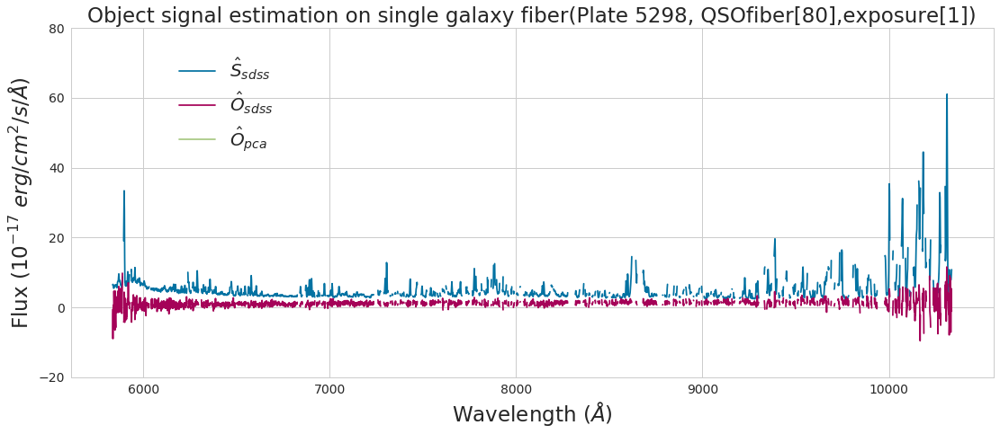

In [2226]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Object signal estimation on single galaxy fiber(Plate 5298, QSOfiber[80],exposure[1])',fontsize=23)
ax.set_ylim(-20,80)

x = plate5298_spec1_galaxy_wavelength1[80]
sdss = plate5298_spec1_galaxy_sdss_flux1[80]
pca= plate5298_spec1_galaxy_total_flux1[80]- plate5298_pca_proj_galaxy_126[398]
sky = plate5298_spec1_galaxy_sdss_sky1[80]
#tga= plate5298_spec1_QSO_total_flux1[80]-plate5298_tga_projected_QSO_20[163]

ax.plot(x, sky,'-',color='b',alpha=1, label='$\hat{S}_{sdss}$')
ax.plot(x, sdss, '-', color='m', alpha=1, label='$\hat{O}_{sdss}$')
ax.plot(x, pca, '-', color='g', alpha=0.9, label='$\hat{O}_{pca}$')
#ax.plot(x, tga, '-', color='g', alpha=0.8, label='$\hat{O}_{tga}$')
# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

WPCA

In [2230]:
plate5298_wpca_proj_sky_126 = wpca_model(plate5298_spec1_all_sky,plate5298_spec1_all_sky,126)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2722 results
  r = func(a, **kwargs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


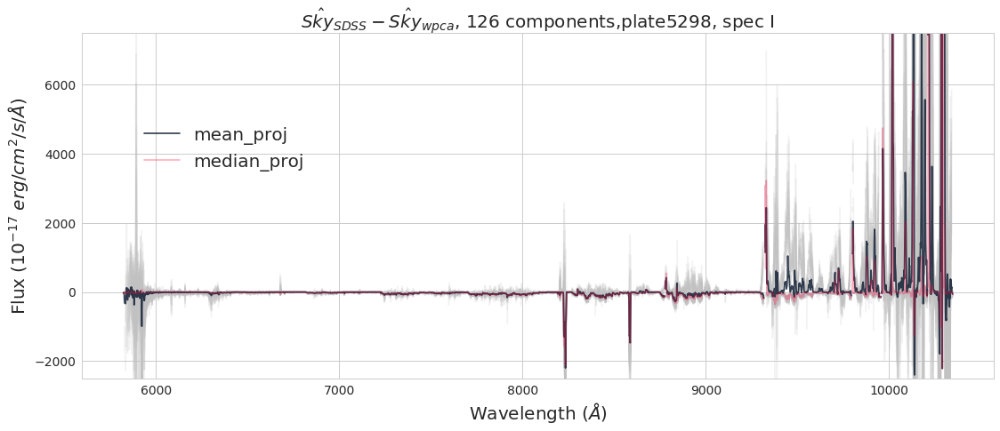

In [2235]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_wpca_proj_sky_126_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_wpca_proj_sky_126

for flux in plate5298_wpca_proj_sky_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_wpca_proj_sky_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_wpca_proj_sky_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{Sky}_{SDSS} - \hat{Sky}_{wpca}$, 126 components,plate5298, spec I",fontsize=20)
ax.set_ylim(-2500,7500)
ax.legend(loc=[0.06,0.58],fontsize=20);

In [2237]:
plate5298_wpca_proj_QSO_126 = wpca_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,126)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


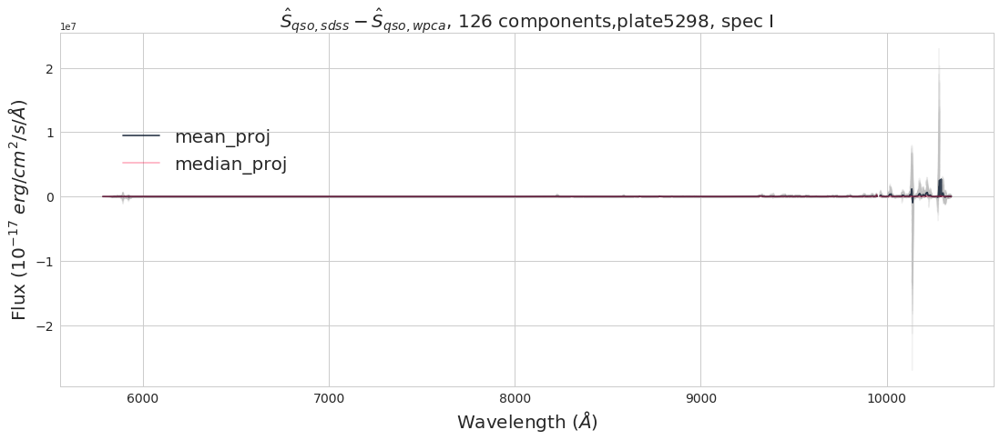

In [2240]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_wpca_proj_QSO_126_SDSSres = plate5298_spec1_QSO_sdss_sky - plate5298_wpca_proj_QSO_126

for flux in plate5298_wpca_proj_QSO_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmean(plate5298_wpca_proj_QSO_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmedian(plate5298_wpca_proj_QSO_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{S}_{qso,sdss} - \hat{S}_{qso,wpca}$, 126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

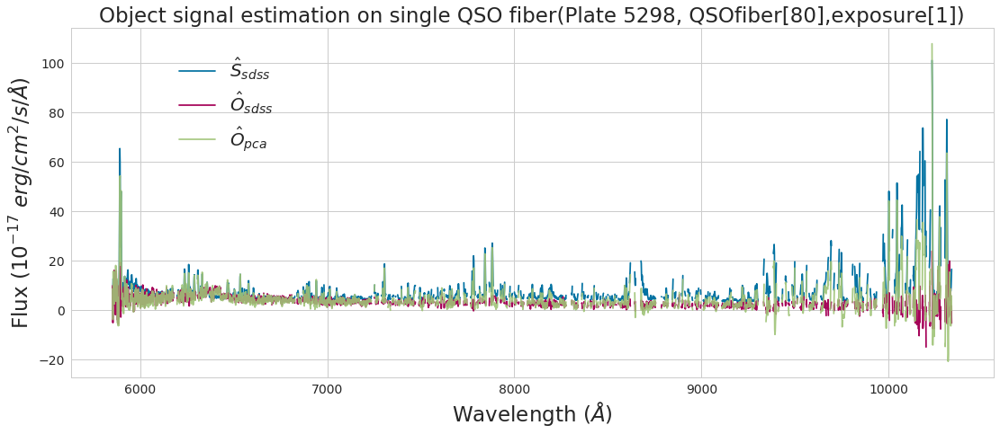

In [2212]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Object signal estimation on single QSO fiber(Plate 5298, QSOfiber[80],exposure[1])',fontsize=23)


x = plate5298_spec1_QSO_wavelength1[80]
sdss = plate5298_spec1_QSO_sdss_flux1[80]
pca= plate5298_spec1_QSO_total_flux1[80]- plate5298_pca_proj_QSO_126[163]
sky = plate5298_spec1_QSO_sdss_sky1[80]
#tga= plate5298_spec1_QSO_total_flux1[80]-plate5298_tga_projected_QSO_20[163]

ax.plot(x, sky,'-',color='b',alpha=1, label='$\hat{S}_{sdss}$')
ax.plot(x, sdss, '-', color='m', alpha=1, label='$\hat{O}_{sdss}$')
ax.plot(x, pca, '-', color='g', alpha=0.9, label='$\hat{O}_{pca}$')
#ax.plot(x, tga, '-', color='g', alpha=0.8, label='$\hat{O}_{tga}$')
# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

In [ ]:
plate5298_tga_projected_sky_20

### Robust PCA

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


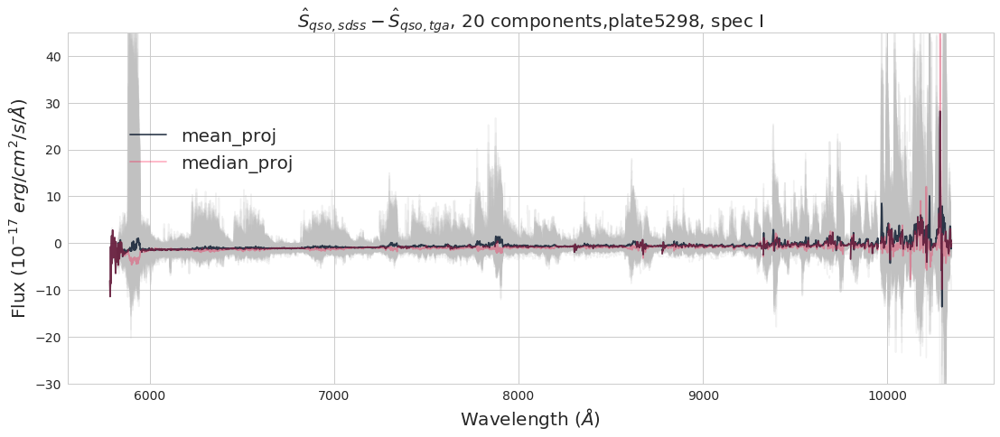

In [2258]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-30,45)

#Standard TGA result compared to total flux
plate5298_tga_proj_QSO_20_SDSSres = plate5298_spec1_QSO_sdss_sky - plate5298_tga_projected_QSO_20

for flux in plate5298_tga_proj_QSO_20_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmean(plate5298_tga_proj_QSO_20_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmedian(plate5298_tga_proj_QSO_20_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{S}_{qso,sdss} - \hat{S}_{qso,tga}$, 20 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


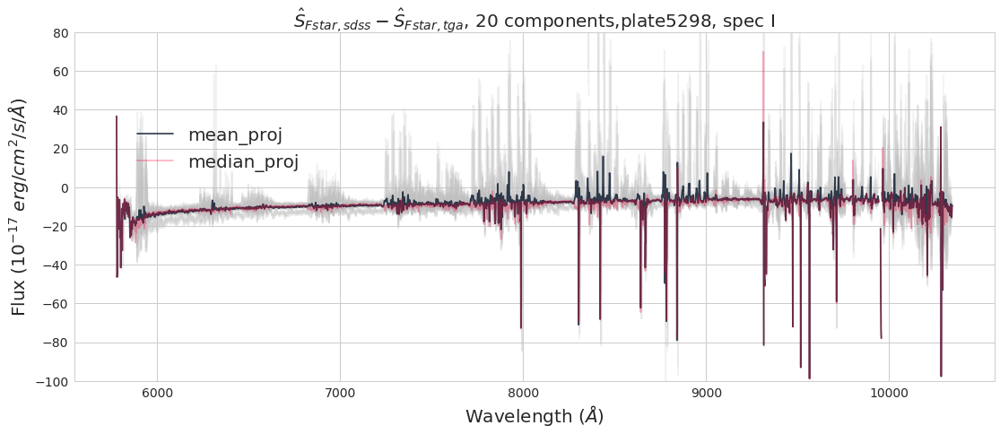

In [2264]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
ax.set_ylim(-100,80)

#Standard TGA result compared to total flux
plate5298_tga_proj_Fstar_126_SDSSres = plate5298_spec1_Fstar_sdss_sky - plate5298_tga_projected_Fstar_20

for flux in plate5298_tga_proj_Fstar_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_Fstar_wavelength[0,:],np.nanmean(plate5298_tga_proj_Fstar_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_Fstar_wavelength[0,:],np.nanmedian(plate5298_tga_proj_Fstar_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{S}_{Fstar,sdss} - \hat{S}_{Fstar,tga}$, 20 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

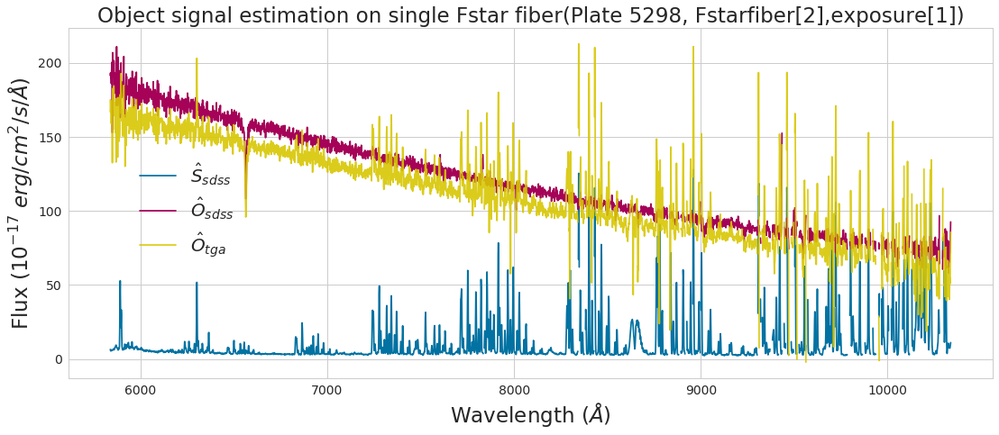

In [2268]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Object signal estimation on single Fstar fiber(Plate 5298, Fstarfiber[2],exposure[1])',fontsize=23)


x = plate5298_spec1_Fstar_wavelength1[2]
sdss = plate5298_spec1_Fstar_sdss_flux1[2]
tga= plate5298_spec1_Fstar_total_flux1[2]- plate5298_tga_projected_Fstar_20[12]
sky = plate5298_spec1_Fstar_sdss_sky1[2]

ax.plot(x, sky,'-',color='b',alpha=1, label='$\hat{S}_{sdss}$')
ax.plot(x, sdss, '-', color='m', alpha=1, label='$\hat{O}_{sdss}$')
ax.plot(x, tga, '-', color='y', alpha=0.9, label='$\hat{O}_{tga}$')
# Put legend on
ax.legend(loc=[0.07, 0.32], fontsize=20);

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


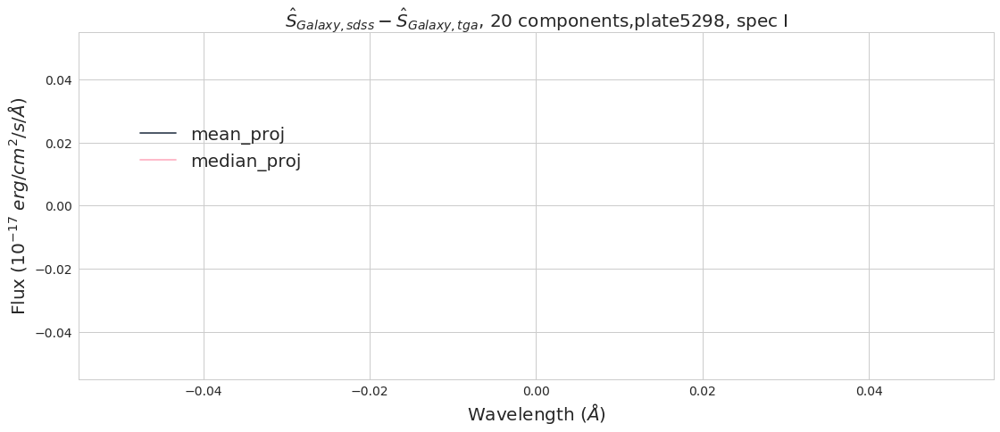

In [2266]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)
#ax.set_ylim(-30,45)

#Standard TGA result compared to total flux
plate5298_tga_proj_galaxy_126_SDSSres = plate5298_spec1_galaxy_sdss_sky - plate5298_tga_projected_galaxy_20

for flux in plate5298_tga_proj_galaxy_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_galaxy_wavelength[0,:],np.nanmean(plate5298_tga_proj_galaxy_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean_proj');
ax.plot(plate5298_spec1_galaxy_wavelength[0,:],np.nanmedian(plate5298_tga_proj_galaxy_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median_proj');
ax.set_title("$\hat{S}_{Galaxy,sdss} - \hat{S}_{Galaxy,tga}$, 20 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

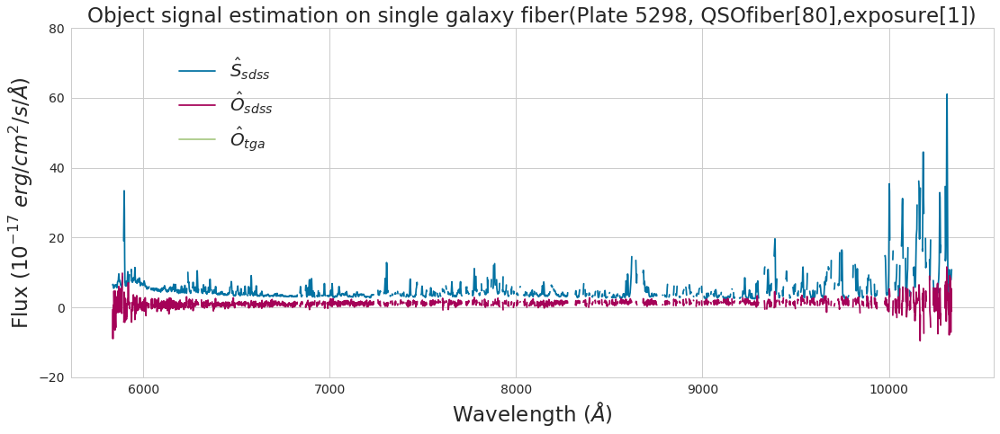

In [2267]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Object signal estimation on single galaxy fiber(Plate 5298, QSOfiber[80],exposure[1])',fontsize=23)
ax.set_ylim(-20,80)

x = plate5298_spec1_galaxy_wavelength1[80]
sdss = plate5298_spec1_galaxy_sdss_flux1[80]
tga= plate5298_spec1_galaxy_total_flux1[80]- plate5298_tga_projected_galaxy_20[398]
sky = plate5298_spec1_galaxy_sdss_sky1[80]
#tga= plate5298_spec1_QSO_total_flux1[80]-plate5298_tga_projected_QSO_20[163]

ax.plot(x, sky,'-',color='b',alpha=1, label='$\hat{S}_{sdss}$')
ax.plot(x, sdss, '-', color='m', alpha=1, label='$\hat{O}_{sdss}$')
ax.plot(x, tga, '-', color='g', alpha=0.9, label='$\hat{O}_{tga}$')
# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20);

---
##### Plate 4042

In [756]:
plate4042_sky, plate4042_galaxy, plate4042_QSO, plate4042_Fstar = classify_fiber(4042, 55626)

Plate 4042 contains 97 sky fibers, 660 galaxy fibers 196 QSO fiber 20 F type star fibers


In [91]:
plate4042_fibers1 = np.arange(1,501,1)

In [94]:
plate4042_fibers2 = np.arange(501,1001,1)

In [93]:
plate4042_fibers = np.arange(1,1001,1)

In [764]:
plate4042_sky_fibers1 = spec1_fiber(plate4042_sky)

Spectrograph 1 contains 47 fibers


In [765]:
plate4042_galaxy_fibers1 = spec1_fiber(plate4042_galaxy)

Spectrograph 1 contains 335 fibers


In [766]:
plate4042_QSO_fibers1 = spec1_fiber(plate4042_QSO)

Spectrograph 1 contains 99 fibers


In [808]:
plate4042_Fstar_fibers1 = spec1_fiber(plate4042_Fstar)

Spectrograph 1 contains 9 fibers


#### All exposures in Plate 4042
All exposure data for all fibers in plate 4042, spectrograph I.

In [95]:
plate4042_spec1_exposure0= get_valid_data(plate_number=4042, mjd=55626, exposure=0, fiber_number= plate4042_fibers1[0], index=1, fibers= plate4042_fibers1,combined = True)

In [97]:
plate4042_spec1_exposure1= get_valid_data(plate_number=4042, mjd=55626, exposure=1, fiber_number= plate4042_fibers1[0], index=1, fibers= plate4042_fibers1,combined = True)

In [98]:
plate4042_spec1_exposure4= get_valid_data(plate_number=4042, mjd=55626, exposure=4, fiber_number= plate4042_fibers1[0], index=1, fibers= plate4042_fibers1,combined = True)

In [99]:
plate4042_spec1_exposure5= get_valid_data(plate_number=4042, mjd=55626, exposure=5, fiber_number= plate4042_fibers1[0], index=1, fibers= plate4042_fibers1,combined = True)

In [100]:
plate4042_spec1_exposure6= get_valid_data(plate_number=4042, mjd=55626, exposure=6, fiber_number= plate4042_fibers1[0], index=1, fibers= plate4042_fibers1,combined = True)

Stack all exposure data of all fibers in spectrograph I, plate 4042.

In [101]:
plate4042_spec1_all= np.ma.vstack((plate4042_spec1_exposure0, plate4042_spec1_exposure1, plate4042_spec1_exposure4, plate4042_spec1_exposure5, plate4042_spec1_exposure6))

In [102]:
plate4042_spec1_all.shape

(2500, 4128)

Exposure data of 5 exposures, indexed 0,1,4,5,6 are available, giving a dimension of 2500 rows ($500*5$ fibers) since there are 500 fibers in total in spectrograph I.

All exposure data for sky fibers in plate 4042, spectrograph I.

In [84]:
plate4042_spec1sky_exposure0= get_valid_data(plate_number=4042, mjd=55626, exposure=0, fiber_number= plate4042_sky_fibers1[0], index=1, fibers=plate4042_sky_fibers1,combined = True)

In [85]:
plate4042_spec1sky_exposure1= get_valid_data(plate_number=4042, mjd=55626, exposure=1, fiber_number= plate4042_sky_fibers1[0], index=1, fibers=plate4042_sky_fibers1,combined = True)

In [86]:
plate4042_spec1sky_exposure4= get_valid_data(plate_number=4042, mjd=55626, exposure=4, fiber_number= plate4042_sky_fibers1[0], index=1, fibers=plate4042_sky_fibers1,combined = True)

In [87]:
plate4042_spec1sky_exposure5= get_valid_data(plate_number=4042, mjd=55626, exposure=5, fiber_number= plate4042_sky_fibers1[0], index=1, fibers=plate4042_sky_fibers1,combined = True)

In [88]:
plate4042_spec1sky_exposure6= get_valid_data(plate_number=4042, mjd=55626, exposure=6, fiber_number= plate4042_sky_fibers1[0], index=1, fibers=plate4042_sky_fibers1,combined = True)

Stack all exposure data of sky fibers in spectrograph I, plate 4042.

In [89]:
plate4042_spec1_all_sky = np.ma.vstack((plate4042_spec1sky_exposure0, plate4042_spec1sky_exposure1, plate4042_spec1sky_exposure4, plate4042_spec1sky_exposure5, plate4042_spec1sky_exposure6))

In [103]:
plate4042_spec1_all_sky.shape

(235, 4128)

All exposure data for galaxy fibers in plate 4042, spectrograph I.

In [107]:
plate4042_spec1galaxy_exposure0= get_valid_data(plate_number=4042, mjd=55626, exposure=0, fiber_number= plate4042_galaxy_fibers1[0], index=1, fibers=plate4042_galaxy_fibers1,combined = True)

In [108]:
plate4042_spec1galaxy_exposure1= get_valid_data(plate_number=4042, mjd=55626, exposure=1, fiber_number= plate4042_galaxy_fibers1[0], index=1, fibers=plate4042_galaxy_fibers1,combined = True)

In [109]:
plate4042_spec1galaxy_exposure4= get_valid_data(plate_number=4042, mjd=55626, exposure=4, fiber_number= plate4042_galaxy_fibers1[0], index=1, fibers=plate4042_galaxy_fibers1,combined = True)

In [110]:
plate4042_spec1galaxy_exposure5= get_valid_data(plate_number=4042, mjd=55626, exposure=5, fiber_number= plate4042_galaxy_fibers1[0], index=1, fibers=plate4042_galaxy_fibers1,combined = True)

In [111]:
plate4042_spec1galaxy_exposure6= get_valid_data(plate_number=4042, mjd=55626, exposure=6, fiber_number= plate4042_galaxy_fibers1[0], index=1, fibers=plate4042_galaxy_fibers1,combined = True)

Stack all exposure data of galaxy fibers in spectrograph I, plate 4042.

In [112]:
plate4042_spec1_all_galaxy = np.ma.vstack((plate4042_spec1galaxy_exposure0, plate4042_spec1galaxy_exposure1, plate4042_spec1galaxy_exposure4, plate4042_spec1galaxy_exposure5, plate4042_spec1galaxy_exposure6))

In [113]:
plate4042_spec1_all_galaxy.shape

(1675, 4128)

All exposure data for QSO fibers in plate 4042, spectrograph I.

In [116]:
plate4042_spec1QSO_exposure0= get_valid_data(plate_number=4042, mjd=55626, exposure=0, fiber_number= plate4042_QSO_fibers1[0], index=1, fibers=plate4042_QSO_fibers1,combined = True)

In [117]:
plate4042_spec1QSO_exposure1= get_valid_data(plate_number=4042, mjd=55626, exposure=1, fiber_number= plate4042_QSO_fibers1[0], index=1, fibers=plate4042_QSO_fibers1,combined = True)

In [118]:
plate4042_spec1QSO_exposure4= get_valid_data(plate_number=4042, mjd=55626, exposure=4, fiber_number= plate4042_QSO_fibers1[0], index=1, fibers=plate4042_QSO_fibers1,combined = True)

In [119]:
plate4042_spec1QSO_exposure5= get_valid_data(plate_number=4042, mjd=55626, exposure=5, fiber_number= plate4042_QSO_fibers1[0], index=1, fibers=plate4042_QSO_fibers1,combined = True)

In [120]:
plate4042_spec1QSO_exposure6= get_valid_data(plate_number=4042, mjd=55626, exposure=6, fiber_number= plate4042_QSO_fibers1[0], index=1, fibers=plate4042_QSO_fibers1,combined = True)

Stack all exposure data of galaxy fibers in spectrograph I, plate 4042.

In [122]:
plate4042_spec1_all_QSO = np.ma.vstack((plate4042_spec1QSO_exposure0, plate4042_spec1QSO_exposure1, plate4042_spec1QSO_exposure4, plate4042_spec1QSO_exposure5, plate4042_spec1QSO_exposure6))

In [123]:
plate4042_spec1_all_QSO.shape

(495, 4128)

All exposure data for Fstar fibers in plate 4042, spectrograph I.

In [837]:
plate4042_spec1Fstar_exposure0= get_valid_data(plate_number=4042, mjd=55626, exposure=0, fiber_number= plate4042_Fstar_fibers1[0], index=1, fibers=plate4042_Fstar_fibers1,combined = True)

In [838]:
plate4042_spec1Fstar_exposure1= get_valid_data(plate_number=4042, mjd=55626, exposure=1, fiber_number= plate4042_Fstar_fibers1[0], index=1, fibers=plate4042_Fstar_fibers1,combined = True)

In [839]:
plate4042_spec1Fstar_exposure4= get_valid_data(plate_number=4042, mjd=55626, exposure=4, fiber_number= plate4042_Fstar_fibers1[0], index=1, fibers=plate4042_Fstar_fibers1,combined = True)

In [840]:
plate4042_spec1Fstar_exposure5= get_valid_data(plate_number=4042, mjd=55626, exposure=5, fiber_number= plate4042_Fstar_fibers1[0], index=1, fibers=plate4042_Fstar_fibers1,combined = True)

In [841]:
plate4042_spec1Fstar_exposure6= get_valid_data(plate_number=4042, mjd=55626, exposure=6, fiber_number= plate4042_Fstar_fibers1[0], index=1, fibers=plate4042_Fstar_fibers1,combined = True)

Stack all exposure data of galaxy fibers in spectrograph I, plate 4042.

In [842]:
plate4042_spec1_all_Fstar = np.ma.vstack((plate4042_spec1Fstar_exposure0, plate4042_spec1Fstar_exposure1, plate4042_spec1Fstar_exposure4, plate4042_spec1Fstar_exposure5, plate4042_spec1Fstar_exposure6))

In [843]:
plate4042_spec1_all_Fstar.shape

(45, 4128)

Wavelength, SDSS estimated flux and sky signal, Total flux and sky signal of plate 4042.

All fibers (2500)

In [172]:
plate4042_spec1_wavelength, plate4042_spec1_sdss_flux, plate4042_spec1_sdss_sky, plate4042_spec1_total_flux = get_field(plate4042_spec1_all)

In [149]:
plate4042_spec1_wavelength.shape

(2500, 4128)

Sky fibers (235)

In [151]:
plate4042_spec1_sky_wavelength, plate4042_spec1_sky_sdss_flux, plate4042_spec1_sky_sdss_sky, plate4042_spec1_sky_total_flux = get_field(plate4042_spec1_all_sky)

In [152]:
plate4042_spec1_sky_wavelength.shape

(235, 4128)

Exposure[0]

In [945]:
plate4042_spec1_sky_wavelength0, plate4042_spec1_sky_sdss_flux0, plate4042_spec1_sky_sdss_sky0, plate4042_spec1_sky_total_flux0 = get_field(plate4042_spec1sky_exposure0)

Galaxy fibers (1675)

In [154]:
plate4042_spec1_galaxy_wavelength, plate4042_spec1_galaxy_sdss_flux, plate4042_spec1_galaxy_sdss_sky, plate4042_spec1_galaxy_total_flux = get_field(plate4042_spec1_all_galaxy)

In [156]:
plate4042_spec1_galaxy_total_flux.shape

(1675, 4128)

QSO fibers (495)

In [157]:
plate4042_spec1_QSO_wavelength, plate4042_spec1_QSO_sdss_flux, plate4042_spec1_QSO_sdss_sky, plate4042_spec1_QSO_total_flux = get_field(plate4042_spec1_all_QSO)

In [158]:
plate4042_spec1_QSO_wavelength.shape

(495, 4128)

In [162]:
plate4042_spec1_all.shape[0]

2500

-----
#### Plate 3587

In [768]:
plate3587_sky, plate3587_galaxy, plate3587_QSO, plate3587_Fstar = classify_fiber(3587, 55182)

Plate 3587 contains 95 sky fibers, 577 galaxy fibers 176 QSO fiber 20 F type star fibers


In [772]:
plate3587_sky_fibers1 = spec1_fiber(plate3587_sky)

Spectrograph 1 contains 50 fibers


In [773]:
plate3587_galaxy_fibers1 = spec1_fiber(plate3587_galaxy)

Spectrograph 1 contains 291 fibers


In [774]:
plate3587_QSO_fibers1 = spec1_fiber(plate3587_QSO)

Spectrograph 1 contains 92 fibers


In [809]:
plate3587_Fstar_fibers1 = spec1_fiber(plate3587_Fstar)

Spectrograph 1 contains 12 fibers


#### All exposures in Plate 3587
All exposure data for all fibers in plate 3587, spectrograph I.

In [778]:
plate3587_spec1_exposure0= get_valid_data(plate_number=3587, mjd=55182, exposure=0, fiber_number=fibers1[0], index=1, fibers=fibers1,combined = True)

spCFrame-r1-00104989.fits 100%|###################################|   1.7 KiB/s


In [779]:
plate3587_spec1_exposure1= get_valid_data(plate_number=3587, mjd=55182, exposure=1, fiber_number=fibers1[0], index=1, fibers=fibers1,combined = True)

spCFrame-r1-00104990.fits 100%|###################################|   1.1 KiB/s


In [780]:
plate3587_spec1_exposure2= get_valid_data(plate_number=3587, mjd=55182, exposure=2, fiber_number=fibers1[0], index=1, fibers=fibers1,combined = True)

spCFrame-r1-00104991.fits 100%|###################################|   1.7 KiB/s


In [781]:
plate3587_spec1_exposure3= get_valid_data(plate_number=3587, mjd=55182, exposure=3, fiber_number=fibers1[0], index=1, fibers=fibers1,combined = True)

spCFrame-r1-00104992.fits 100%|###################################|   1.7 KiB/s


In [782]:
plate3587_spec1_exposure4= get_valid_data(plate_number=3587, mjd=55182, exposure=4, fiber_number=fibers1[0], index=1, fibers=fibers1,combined = True)

spCFrame-r1-00104993.fits 100%|###################################|   1.6 KiB/s


In [784]:
plate3587_spec1_exposure5= get_valid_data(plate_number=3587, mjd=55182, exposure=5, fiber_number=fibers1[0], index=1, fibers=fibers1,combined = True)

spCFrame-r1-00104994.fits 100%|###################################|   2.0 KiB/s


Stack all exposure data of all fibers in spectrograph I, plate 3587.

In [786]:
plate3587_spec1_all= np.ma.vstack((plate3587_spec1_exposure0, plate3587_spec1_exposure1, plate3587_spec1_exposure2, plate3587_spec1_exposure3, plate3587_spec1_exposure4, plate3587_spec1_exposure5))

In [789]:
plate3587_spec1_all.shape

(3000, 4128)

Exposure data of 6 exposures, indexed 0,1,2,3,4,5 are available, giving a dimension of 3000 rows ($500*6$ fibers) since there are 500 fibers in total in spectrograph I.

All exposure data for sky fibers in plate 3587, spectrograph I.

In [791]:
plate3587_spec1sky_exposure0= get_valid_data(plate_number=3587, mjd=55182, exposure=0, fiber_number= plate3587_sky_fibers1[0], index=1, fibers=plate3587_sky_fibers1,combined = True)

In [792]:
plate3587_spec1sky_exposure1= get_valid_data(plate_number=3587, mjd=55182, exposure=1, fiber_number= plate3587_sky_fibers1[0], index=1, fibers=plate3587_sky_fibers1,combined = True)

In [793]:
plate3587_spec1sky_exposure2= get_valid_data(plate_number=3587, mjd=55182, exposure=2, fiber_number= plate3587_sky_fibers1[0], index=1, fibers=plate3587_sky_fibers1,combined = True)

In [794]:
plate3587_spec1sky_exposure3= get_valid_data(plate_number=3587, mjd=55182, exposure=3, fiber_number= plate3587_sky_fibers1[0], index=1, fibers=plate3587_sky_fibers1,combined = True)

In [795]:
plate3587_spec1sky_exposure4= get_valid_data(plate_number=3587, mjd=55182, exposure=4, fiber_number= plate3587_sky_fibers1[0], index=1, fibers=plate3587_sky_fibers1,combined = True)

In [796]:
plate3587_spec1sky_exposure5= get_valid_data(plate_number=3587, mjd=55182, exposure=5, fiber_number= plate3587_sky_fibers1[0], index=1, fibers=plate3587_sky_fibers1,combined = True)

Stack all exposure data of sky fibers in spectrograph I, plate 3587.

In [89]:
plate3587_spec1_all_sky = np.ma.vstack((plate3587_spec1sky_exposure0, plate3587_spec1sky_exposure1, plate3587_spec1sky_exposure2, plate3587_spec1sky_exposure3, plate3587_spec1sky_exposure4, plate3587_spec1sky_exposure5)

In [799]:
plate3587_spec1_all_sky.shape

(300, 4128)

All exposure data for galaxy fibers in plate 3587, spectrograph I.

In [800]:
plate3587_spec1galaxy_exposure0= get_valid_data(plate_number=3587, mjd=55182, exposure=0, fiber_number= plate3587_galaxy_fibers1[0], index=1, fibers=plate3587_galaxy_fibers1,combined = True)

In [801]:
plate3587_spec1galaxy_exposure1= get_valid_data(plate_number=3587, mjd=55182, exposure=1, fiber_number= plate3587_galaxy_fibers1[0], index=1, fibers=plate3587_galaxy_fibers1,combined = True)

In [802]:
plate3587_spec1galaxy_exposure2= get_valid_data(plate_number=3587, mjd=55182, exposure=2, fiber_number= plate3587_galaxy_fibers1[0], index=1, fibers=plate3587_galaxy_fibers1,combined = True)

In [803]:
plate3587_spec1galaxy_exposure3= get_valid_data(plate_number=3587, mjd=55182, exposure=3, fiber_number= plate3587_galaxy_fibers1[0], index=1, fibers=plate3587_galaxy_fibers1,combined = True)

In [804]:
plate3587_spec1galaxy_exposure4= get_valid_data(plate_number=3587, mjd=55182, exposure=4, fiber_number= plate3587_galaxy_fibers1[0], index=1, fibers=plate3587_galaxy_fibers1,combined = True)

In [805]:
plate3587_spec1galaxy_exposure5= get_valid_data(plate_number=3587, mjd=55182, exposure=5, fiber_number= plate3587_galaxy_fibers1[0], index=1, fibers=plate3587_galaxy_fibers1,combined = True)

Stack all exposure data of galaxy fibers in spectrograph I, plate 3587.

In [806]:
plate3587_spec1_all_galaxy = np.ma.vstack((plate3587_spec1galaxy_exposure0, plate3587_spec1galaxy_exposure1, plate3587_spec1galaxy_exposure2, plate3587_spec1galaxy_exposure3, plate3587_spec1galaxy_exposure4, plate3587_spec1galaxy_exposure5))

In [807]:
plate3587_spec1_all_galaxy.shape

(1746, 4128)

All exposure data for QSO fibers in plate 3587, spectrograph I.

In [811]:
plate3587_spec1QSO_exposure0= get_valid_data(plate_number=3587, mjd=55182, exposure=0, fiber_number= plate3587_QSO_fibers1[0], index=1, fibers=plate3587_QSO_fibers1,combined = True)

In [812]:
plate3587_spec1QSO_exposure1= get_valid_data(plate_number=3587, mjd=55182, exposure=1, fiber_number= plate3587_QSO_fibers1[0], index=1, fibers=plate3587_QSO_fibers1,combined = True)

In [813]:
plate3587_spec1QSO_exposure2= get_valid_data(plate_number=3587, mjd=55182, exposure=2, fiber_number= plate3587_QSO_fibers1[0], index=1, fibers=plate3587_QSO_fibers1,combined = True)

In [814]:
plate3587_spec1QSO_exposure3= get_valid_data(plate_number=3587, mjd=55182, exposure=3, fiber_number= plate3587_QSO_fibers1[0], index=1, fibers=plate3587_QSO_fibers1,combined = True)

In [815]:
plate3587_spec1QSO_exposure4= get_valid_data(plate_number=3587, mjd=55182, exposure=4, fiber_number= plate3587_QSO_fibers1[0], index=1, fibers=plate3587_QSO_fibers1,combined = True)

In [816]:
plate3587_spec1QSO_exposure5= get_valid_data(plate_number=3587, mjd=55182, exposure=5, fiber_number= plate3587_QSO_fibers1[0], index=1, fibers=plate3587_QSO_fibers1,combined = True)

Stack all exposure data of galaxy fibers in spectrograph I, plate 3587.

In [817]:
plate3587_spec1_all_QSO = np.ma.vstack((plate3587_spec1QSO_exposure0, plate3587_spec1QSO_exposure1, plate3587_spec1QSO_exposure2, plate3587_spec1QSO_exposure3, plate3587_spec1QSO_exposure4, plate3587_spec1QSO_exposure5))

In [818]:
plate3587_spec1_all_QSO.shape

(552, 4128)

All exposure data for Fstar fibers in plate 3587, spectrograph I.

In [820]:
plate3587_spec1Fstar_exposure0= get_valid_data(plate_number=3587, mjd=55182, exposure=0, fiber_number= plate3587_Fstar_fibers1[0], index=1, fibers=plate3587_Fstar_fibers1,combined = True)

In [821]:
plate3587_spec1Fstar_exposure1= get_valid_data(plate_number=3587, mjd=55182, exposure=1, fiber_number= plate3587_Fstar_fibers1[0], index=1, fibers=plate3587_Fstar_fibers1,combined = True)

In [822]:
plate3587_spec1Fstar_exposure2= get_valid_data(plate_number=3587, mjd=55182, exposure=2, fiber_number= plate3587_Fstar_fibers1[0], index=1, fibers=plate3587_Fstar_fibers1,combined = True)

In [823]:
plate3587_spec1Fstar_exposure3= get_valid_data(plate_number=3587, mjd=55182, exposure=3, fiber_number= plate3587_Fstar_fibers1[0], index=1, fibers=plate3587_Fstar_fibers1,combined = True)

In [824]:
plate3587_spec1Fstar_exposure4= get_valid_data(plate_number=3587, mjd=55182, exposure=4, fiber_number= plate3587_Fstar_fibers1[0], index=1, fibers=plate3587_Fstar_fibers1,combined = True)

In [825]:
plate3587_spec1Fstar_exposure5= get_valid_data(plate_number=3587, mjd=55182, exposure=5, fiber_number= plate3587_Fstar_fibers1[0], index=1, fibers=plate3587_Fstar_fibers1,combined = True)

Stack all exposure data of Fstar fibers in spectrograph I, plate 3587.

In [826]:
plate3587_spec1_all_Fstar = np.ma.vstack((plate3587_spec1Fstar_exposure0, plate3587_spec1Fstar_exposure1, plate3587_spec1Fstar_exposure2, plate3587_spec1Fstar_exposure3, plate3587_spec1Fstar_exposure4, plate3587_spec1Fstar_exposure5))

In [827]:
plate3587_spec1_all_Fstar.shape

(72, 4128)

Wavelength, SDSS estimated flux and sky signal, Total flux and sky signal of plate 3587.

All fibers (3000)

In [888]:
plate3587_spec1_wavelength, plate3587_spec1_sdss_flux, plate3587_spec1_sdss_sky, plate3587_spec1_total_flux = get_field(plate3587_spec1_all)

In [889]:
plate3587_spec1_wavelength.shape

(3000, 4128)

Sky fibers (552)

In [890]:
plate3587_spec1_sky_wavelength, plate3587_spec1_sky_sdss_flux, plate3587_spec1_sky_sdss_sky, plate3587_spec1_sky_total_flux = get_field(plate3587_spec1_all_sky)

In [891]:
plate3587_spec1_sky_wavelength.shape

(300, 4128)

Galaxy fibers (1746)

In [1395]:
plate3587_spec1_galaxy_wavelength, plate3587_spec1_galaxy_sdss_flux, plate3587_spec1_galaxy_sdss_sky, plate3587_spec1_galaxy_total_flux = get_field(plate3587_spec1_all_galaxy)

In [1396]:
plate3587_spec1_galaxy_total_flux.shape

(1746, 4128)

QSO fibers (552)

In [1397]:
plate3587_spec1_QSO_wavelength, plate3587_spec1_QSO_sdss_flux, plate3587_spec1_QSO_sdss_sky, plate3587_spec1_QSO_total_flux = get_field(plate3587_spec1_all_QSO)

In [1398]:
plate3587_spec1_QSO_wavelength.shape

(552, 4128)

Fstar fibers (72)

In [1402]:
plate3587_spec1_Fstar_wavelength, plate3587_spec1_Fstar_sdss_flux, plate3587_spec1_Fstar_sdss_sky, plate3587_spec1_Fstar_total_flux = get_field(plate3587_spec1_all_Fstar)

In [1403]:
plate3587_spec1_Fstar_wavelength.shape

(72, 4128)

In [884]:
plate3587_spec1sky_weights, plate3587_spec1sky_wa_residuals, plate3587_spec1sky_wa_residuals_scaled = get_weighted(plate3587_spec1_all_galaxy)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 4076 results
  r = func(a, **kwargs)


# PCA

Standard PCA is perfomed on weighted mean subtracted and noise sigma weighted data.

### PCA to model sky signal on object fibers

In [2109]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler

def pca_model(sky_data, object_data, ncomp):
    '''Compute the pca modeled sky signal.
    
    Parameters
    -------------
    sky_flux: Masked array of valid data from sky fibers to produce the pca model
    object_flux: Masked array of valid data from taget object fibers to project the pca result
    ncomp: number of principal components to keep
    
    Return
    --------
    
    '''
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #normalized sky signal subtracted by weighted average and weighted by noise
    
    sky_wa_normalized = sky_wa_residuals*(sky_iv**0.5)
    
    sky_wa_normalized_M = np.ma.median(sky_wa_normalized, axis=0)
    sky_wa_normalized_filled = np.ma.filled(np.ma.filled(sky_wa_normalized, fill_value=sky_wa_normalized_M),fill_value=0)
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_normalized_filled)
    
    pca_sky = decomposition.PCA(n_components = ncomp)
    pca_sky.fit(standardized_sky)
    
    eigenvectors = pca_sky.components_
    
    variance_sum = 0
    for n in range(ncomp):
        variance_sum = variance_sum + pca_sky.explained_variance_ratio_[n]
    print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    #Extract information from input object data
    object_sdss_flux = object_data['flux']
    object_sdss_sky = object_data['sky']
    object_total_flux = np.ma.array(object_sdss_flux.data+object_sdss_sky.data,
                                mask=list(map(op.and_,object_sdss_flux.mask,object_sdss_sky.mask)))

    object_iv = object_data['ivar']
    object_weights_M = np.ma.median(object_iv, axis=0)
    object_weights_filled = np.ma.filled(object_iv, fill_value=object_weights_M)
    
    #weighted average of object fibers
    object_wa= np.ma.average(object_total_flux, axis=0,weights=object_weights_filled, returned=False)
    object_wa_resized = np.tile(object_wa, (object_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    object_wa_residuals = np.ma.array(object_total_flux.data - object_wa_resized.data,
                                  mask=list(map(op.and_, object_total_flux.mask,object_wa_resized.mask)))
    
    #normalized object signal subtracted by weighted average and weighted by noise
    object_wa_normalized = object_wa_residuals*(object_iv.data**0.5)
    
    object_wa_normalized_M = np.ma.median(object_wa_normalized, axis=0)
    object_wa_normalized_filled = np.ma.filled(np.ma.filled(object_wa_normalized, fill_value=object_wa_normalized_M),fill_value=0)
    
    #Standardization of object input signal to prepare for PCA
    scaler_object = StandardScaler()
    standardized_object = scaler_object.fit_transform(object_wa_normalized_filled)
    
    #Principal coomponent amplitude of target object flux
    reduced_object = np.dot(standardized_object,eigenvectors.T)
    
    #Reverse normalization to original data dimension
    projection_object_standardized = np.dot(reduced_object,eigenvectors)
                                               
    projection= scaler_sky.inverse_transform(projection_object_standardized)
    
    #projection_sky_standardized = projection_wa_normalized*(object_iv**(-0.5)) + object_weights_filled
    
    #projection = scaler_sky.inverse_transform(projection_object_standardized)
    
    #weighted average and weights of projection result
    #projection_wa= np.tile(sky_wa, (projection.shape[0],1))
    #projection_weights = np.tile(np.ma.median(sky_weights_filled,axis=0),(projection.shape[0],1))
    
    projection_wa= np.tile(object_wa, (projection.shape[0],1))
    projection_weights = np.tile(np.ma.median(object_weights_filled,axis=0),(projection.shape[0],1))
    
    modeled_sky = projection * (projection_weights**(-0.5)) + projection_wa
    
    return modeled_sky

In [2121]:
plate5298_pca_proj_sky_196 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_sky,196)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


196 components explain 100.00000080326683 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2722 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


In [2122]:
plate5298_pca_proj_Fstar_196 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_Fstar,196)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 769 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


196 components explain 100.00000080326683 % of variation


In [2111]:
plate5298_pca_proj_Fstar_196.shape

(40, 4128)

In [2186]:
plate5298_pca_proj_galaxy_196 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_galaxy,196)

196 components explain 100.00000080326683 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 3188 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


In [2124]:
plate5298_pca_proj_QSO_196 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,196)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


196 components explain 100.00000080326683 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


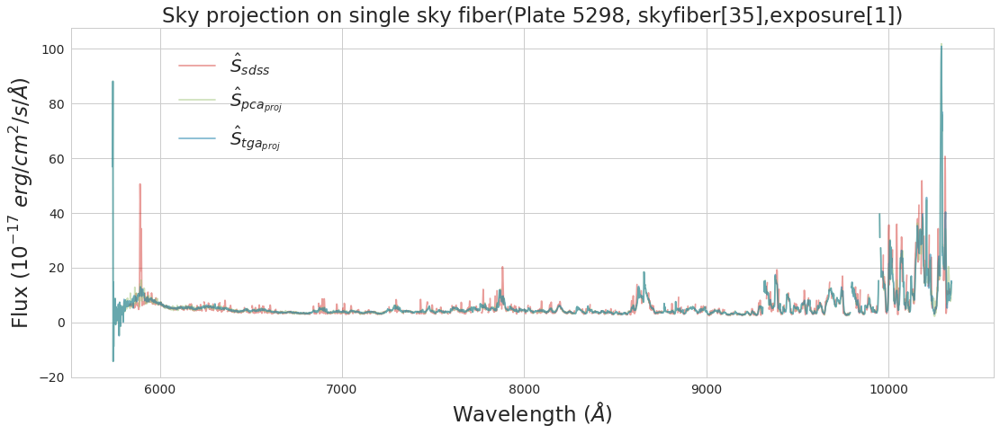

In [1953]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Sky projection on single sky fiber(Plate 5298, skyfiber[35],exposure[1])',fontsize=23)


x = plate5298_spec1_sky_wavelength1[35]
sdss = plate5298_spec1_sky_sdss_sky1[35]
pca_proj = plate5298_pca_proj_sky_196[84]
tga_proj = plate5298_tga_projected_sky_20[84]

ax.plot(x, sdss, '-', color='r', alpha=0.4, label='$\hat{S}_{sdss}$')
ax.plot(x, pca_proj, '-', color='g', alpha=0.5, label='$\hat{S}_{pca_{proj}}$')
ax.plot(x, tga_proj, '-', color='b', alpha=0.5, label='$\hat{S}_{tga_{proj}}$')

#ax.text(6000, 2.8, 'Difference of Sky Spectra Projection', fontsize=25)

# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20)

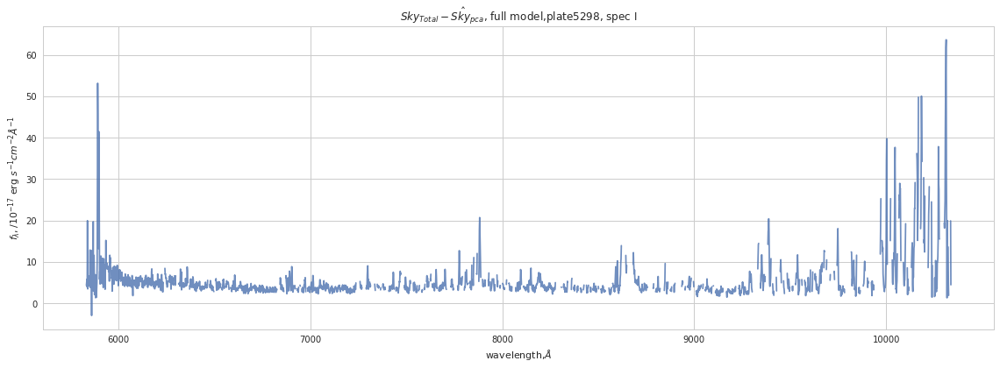

In [2071]:
x = plate5298_spec1_sky_wavelength[84]
y = plate5298_pca_sky_196[84]


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

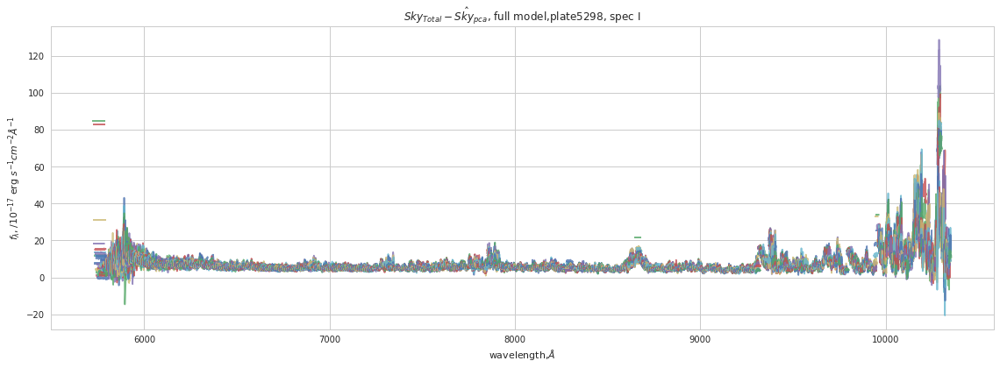

In [2076]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_pca_proj_QSO_196


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

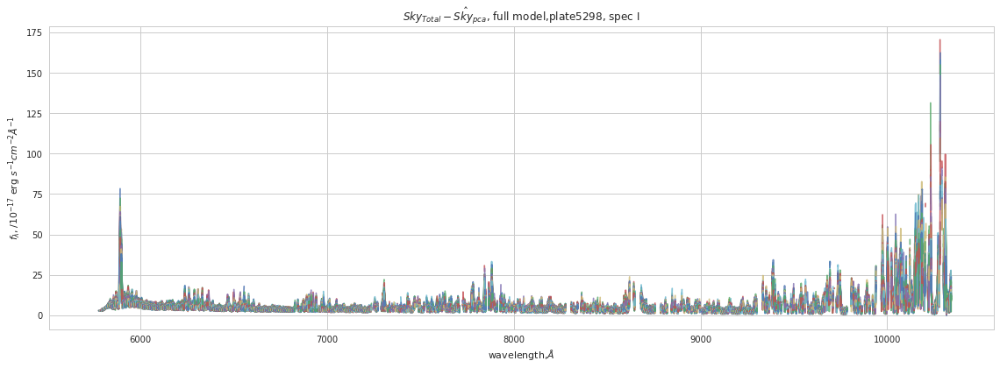

In [2077]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_spec1_QSO_sdss_sky


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

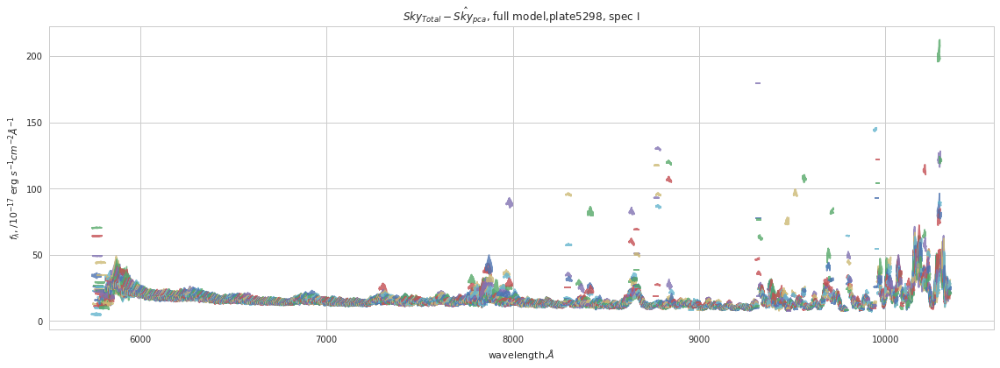

In [2073]:
x = plate5298_spec1_Fstar_wavelength
y = plate5298_pca_proj_Fstar_196


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

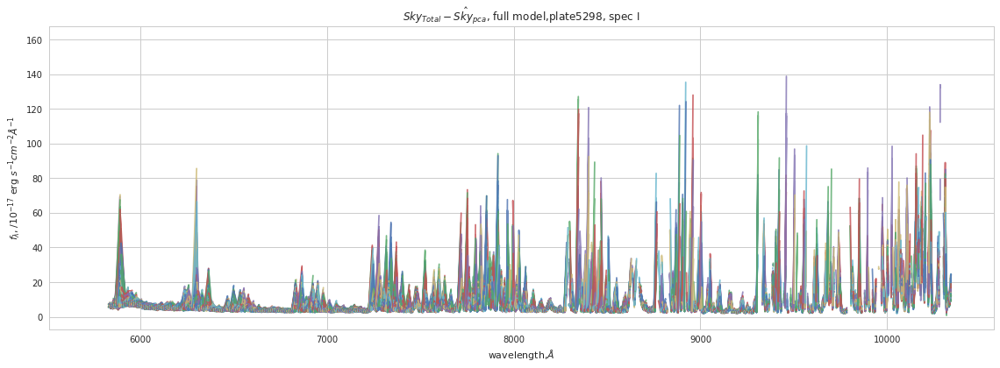

In [2063]:
x = plate5298_spec1_Fstar_wavelength
y = plate5298_spec1_Fstar_sdss_sky


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

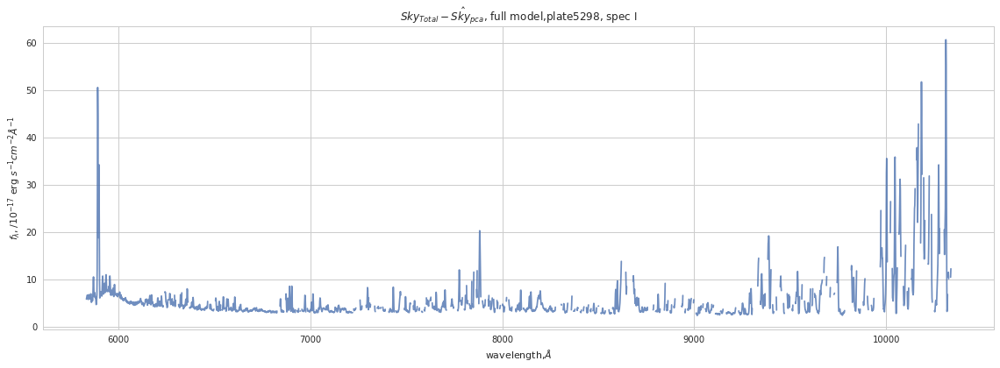

In [1967]:
x = plate5298_spec1_sky_wavelength[84]
y = plate5298_spec1_sky_sdss_sky[84]


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

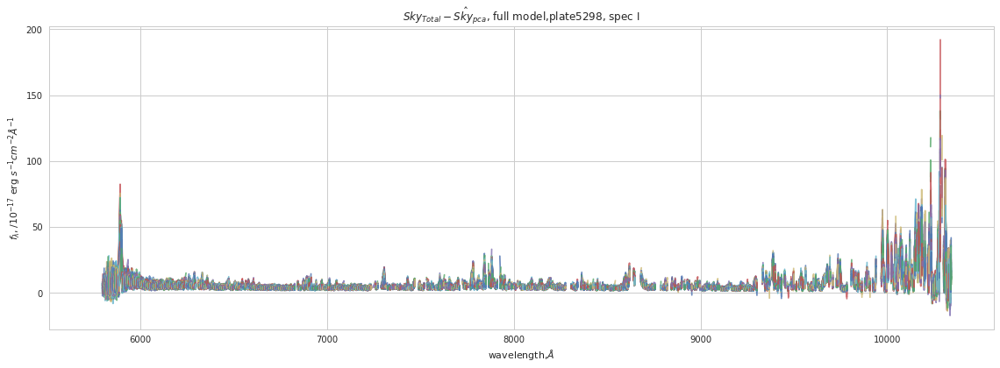

In [1965]:
x = plate5298_spec1_sky_wavelength
y = plate5298_pca_sky_196


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

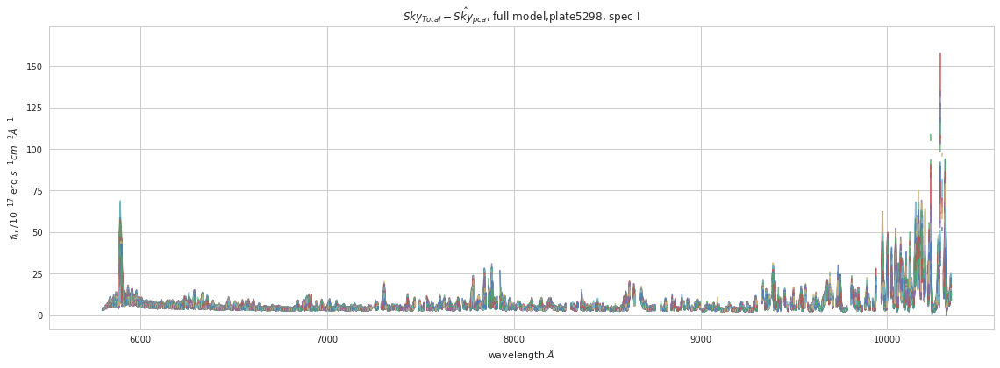

In [1966]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_sdss_sky


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

### PCA Sky Reconstruction
Reconstruct Sky signal with input of totl flux from sky fibers.

In [1955]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler

def pca_sky(sky_data, ncomp):
    '''Compute the pca modeled sky information
    
    Parameters
    -------------
    sky_flux: Masked array of valid data from sky fibers to produce the pca model
    ncomp: number of principal components to keep
    
    Return
    --------
    
    '''
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #normalized sky signal subtracted by weighted average and weighted by noise
    
    sky_wa_normalized = sky_wa_residuals*(sky_iv**0.5)
    
    sky_wa_normalized_M = np.ma.median(sky_wa_normalized, axis=0)
    sky_wa_normalized_filled = np.ma.filled(np.ma.filled(sky_wa_normalized, fill_value=sky_wa_normalized_M),fill_value=0)
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_normalized_filled)
    
    pca_sky = decomposition.PCA(n_components = ncomp)
    pca_sky.fit(standardized_sky)
    
    eigenvectors = pca_sky.components_
    
    variance_sum = 0
    for n in range(ncomp):
        variance_sum = variance_sum + pca_sky.explained_variance_ratio_[n]
    print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    reduced_sky = pca_sky.fit_transform(standardized_sky)
   
    #Reconstruction of input sky information 
    projection_standardized = pca_sky.inverse_transform(reduced_sky)
    
    #Reverse standardization
    projection= scaler_sky.inverse_transform(projection_standardized)
    
    
    #Reverse normalization to original data dimension
    modeled_sky = projection * (sky_iv**(-0.5)) + sky_wa_resized
    
    return modeled_sky

\begin{align*}
&z_i=\frac{x_i - \bar{x}}{s}\\
&x_i: S_{a,\sigma{n}}, \text{scaled total flux data} \\
&\bar{x}: \text{average of} S_{a,\sigma{n}}\\
&s: \text{standard deviation of} \ S_{a,\sigma{n}}
\end{align*}

\begin{align*}
&z_i=\frac{x_i - \bar{x}}{s}\\
&x_i: R_a, \text{weighted average subtracted total flux data} \\
&\bar{x}: \text{average of} R_a\\
&s: \text{standard deviation of} \ R_a
\end{align*}

\begin{align*}
&a_j = \underline{f} \cdot \underline{e_j} \\
&f_k = \sum_{j=1}^M a_j e_{jk} \\
\end{align*}

$a_j: \text{principal component amplitudes 
        for each noise-weighted input spectrum} \underline{f}\\
f_k: \text{reconstruction of the input spectrum} $


In [1956]:
np.seterr(invalid='ignore')

{'divide': 'ignore', 'invalid': 'ignore', 'over': 'warn', 'under': 'ignore'}

#### Plate 5298 PCA

In [1681]:
plate5298_spec1_all_sky.shape

(196, 4128)

##### Plate 5298 PCA Sky Reconstruction

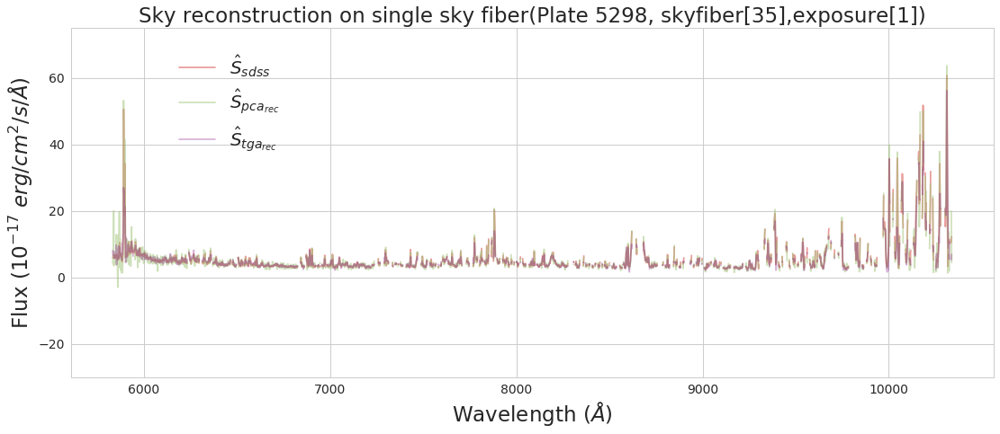

In [1977]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Sky reconstruction on single sky fiber(Plate 5298, skyfiber[35],exposure[1])',fontsize=23)
ax.set_ylim(-30, 75)

x = plate5298_spec1_sky_wavelength1[35]
sdss = plate5298_spec1_sky_sdss_sky1[35]
pca_rec = plate5298_pca_sky_196[84]
wpca_rec = plate5298_wpca_sky_196[84]
tga_rec=plate5298_tga_sky_20[84]


ax.plot(x, sdss, '-', color='r', alpha=0.4, label='$\hat{S}_{sdss}$')
ax.plot(x, pca_rec, '-', color='g', alpha=0.5, label='$\hat{S}_{pca_{rec}}$')
ax.plot(x, tga_rec, '-', color='purple', alpha=0.3, label='$\hat{S}_{tga_{rec}}$')


# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20)

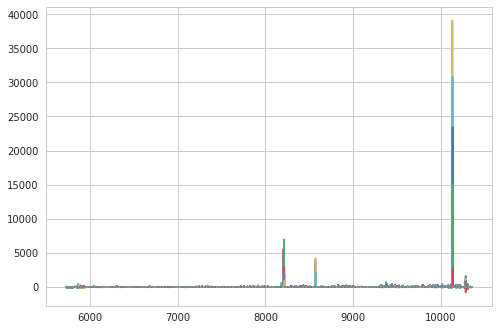

In [2013]:
x = plate5298_spec1_sky_wavelength
y = plate5298_wpca_sky_196

plt.plot(x,y)
plt.show()

In [1975]:
plate5298_pca_sky_196 = pca_sky(plate5298_spec1_all_sky,ncomp=196)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


196 components explain 100.00000080326683 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


In [1961]:
plate5298_pca_sky_196.shape

(196, 4128)

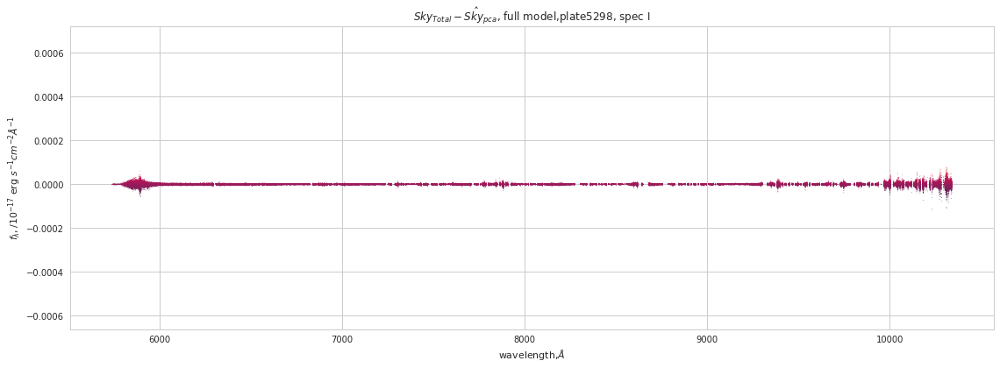

In [1962]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_total_flux - plate5298_pca_sky_196

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


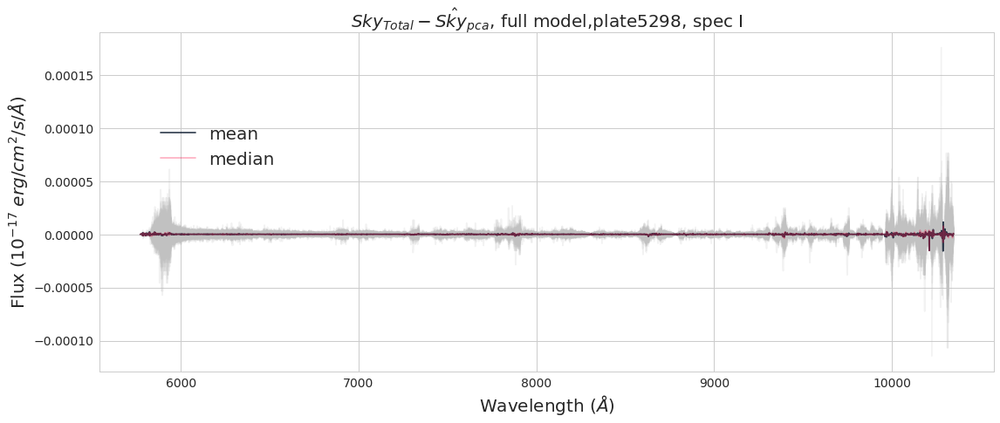

In [1963]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_sky_196_Tres = plate5298_spec1_sky_total_flux - plate5298_pca_sky_196

for flux in plate5298_pca_sky_196_Tres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_sky_196_Tres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_sky_196_Tres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

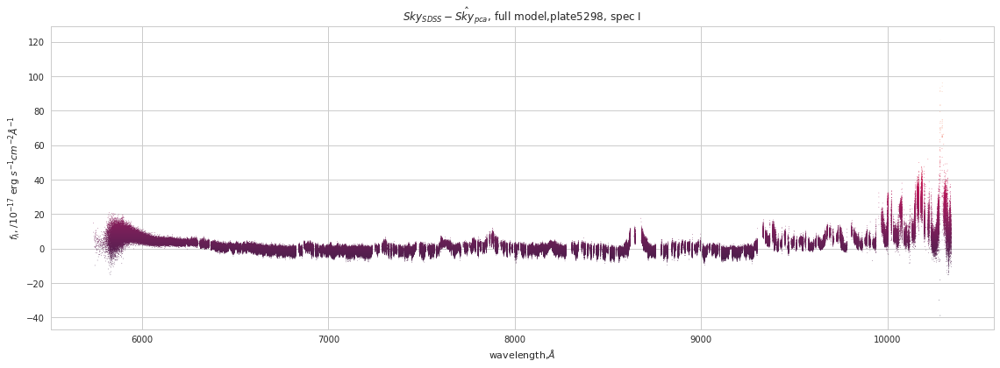

In [1417]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_sdss_sky - plate5298_pca_sky_196

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("w`avelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

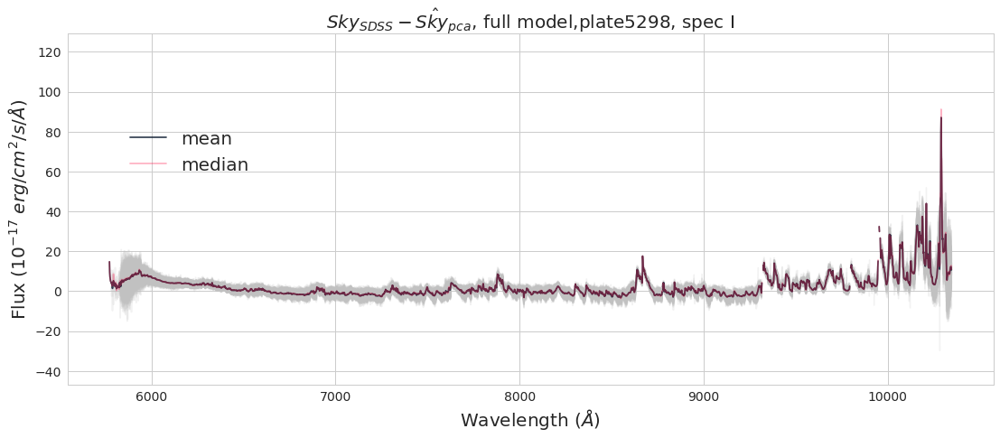

In [1418]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_sky_196_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_pca_sky_196

for flux in plate5298_pca_sky_196_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_sky_196_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_sky_196_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

In [1683]:
plate5298_pca_sky_126 = pca_sky(plate5298_spec1_all_sky,ncomp=126)

126 components explain 90.03530396148562 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


In [1428]:
plate5298_pca_sky_126.shape

(196, 4128)

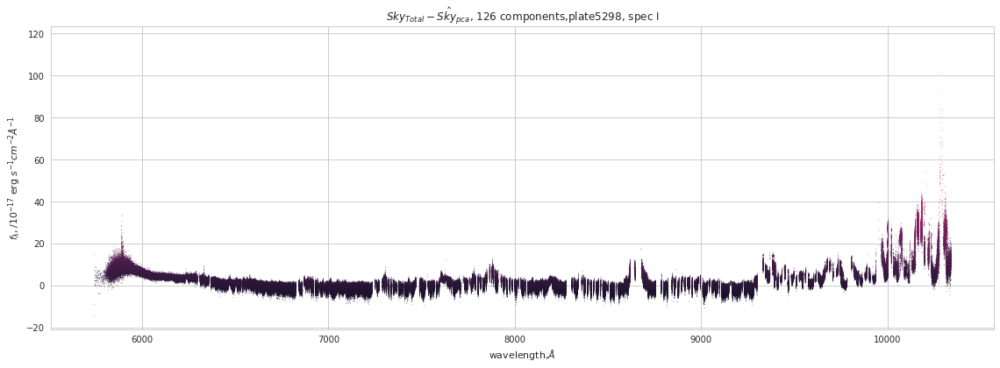

In [1429]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_total_flux - plate5298_pca_sky_126

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, 126 components,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


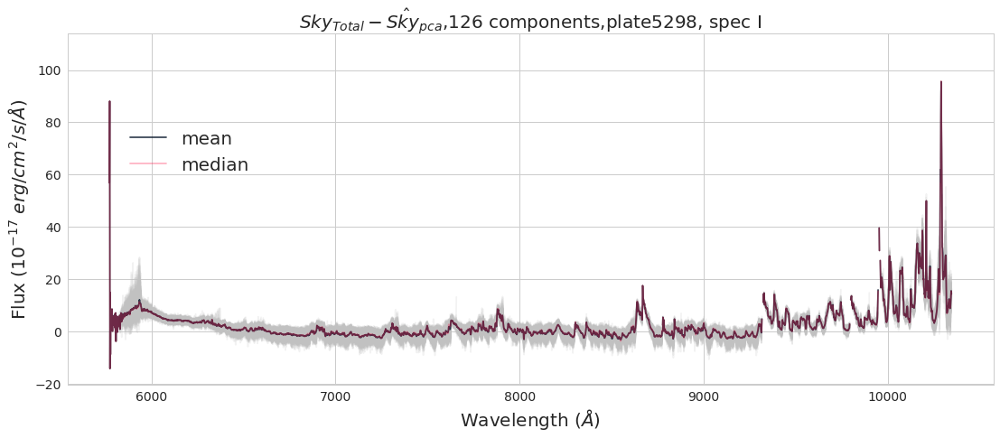

In [1684]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_sky_126_Tres = plate5298_spec1_sky_total_flux - plate5298_pca_sky_126

for flux in plate5298_pca_sky_126_Tres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_sky_126_Tres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_sky_126_Tres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$,126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

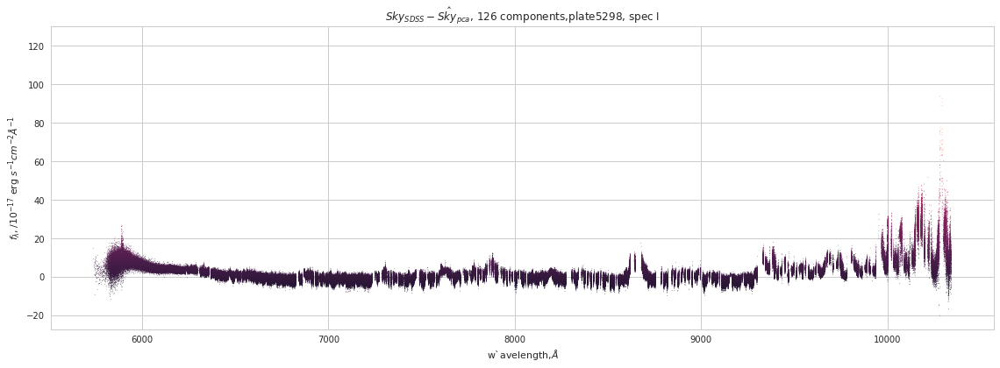

In [1432]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_sdss_sky - plate5298_pca_sky_126

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 126 components,plate5298, spec I")
plt.xlabel("w`avelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

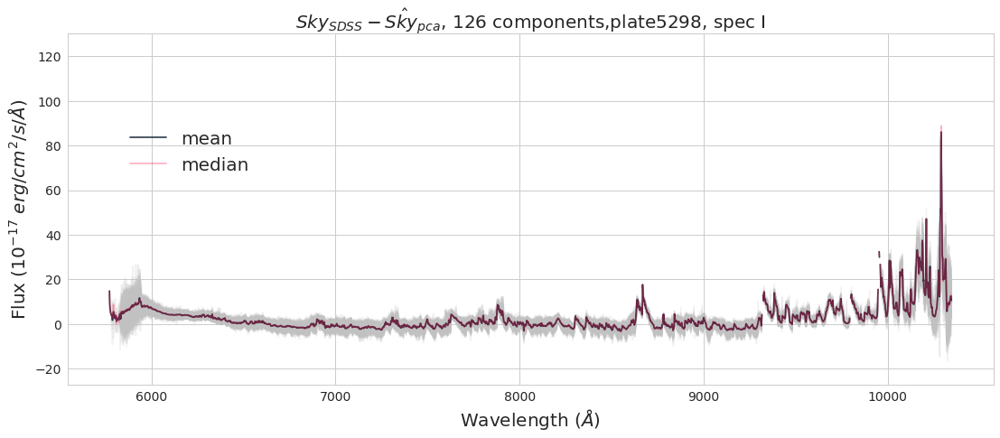

In [1431]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_sky_126_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_pca_sky_126

for flux in plate5298_pca_sky_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_sky_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_sky_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

##### Plate 5298 PCA Sky Projection

In [1840]:
plate5298_pca_projected_sky_196.shape

(196, 4128)

In [1805]:
plate5298_spec1_sky_wavelength.shape

(196, 4128)

The sky fiber indexed at 35 from exposure indexed 1, plate 5298, which has index number 84 in projection matrix for all sky fibers across 4 exposures.

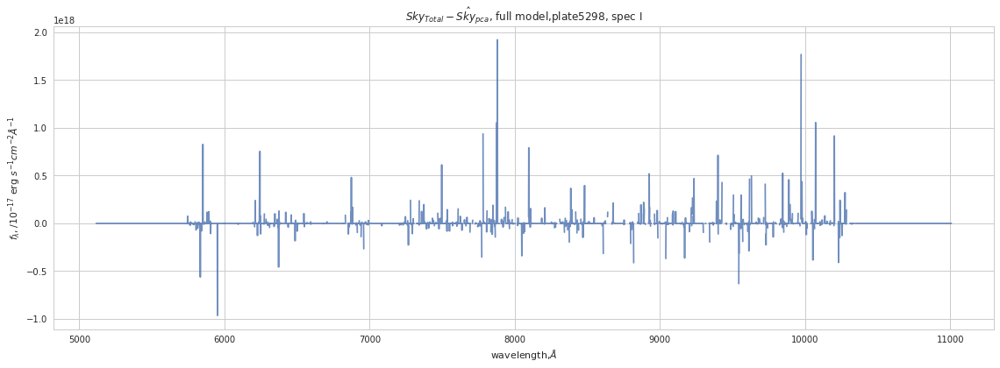

In [1841]:
x = plate5298_spec1_sky_wavelength[84]
y = plate5298_projected_sky_196ed_sky_196[84]



plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

In [ ]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title('Sky projection on single sky fiber(Plate 5298, skyfiber[35],exposure[1])',fontsize=23)
ax.set_ylim(-30, 75)

x = plate5298_spec1_sky_wavelength1[35]
sdss = plate5298_spec1_sky_sdss_sky1[35]
pca_proj = plate5298_pca_sky_196[84]
wpca_proj = plate5298_wpca_sky_196[84]
tga_proj=plate5298_tga_sky_20[84]

pca_proj = plate5298_pca_projected_sky_196[84]

#ax.plot(x, sdss, '-', color='b', alpha=0.4, label='sdss')
ax.plot(x, sdss, '-', color='r', alpha=0.4, label='$\hat{S}_{sdss}$')
ax.plot(x, pca_rec, '-', color='g', alpha=0.5, label='$\hat{S}_{pca_{rec}}$')
ax.plot(x, tga_rec, '-', color='purple', alpha=0.3, label='$\hat{S}_{tga_{rec}}$')


# Put legend on
ax.legend(loc=[0.11, 0.62], fontsize=20)

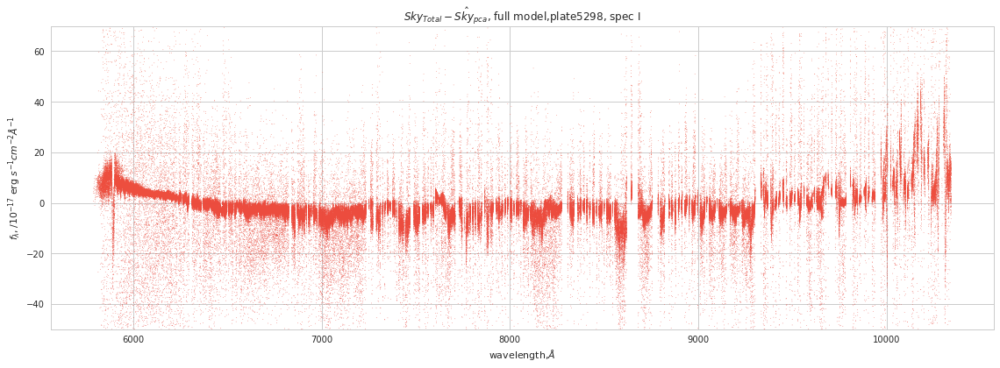

In [1437]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_total_flux - plate5298_pca_projected_sky_196

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-50,70)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


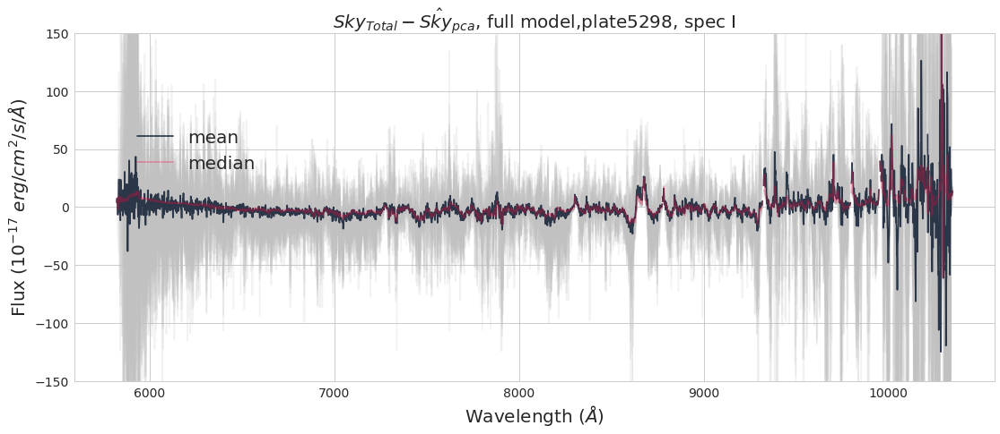

In [1588]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_projected_sky_196_Tres = plate5298_spec1_sky_total_flux - plate5298_pca_projected_sky_196

for flux in plate5298_pca_projected_sky_196_Tres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_projected_sky_196_Tres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_projected_sky_196_Tres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I",fontsize=20)
ax.set_ylim(-150,150)

ax.legend(loc=[0.06,0.58],fontsize=20);

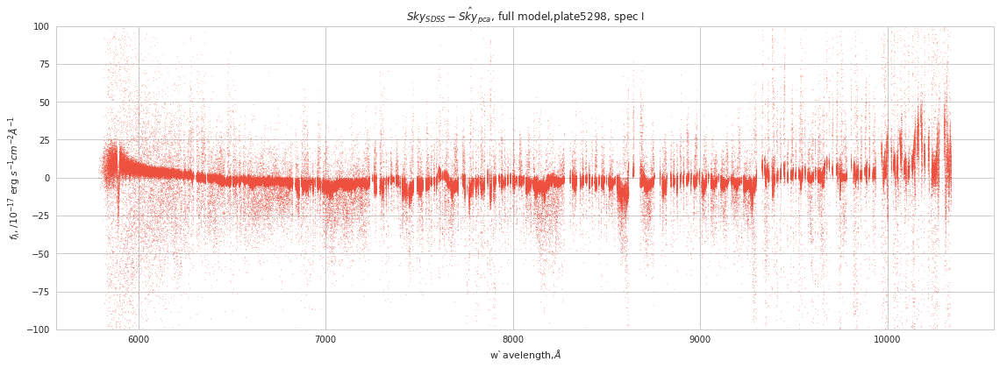

In [1447]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_sdss_sky - plate5298_pca_projected_sky_196

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-100,100)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("w`avelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


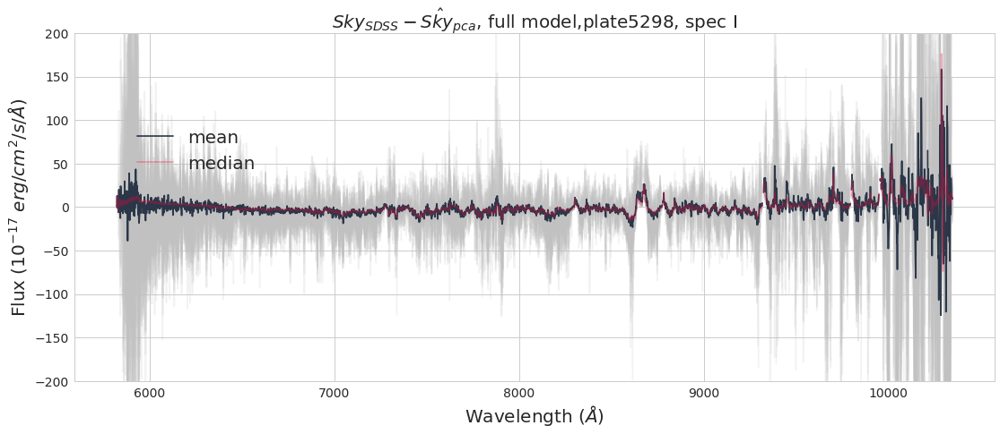

In [1450]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_projected_sky_196_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_pca_projected_sky_196

for flux in plate5298_pca_projected_sky_196_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_projected_sky_196_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_projected_sky_196_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate5298, spec I",fontsize=20)
ax.set_ylim(-200,200)

ax.legend(loc=[0.06,0.58],fontsize=20);

In [1427]:
plate5298_pca_sky_126 = pca_sky(plate5298_spec1_all_sky,ncomp=126)

126 components explain 90.03352363361046 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


In [1428]:
plate5298_pca_sky_126.shape

(196, 4128)

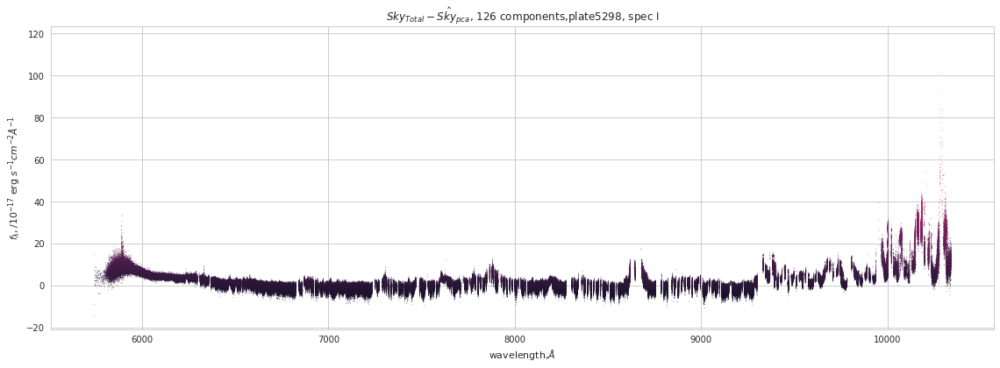

In [1429]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_total_flux - plate5298_pca_sky_126

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, 126 components,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


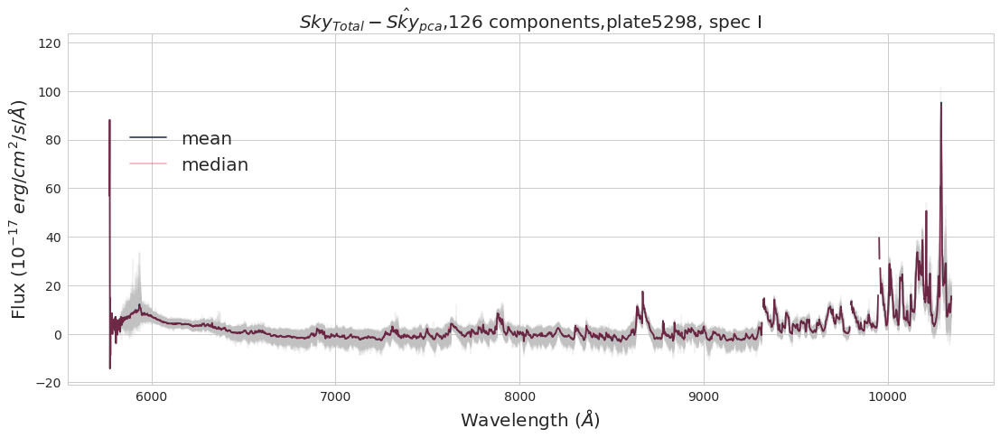

In [1430]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_sky_126_Tres = plate5298_spec1_sky_total_flux - plate5298_pca_sky_126

for flux in plate5298_pca_sky_126_Tres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_sky_126_Tres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_sky_126_Tres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$,126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

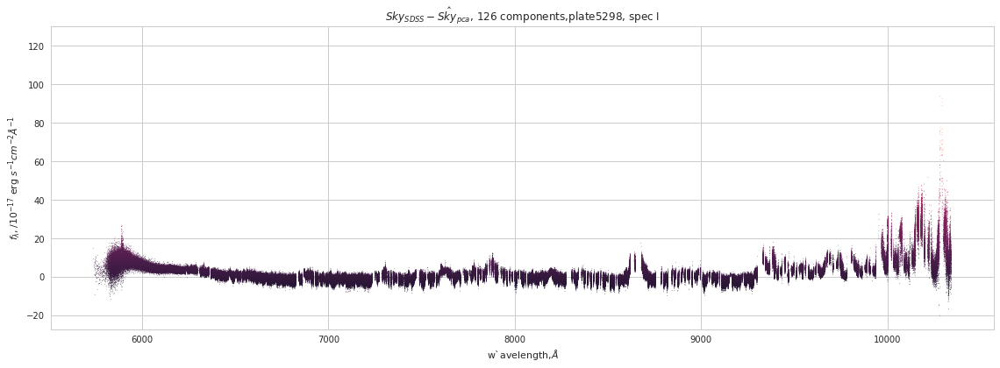

In [1432]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_sdss_sky - plate5298_pca_sky_126

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 126 components,plate5298, spec I")
plt.xlabel("w`avelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

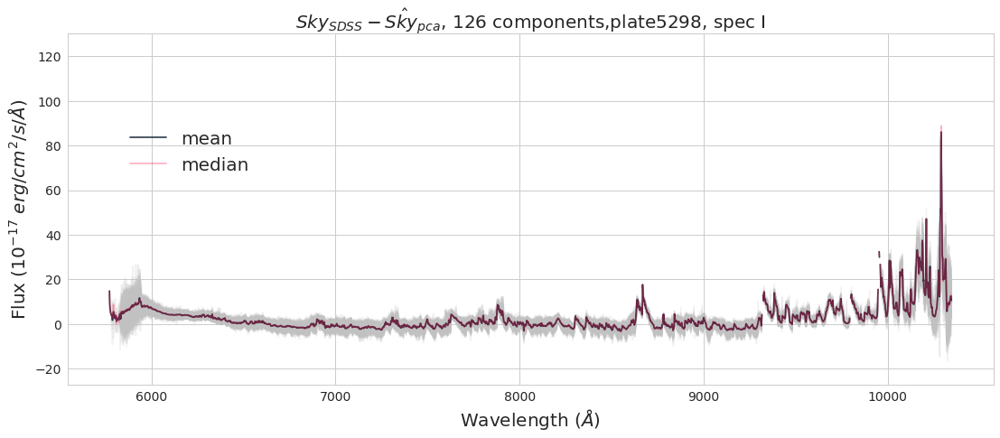

In [1431]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_sky_126_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_pca_sky_126

for flux in plate5298_pca_sky_126_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_sky_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_sky_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 126 components,plate5298, spec I",fontsize=20)

ax.legend(loc=[0.06,0.58],fontsize=20);

##### Plate 5298 PCA QSO Projection

In [1520]:
plate5298_spec1_all_QSO.shape

(332, 4128)

In [1521]:
plate5298_pca_projected_QSO_196 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,ncomp=196)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


196 components explain 100.00000080326683 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


In [1522]:
plate5298_pca_projected_QSO_196.shape

(332, 4128)

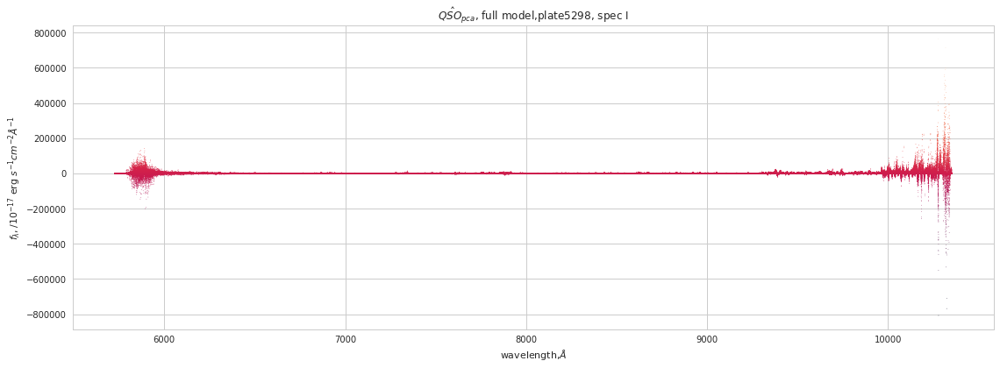

In [1523]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_pca_projected_QSO_196
plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("$\hat{QSO}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

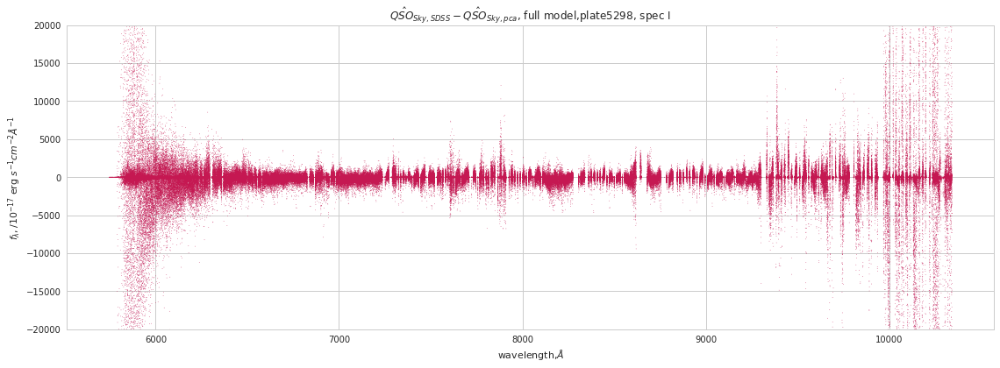

In [1525]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_spec1_QSO_sdss_sky - plate5298_pca_projected_QSO_196
plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20000,20000)
plt.title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


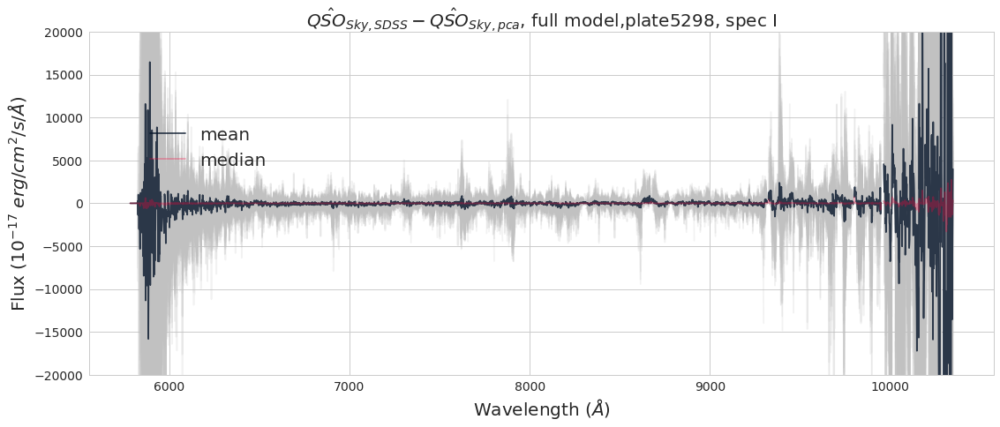

In [1526]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_projected_QSO_196_SDSSres = plate5298_spec1_QSO_sdss_sky - plate5298_pca_projected_QSO_196

for flux in plate5298_pca_projected_QSO_196_SDSSres:
    ax.plot(plate5298_spec1_QSO_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmean(plate5298_pca_projected_QSO_196_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmedian(plate5298_pca_projected_QSO_196_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,pca}$, full model,plate5298, spec I",fontsize=20)

ax.set_ylim(-20000,20000)
ax.legend(loc=[0.06,0.58],fontsize=20);

In [1527]:
plate5298_pca_QSO_126 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,ncomp=126)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


126 components explain 90.03645495977253 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


In [1528]:
plate5298_pca_QSO_126.shape

(332, 4128)

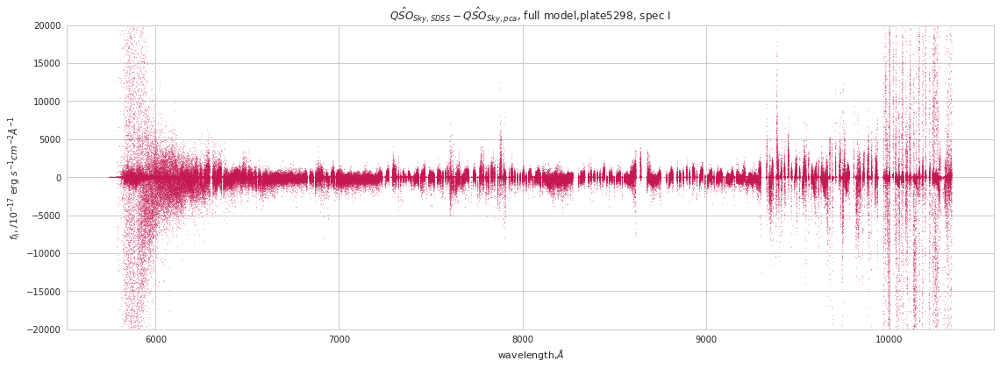

In [1531]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_spec1_QSO_sdss_sky - plate5298_pca_QSO_126

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20000,20000)
plt.title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


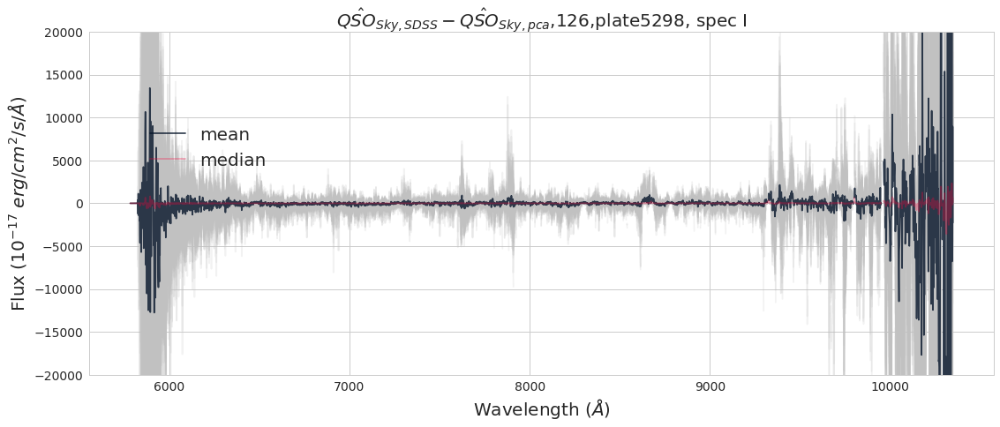

In [1532]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_projected_QSO_126_SDSSres = plate5298_spec1_QSO_sdss_sky - plate5298_pca_QSO_126

for flux in plate5298_pca_projected_QSO_126_SDSSres:
    ax.plot(plate5298_spec1_QSO_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmean(plate5298_pca_projected_QSO_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmedian(plate5298_pca_projected_QSO_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,pca}$,126,plate5298, spec I",fontsize=20)

ax.set_ylim(-20000,20000)
ax.legend(loc=[0.06,0.58],fontsize=20);

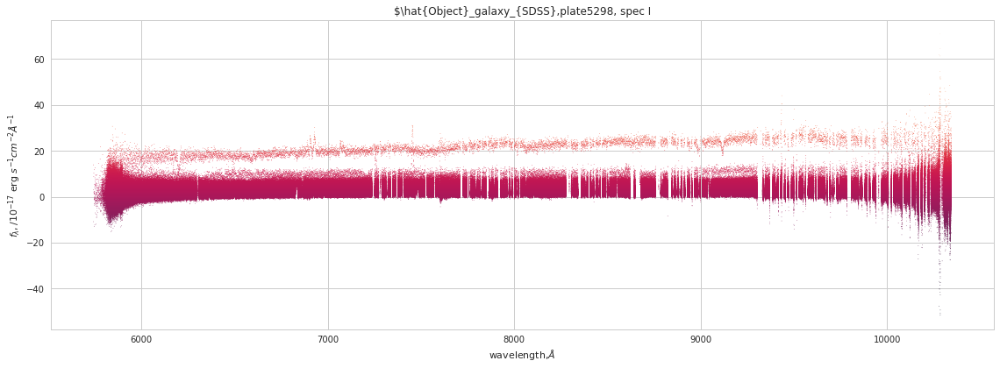

In [1460]:
x = plate5298_spec1_galaxy_wavelength
y = plate5298_spec1_galaxy_sdss_flux

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("$\hat{Object}_galaxy_{SDSS},plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

##### Plate 5298 PCA Fstar Projection

In [1533]:
plate5298_spec1_all_Fstar.shape

(40, 4128)

In [1534]:
plate5298_pca_projected_Fstar_196 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_Fstar,ncomp=196)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


196 components explain 100.00000080326683 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 769 results
  r = func(a, **kwargs)


In [1535]:
plate5298_pca_projected_Fstar_196.shape

(40, 4128)

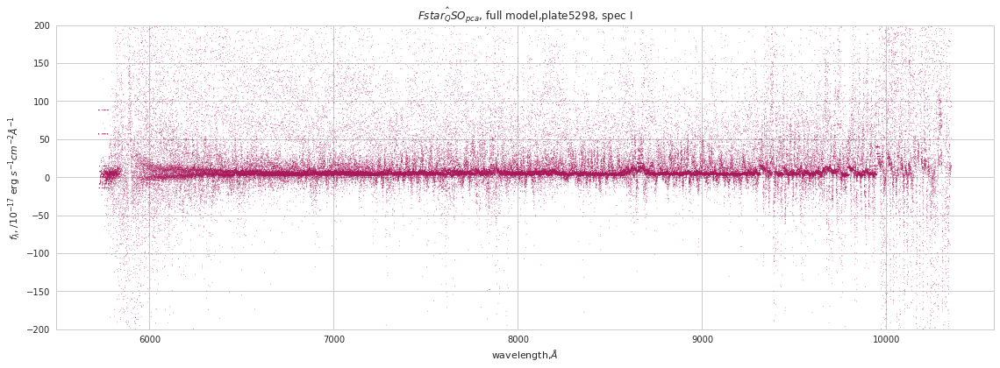

In [1538]:
x = plate5298_spec1_Fstar_wavelength
y = plate5298_pca_projected_Fstar_196
plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-200,200)

plt.title("$\hat{Fstar_QSO}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

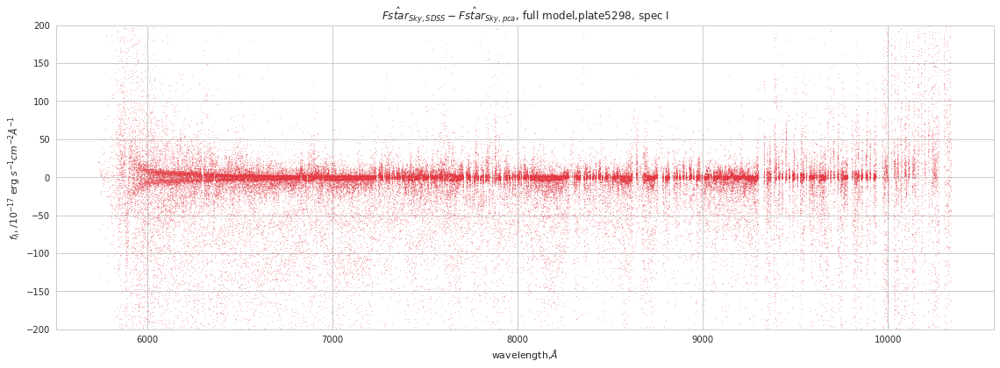

In [1537]:
x = plate5298_spec1_Fstar_wavelength
y = plate5298_spec1_Fstar_sdss_sky - plate5298_pca_projected_Fstar_196
plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-200,200)

plt.title("$\hat{Fstar}_{Sky,SDSS} - \hat{Fstar}_{Sky,pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


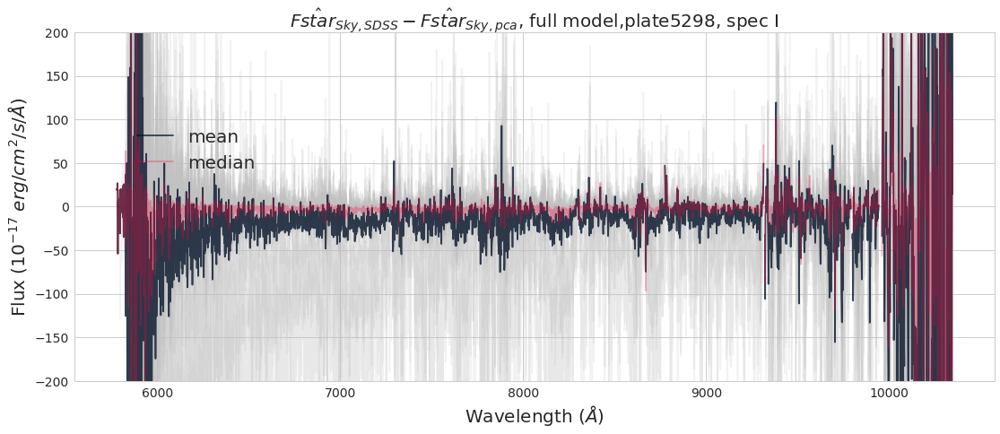

In [1539]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_projected_Fstar_196_SDSSres = plate5298_spec1_Fstar_sdss_sky - plate5298_pca_projected_Fstar_196

for flux in plate5298_pca_projected_Fstar_196_SDSSres:
    ax.plot(plate5298_spec1_QSO_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_Fstar_wavelength[0,:],np.nanmean(plate5298_pca_projected_Fstar_196_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_Fstar_wavelength[0,:],np.nanmedian(plate5298_pca_projected_Fstar_196_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("$\hat{Fstar}_{Sky,SDSS} - \hat{Fstar}_{Sky,pca}$, full model,plate5298, spec I",fontsize=20)
ax.set_ylim(-200,200)

ax.legend(loc=[0.06,0.58],fontsize=20);

In [1499]:
plate5298_pca_QSO_126 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,ncomp=126)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


126 components explain 90.05362710449845 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


In [1500]:
plate5298_pca_QSO_126.shape

(332, 4128)

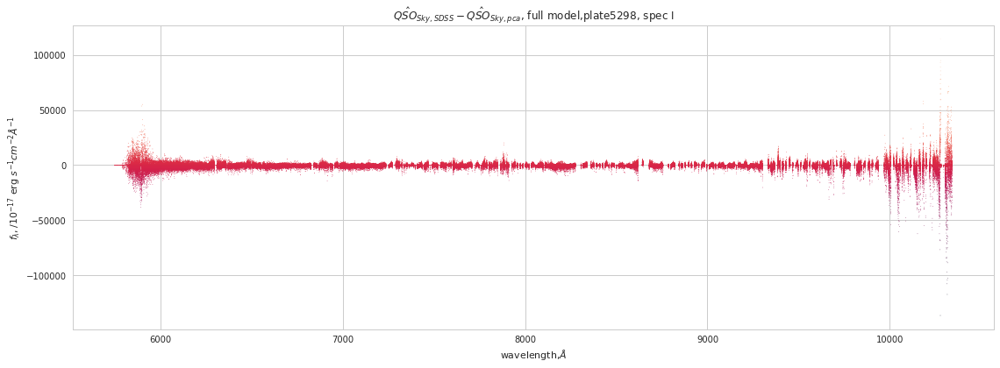

In [1502]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_spec1_QSO_sdss_sky - plate5298_pca_QSO_126

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


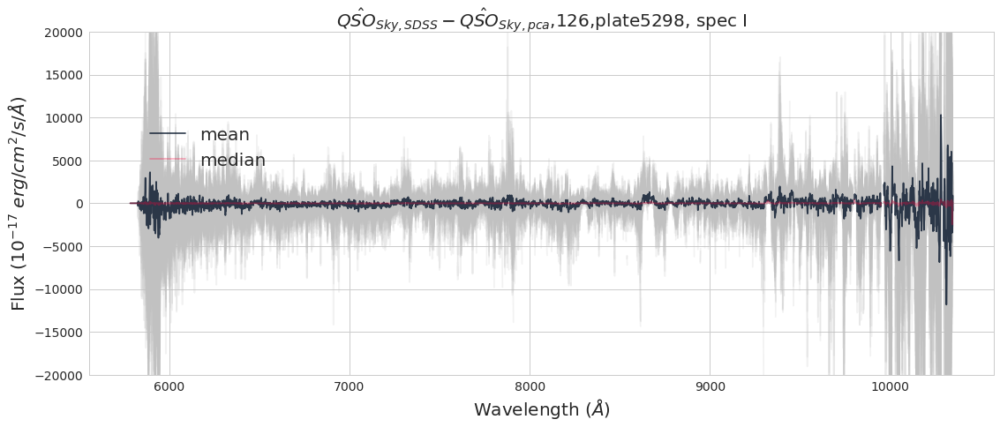

In [1504]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_projected_QSO_126_SDSSres = plate5298_spec1_QSO_sdss_sky - plate5298_pca_QSO_126

for flux in plate5298_pca_projected_QSO_126_SDSSres:
    ax.plot(plate5298_spec1_QSO_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmean(plate5298_pca_projected_QSO_126_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmedian(plate5298_pca_projected_QSO_126_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,pca}$,126,plate5298, spec I",fontsize=20)

ax.set_ylim(-20000,20000)
ax.legend(loc=[0.06,0.58],fontsize=20);

##### Plate 5298 PCA QSO Projection

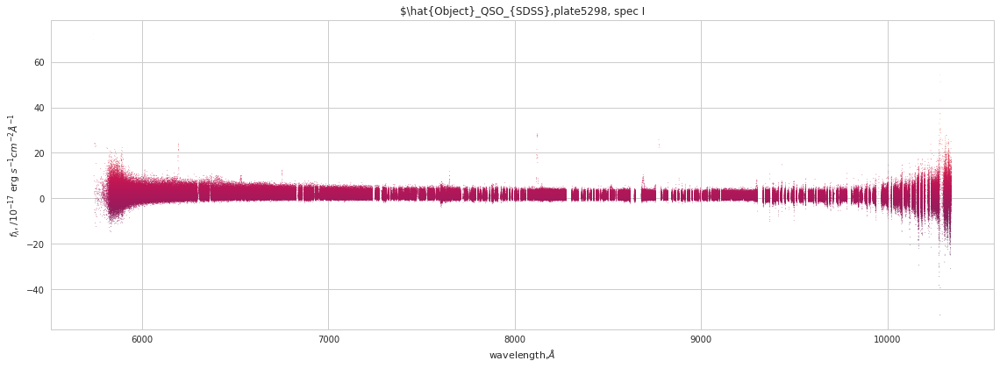

In [1459]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_spec1_QSO_sdss_flux

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("$\hat{Object}_QSO_{SDSS},plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

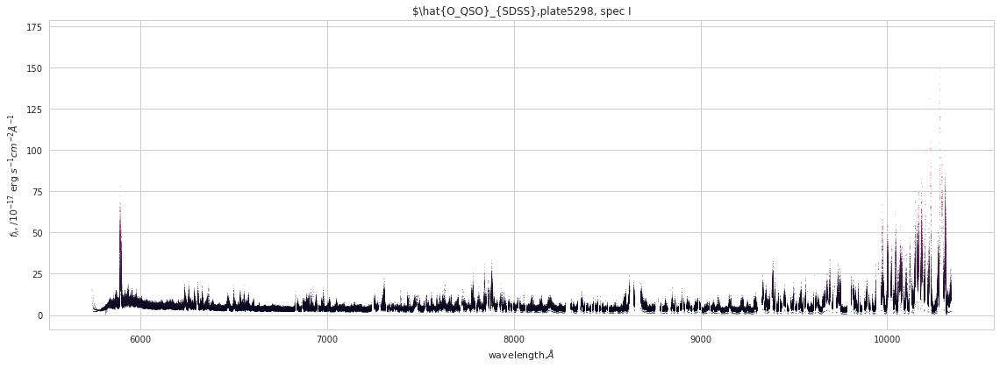

In [1458]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_spec1_QSO_sdss_sky

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("$\hat{O_QSO}_{SDSS},plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

In [1452]:
plate5298_pca_projected_QSO_196 = pca_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,ncomp=196)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


196 components explain 100.00000080326683 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


In [1453]:
plate5298_pca_projected_QSO_196.shape

(332, 4128)

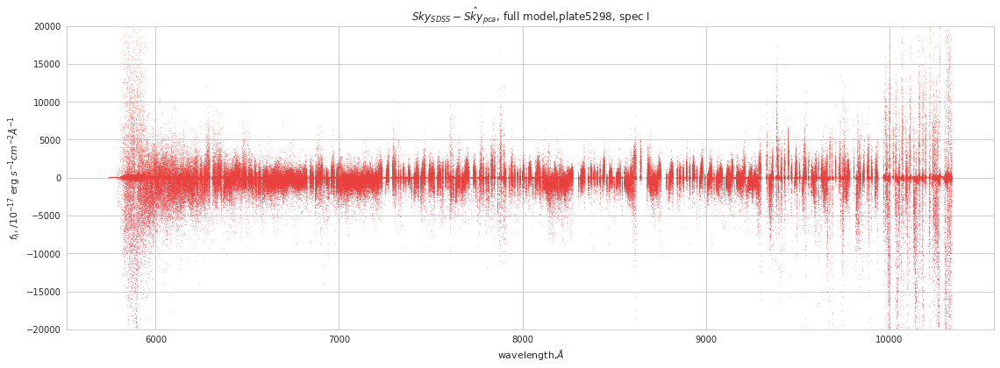

In [1457]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_spec1_QSO_sdss_sky - plate5298_pca_projected_QSO_196

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20000,20000)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


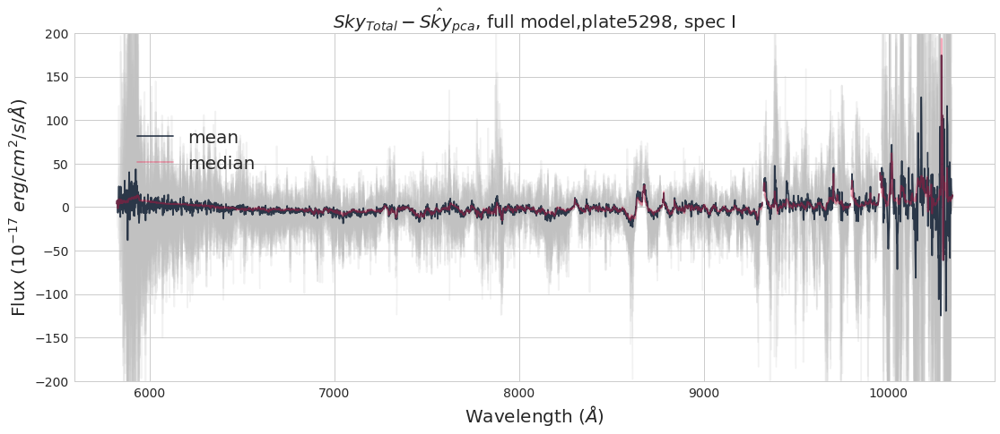

In [1451]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_projected_sky_196_Tres = plate5298_spec1_sky_total_flux - plate5298_pca_projected_sky_196

for flux in plate5298_pca_projected_sky_196_Tres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_projected_sky_196_Tres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_projected_sky_196_Tres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I",fontsize=20)
ax.set_ylim(-200,200)

ax.legend(loc=[0.06,0.58],fontsize=20);

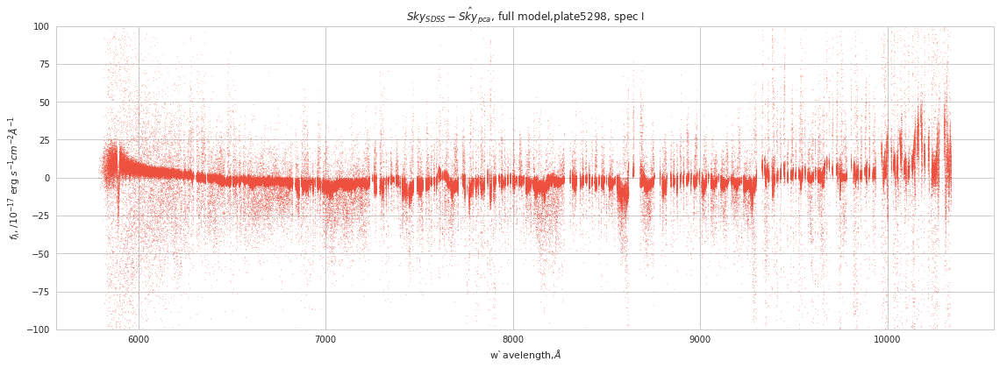

In [1447]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_sdss_sky - plate5298_pca_projected_sky_196

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-100,100)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("w`avelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


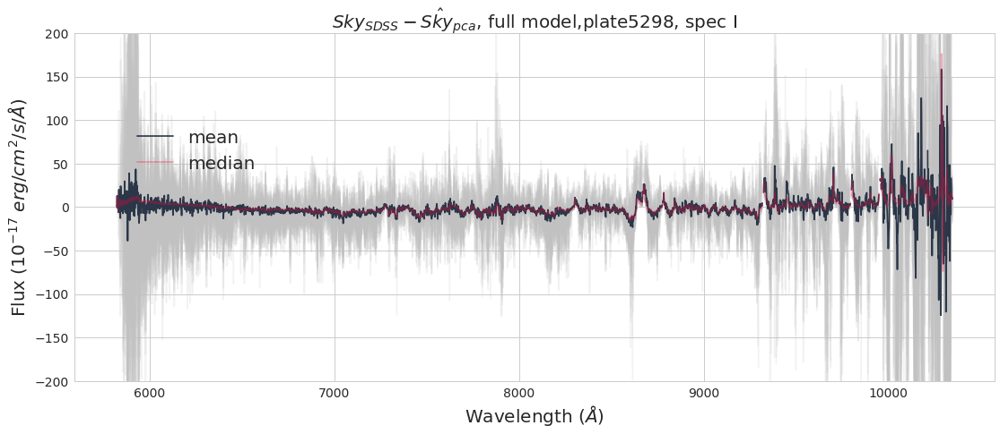

In [1450]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)', fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_projected_sky_196_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_pca_projected_sky_196

for flux in plate5298_pca_projected_sky_196_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_pca_projected_sky_196_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_pca_projected_sky_196_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate5298, spec I",fontsize=20)
ax.set_ylim(-200,200)

ax.legend(loc=[0.06,0.58],fontsize=20);

#### Plate 4042 PCA

In [1305]:
plate4042_sky_pca_128 = pca_model(plate4042_spec1_all_sky, plate4042_spec1_all_sky, ncomp=128)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


128 components explain 90.0731879286468 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2346 results
  r = func(a, **kwargs)


In [1306]:
plate4042_sky_pca_full = pca_model(plate4042_spec1_all_sky, plate4042_spec1_all_sky, ncomp=235)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


235 components explain 99.99999831198001 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2346 results
  r = func(a, **kwargs)


In [833]:
plate4042_QSO_pca = pca_model(plate4042_spec1_all_sky, plate4042_spec1_all_QSO, ncomp=128)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


128 components explain 90.05055635934696 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2931 results
  r = func(a, **kwargs)


In [834]:
plate4042_galaxy_pca = pca_model(plate4042_spec1_all_sky, plate4042_spec1_all_galaxy, ncomp=128)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


128 components explain 90.05577308125794 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 3139 results
  r = func(a, **kwargs)


In [844]:
plate4042_Fstar_pca = pca_model(plate4042_spec1_all_sky, plate4042_spec1_all_Fstar, ncomp=128)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 1709 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


128 components explain 90.06452542962506 % of variation


In [880]:
plate4042_sky_pca = pca_model(plate4042_spec1_all_sky, plate4042_spec1_all_sky, ncomp=128)

128 components explain 90.05857136799023 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2346 results
  r = func(a, **kwargs)


Plate 4042 Sky Fiber Reconstruction

In [1055]:
plate4042_standard_pca_sky_full = pca_sky(plate4042_spec1_all_sky, ncomp=235)

235 components explain 99.99999831198001 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


In [1053]:
plate4042_standard_pca_sky = pca_sky(plate4042_spec1_all_sky, ncomp=128)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


128 components explain 90.05975137697533 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


### Sky Projection
Plate 4042, full model with 235 componets to project on sky fibers

In [1302]:
plate4042_sky_pca.shape

(235, 4128)

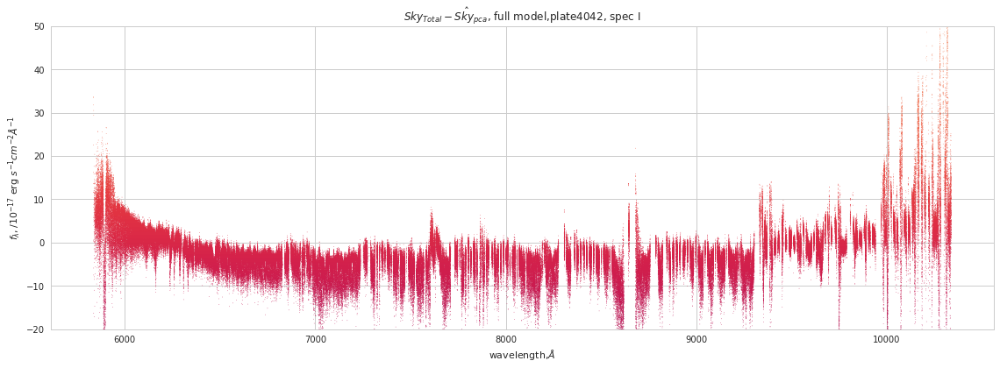

In [1309]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_total_flux - plate4042_sky_pca_full

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20,50)
plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


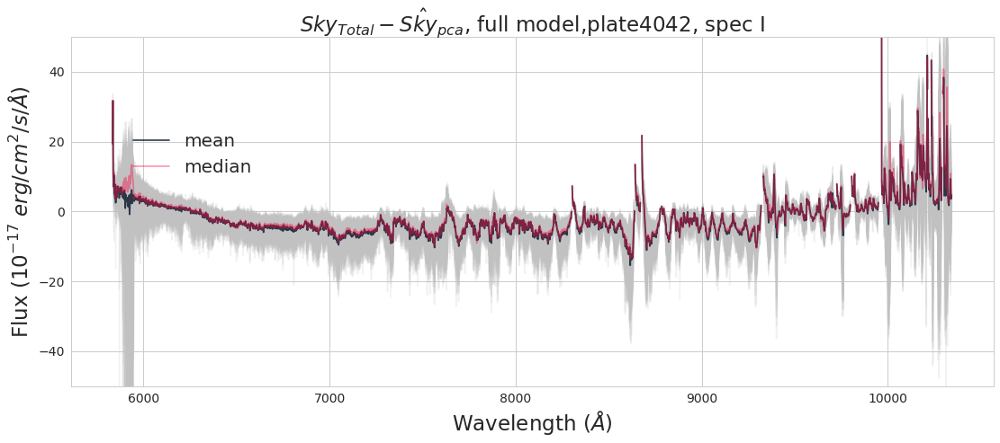

In [1316]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)

#Standard PCA result compared to total flux
plate4042_pca_fullproj_Totalres = plate4042_spec1_sky_total_flux - plate4042_sky_pca_full

for flux in plate4042_pca_fullproj_Totalres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_pca_fullproj_Totalres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_pca_fullproj_Totalres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate4042, spec I",fontsize=23)
ax.set_ylim(-50,50)

ax.legend(loc=[0.06,0.58],fontsize=20);

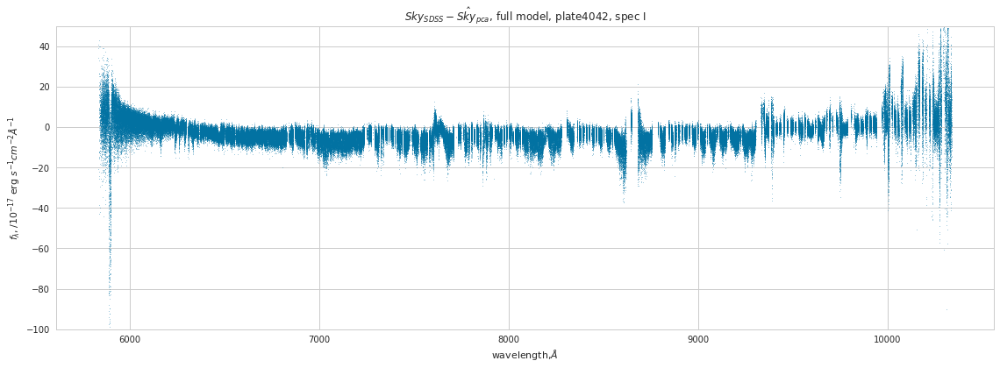

In [1311]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_sdss_sky- plate4042_sky_pca_full

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c='b')
plt.ylim(-100,50)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


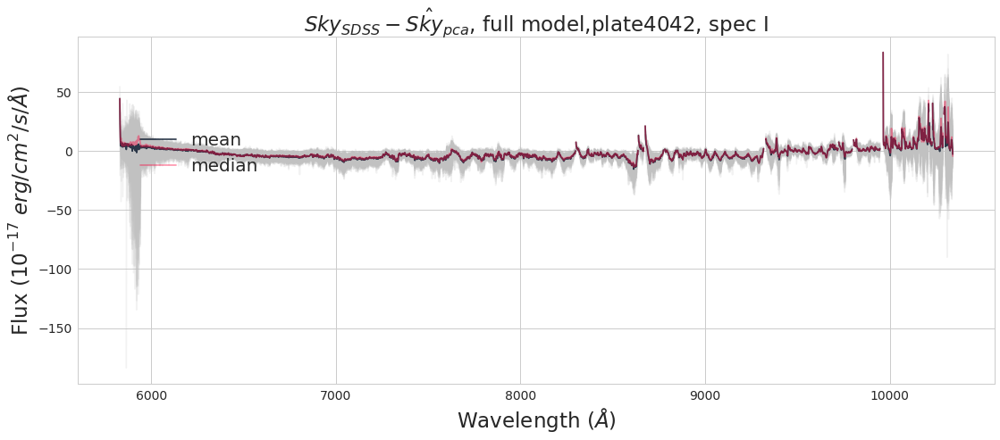

In [1317]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_pca_fullproj_SDSSres = plate4042_spec1_sky_sdss_sky - plate4042_sky_pca_full

for flux in plate4042_pca_fullproj_SDSSres:
    ax.plot(plate4042_spec1_sky_wavelength[3],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[3],np.nanmean(plate4042_pca_fullproj_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[3],np.nanmedian(plate4042_pca_fullproj_SDSSres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');

ax.legend(loc=[0.06,0.58],fontsize=20);

PCA Projection on sky fibers, plate4042, 128 components

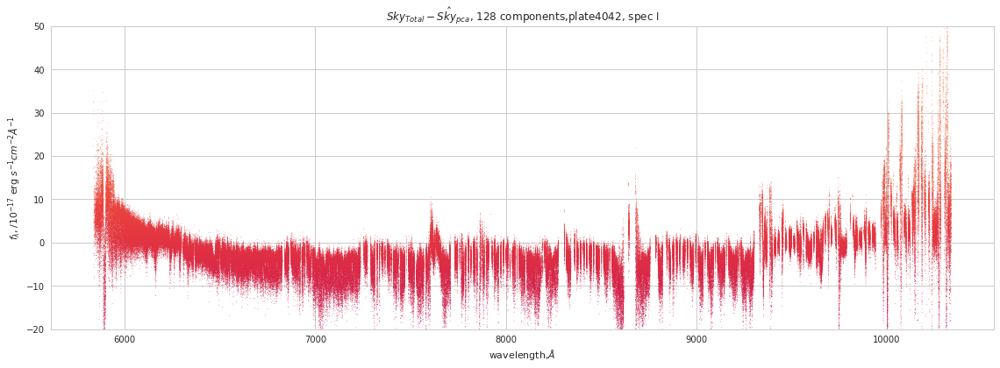

In [1308]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_total_flux - plate4042_sky_pca_128

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20,50)
plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, 128 components,plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


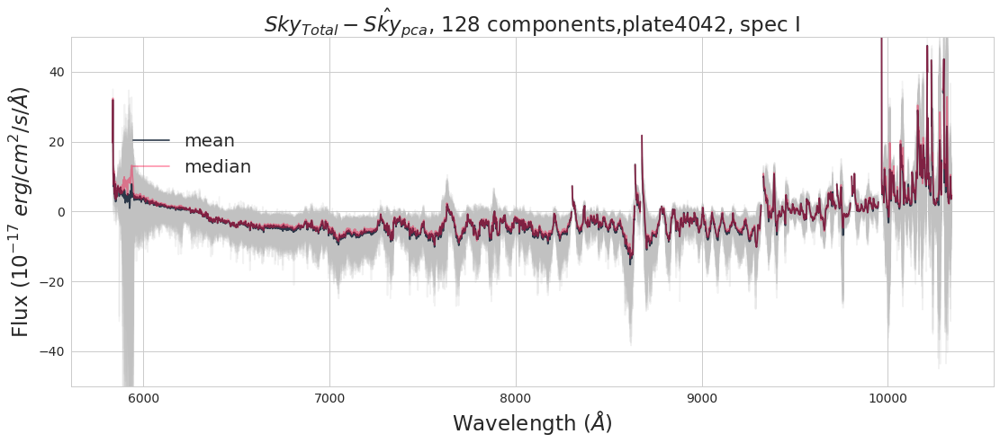

In [1318]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)

#Standard PCA result compared to total flux
plate4042_pca_128proj_Totalres = plate4042_spec1_sky_total_flux - plate4042_sky_pca_128

for flux in plate4042_pca_128proj_Totalres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_pca_128proj_Totalres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_pca_128proj_Totalres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$, 128 components,plate4042, spec I",fontsize=23)
ax.set_ylim(-50,50)

ax.legend(loc=[0.06,0.58],fontsize=20);

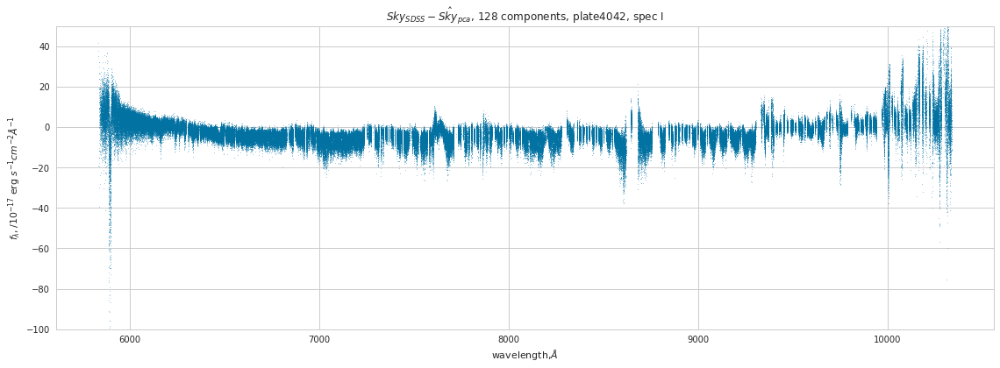

In [1319]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_sdss_sky- plate4042_sky_pca_128

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c='b')
plt.ylim(-100,50)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 128 components, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:24: RuntimeWarning: Mean of empty slice


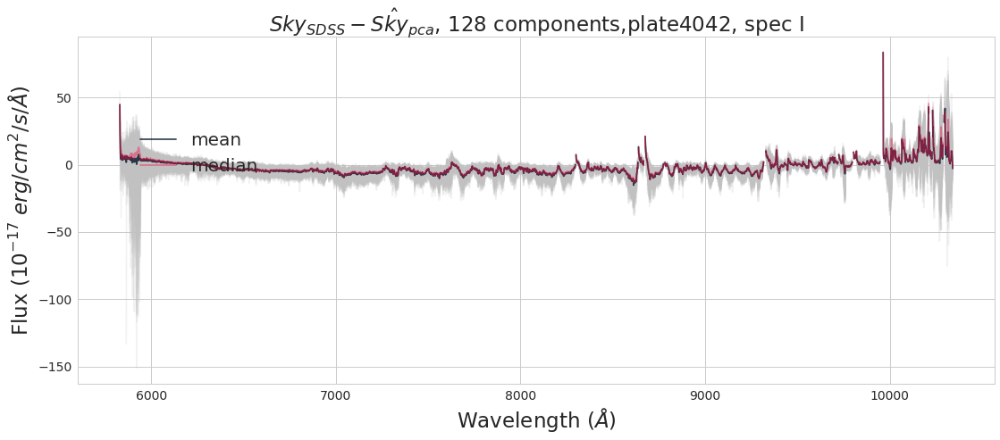

In [1321]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 128 components,plate4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_pca_128proj_SDSSres = plate4042_spec1_sky_sdss_sky - plate4042_sky_pca_128

for flux in plate4042_pca_128proj_SDSSres:
    ax.plot(plate4042_spec1_sky_wavelength[3],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[3],np.nanmean(plate4042_pca_128proj_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[3],np.nanmedian(plate4042_pca_128proj_SDSSres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');

ax.legend(loc=[0.06,0.58],fontsize=20);

Sky projection on Galaxy fibers, full model with 235 components.

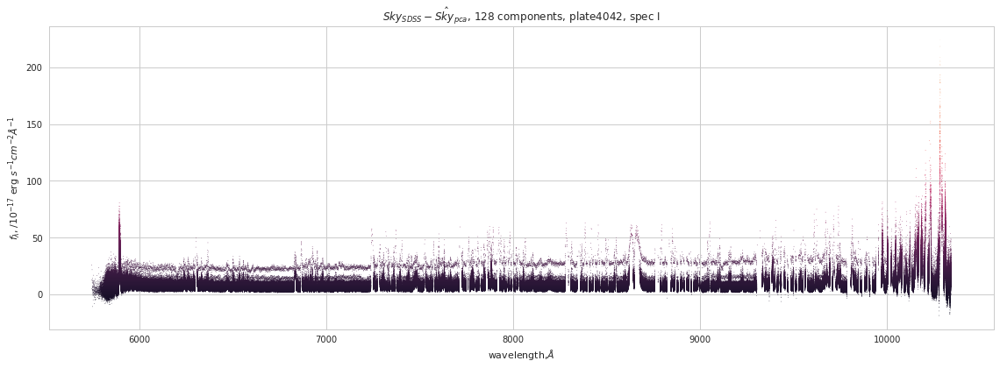

In [1370]:
x = plate5298_spec1_galaxy_wavelength
y = plate5298_spec1_galaxy_total_flux

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)


plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 128 components, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

### Sky Reconstruction
Plate 4042, full model with 235 components

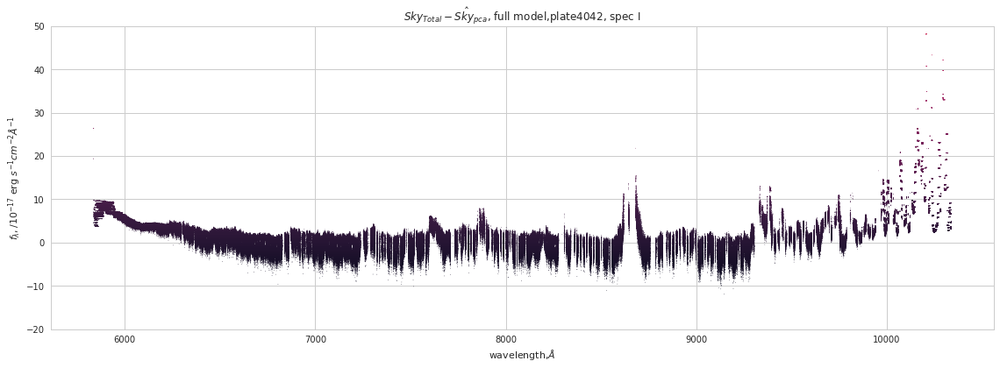

In [1079]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_total_flux - plate4042_standard_pca_sky_full

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20,50)
plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

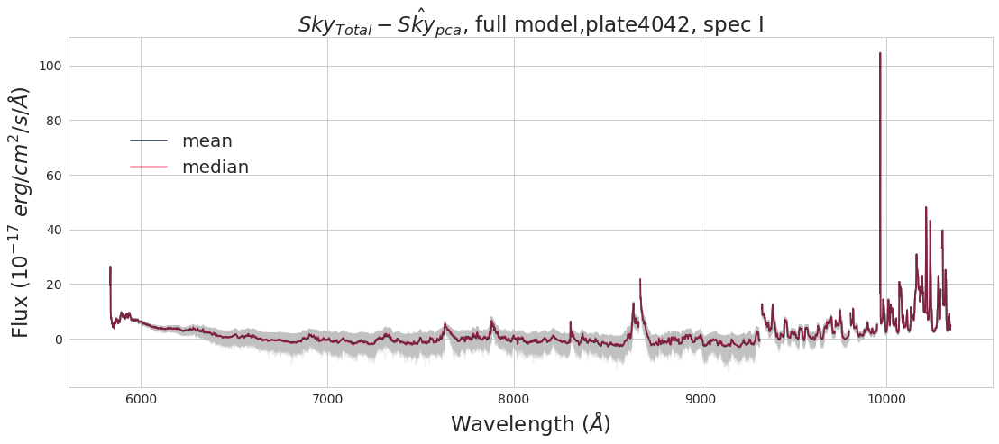

In [1228]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)

#Standard PCA result compared to total flux
plate4042_pca_full_Totalres = plate4042_spec1_sky_total_flux - plate4042_standard_pca_sky_full

for flux in plate4042_pca_full_Totalres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_pca_full_Totalres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_pca_full_Totalres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate4042, spec I",fontsize=23)


ax.legend(loc=[0.06,0.58],fontsize=20);

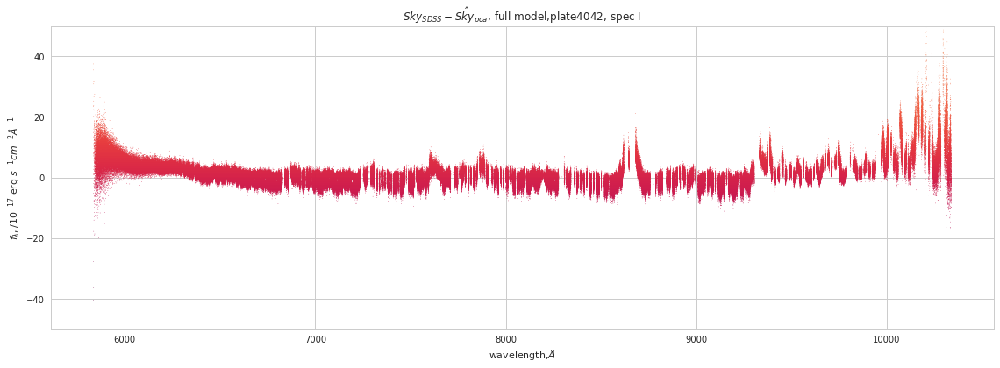

In [1232]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_sdss_sky - plate4042_standard_pca_sky_full

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-50,50)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

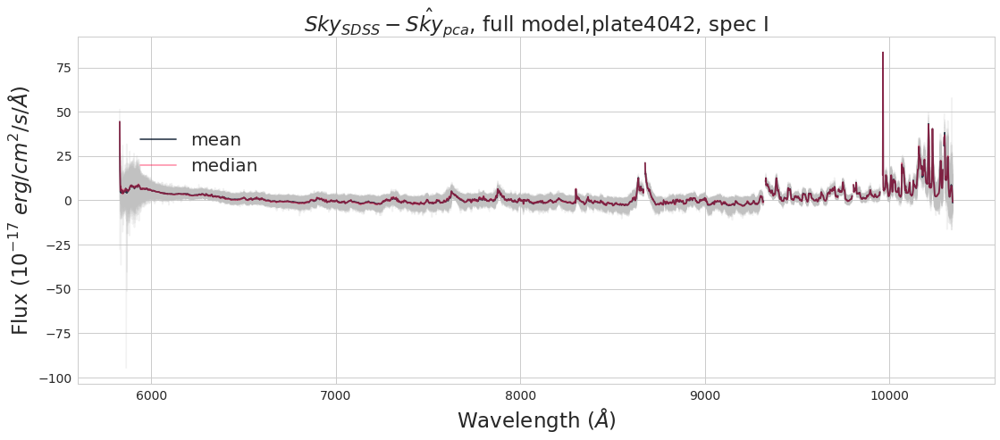

In [1254]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, full model,plate4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_pca_full_SDSSres = plate4042_spec1_sky_sdss_sky - plate4042_standard_pca_sky_full

for flux in plate4042_pca_full_SDSSres:
    ax.plot(plate4042_spec1_sky_wavelength[3],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[3],np.nanmean(plate4042_pca_full_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[3],np.nanmedian(plate4042_pca_full_SDSSres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');

ax.legend(loc=[0.06,0.58],fontsize=20);

Plate 4042, 128 components

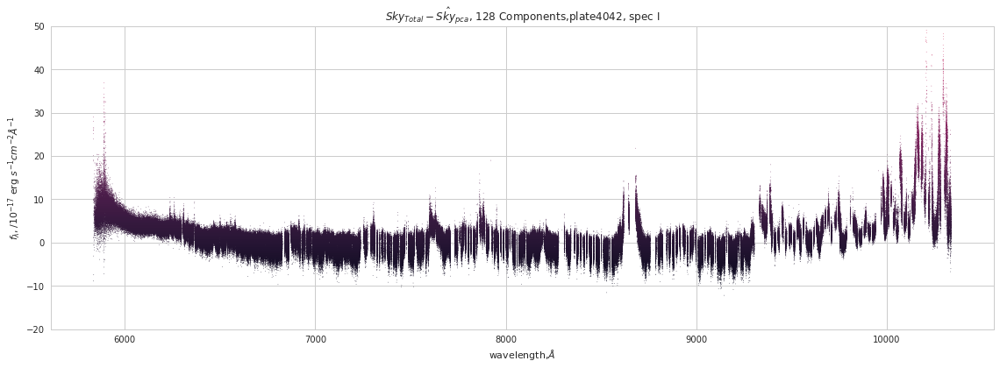

In [1083]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_total_flux - plate4042_standard_pca_sky

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20,50)
plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, 128 Components,plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

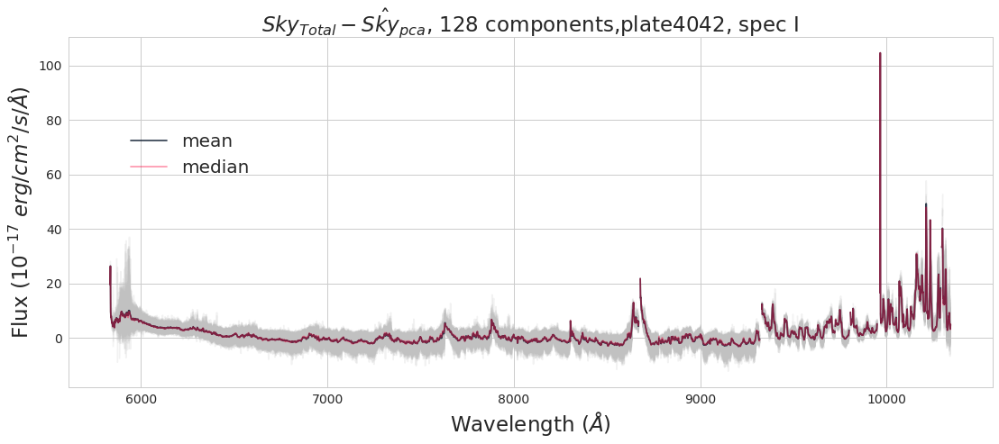

In [1239]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)

#Standard PCA result compared to total flux
plate4042_pca_128_Totalres = plate4042_spec1_sky_total_flux - plate4042_standard_pca_sky

for flux in plate4042_pca_128_Totalres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_pca_128_Totalres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_pca_128_Totalres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$, 128 components,plate4042, spec I",fontsize=23)


ax.legend(loc=[0.06,0.58],fontsize=20);

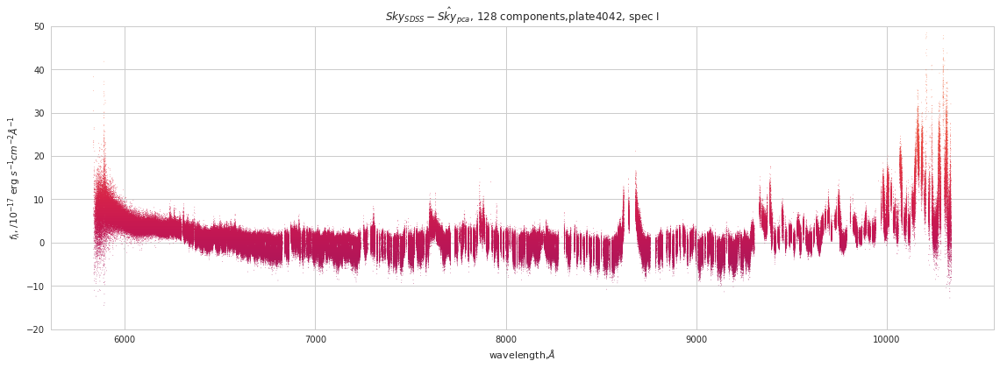

In [1081]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_sdss_sky - plate4042_standard_pca_sky

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20,50)
plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 128 components,plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

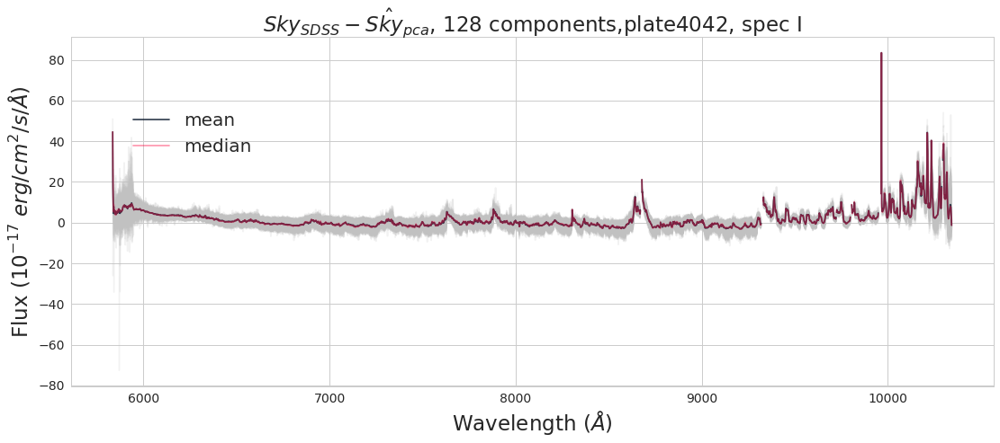

In [1256]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)

#Standard PCA result compared to total flux
plate4042_pca_128_SDSSres = plate4042_spec1_sky_sdss_sky - plate4042_standard_pca_sky

for flux in plate4042_pca_128_SDSSres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_pca_128_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_pca_128_SDSSres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 128 components,plate4042, spec I",fontsize=23)


ax.legend(loc=[0.06,0.64],fontsize=20);

In [1036]:
plate4042_pca_galaxy_amplitudes0.shape

(335,)

#### Plate 3587

In [858]:
plate3587_sky_pca = pca_model(plate3587_spec1_all_sky, plate3587_spec1_all_sky, ncomp=194)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


194 components explain 90.13243986992165 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 3142 results
  r = func(a, **kwargs)


In [859]:
plate3587_QSO_pca = pca_model(plate3587_spec1_all_sky, plate3587_spec1_all_QSO, ncomp=194)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


194 components explain 90.12612267397344 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 3153 results
  r = func(a, **kwargs)


In [876]:
plate3587_galaxy_pca = pca_model(plate3587_spec1_all_sky, plate3587_spec1_all_galaxy, ncomp=194)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


194 components explain 90.12067491421476 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 3155 results
  r = func(a, **kwargs)


In [877]:
plate3587_Fstar_pca = pca_model(plate3587_spec1_all_sky, plate3587_spec1_all_Fstar, ncomp=194)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


194 components explain 90.11386458296329 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 1773 results
  r = func(a, **kwargs)


In [1084]:
plate3587_standard_pca_sky.shape

(300, 4128)

In [1085]:
plate3587_standard_pca_sky = pca_sky(plate3587_spec1_all_sky, ncomp=194)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


194 components explain 90.12659032596275 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


In [1093]:
plate3587_standard_pca_sky_full = pca_sky(plate3587_spec1_all_sky, ncomp=300)

300 components explain 99.99999689753186 % of variation


/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)


Plate3587 Full model sky reconstruction

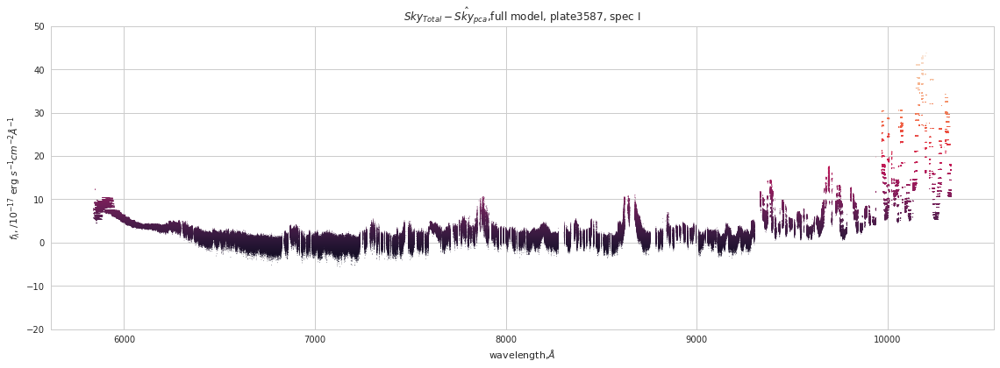

In [1095]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_total_flux - plate3587_standard_pca_sky_full

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20,50)
plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$,full model, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

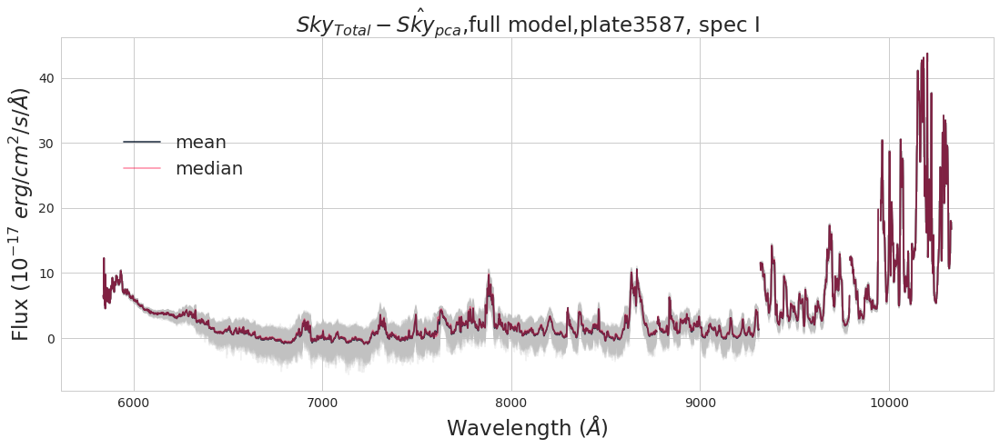

In [1249]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$,full model,plate3587, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate3587_pca_full_Totalres = plate3587_spec1_sky_total_flux - plate3587_standard_pca_sky_full

for flux in plate3587_pca_full_Totalres:
    ax.plot(plate3587_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate3587_spec1_sky_wavelength[0,:],np.nanmean(plate3587_pca_full_Totalres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate3587_spec1_sky_wavelength[0,:],np.nanmedian(plate3587_pca_full_Totalres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

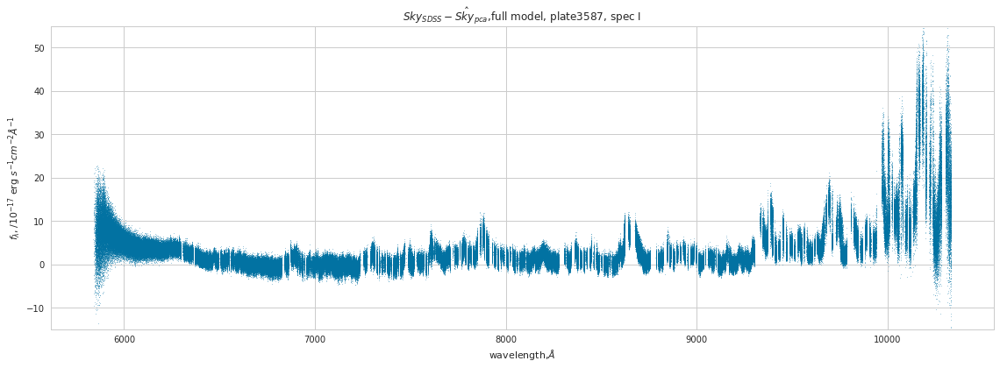

In [1096]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_sdss_sky - plate3587_standard_pca_sky_full

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c='b')
plt.ylim(-15,55)
plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$,full model, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

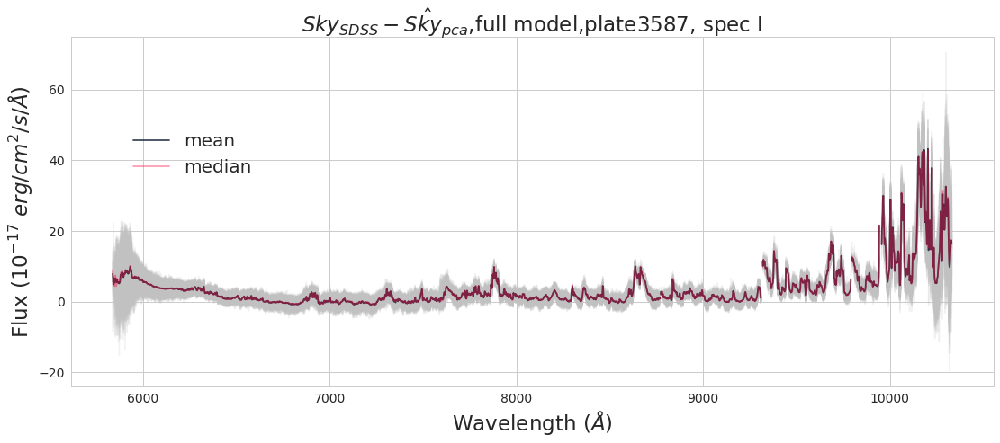

In [1250]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$,full model,plate3587, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate3587_pca_full_SDSSres = plate3587_spec1_sky_sdss_sky - plate3587_standard_pca_sky_full

for flux in plate3587_pca_full_SDSSres:
    ax.plot(plate3587_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate3587_spec1_sky_wavelength[0,:],np.nanmean(plate3587_pca_full_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate3587_spec1_sky_wavelength[0,:],np.nanmedian(plate3587_pca_full_SDSSres,axis=0),'-',color='#fe003a',alpha=0.4,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

Plate 3587, 194 components, sky reconstruction.

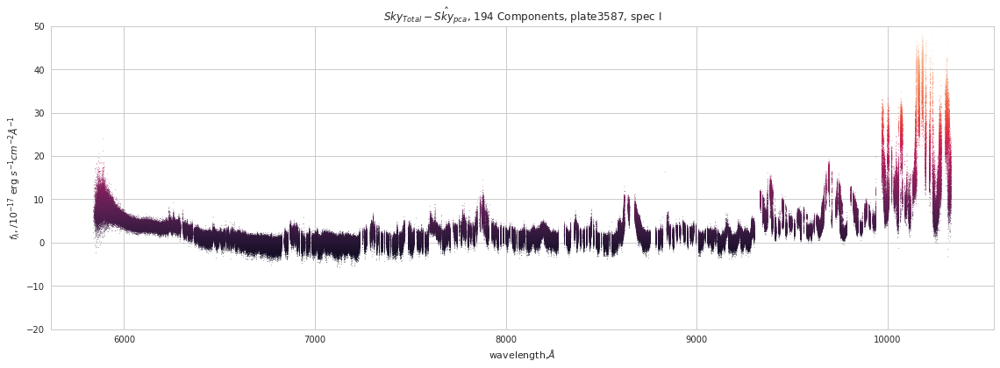

In [1087]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_total_flux - plate3587_standard_pca_sky

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20,50)
plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, 194 Components, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

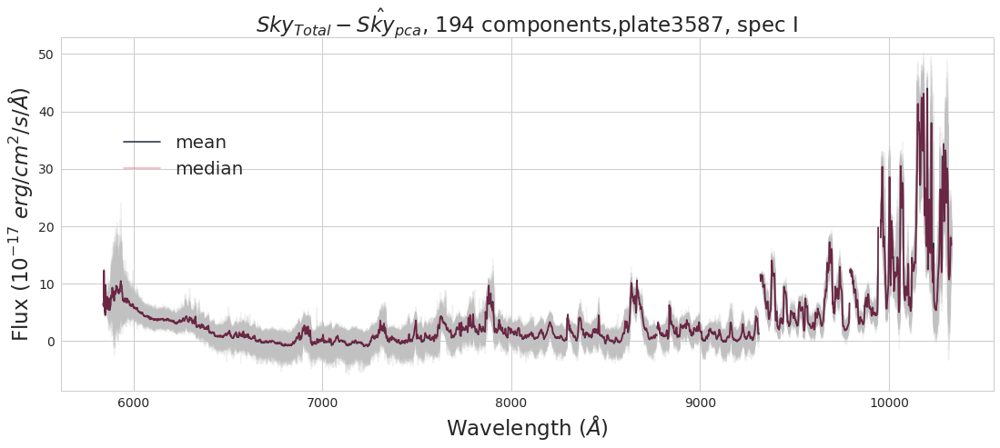

In [1245]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{Total} - \hat{Sky}_{pca}$, 194 components,plate3587, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate3587_pca_194_Totalres = plate3587_spec1_sky_total_flux - plate3587_standard_pca_sky

for flux in plate3587_pca_194_Totalres:
    ax.plot(plate3587_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate3587_spec1_sky_wavelength[0,:],np.nanmean(plate3587_pca_194_Totalres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate3587_spec1_sky_wavelength[0,:],np.nanmedian(plate3587_pca_194_Totalres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

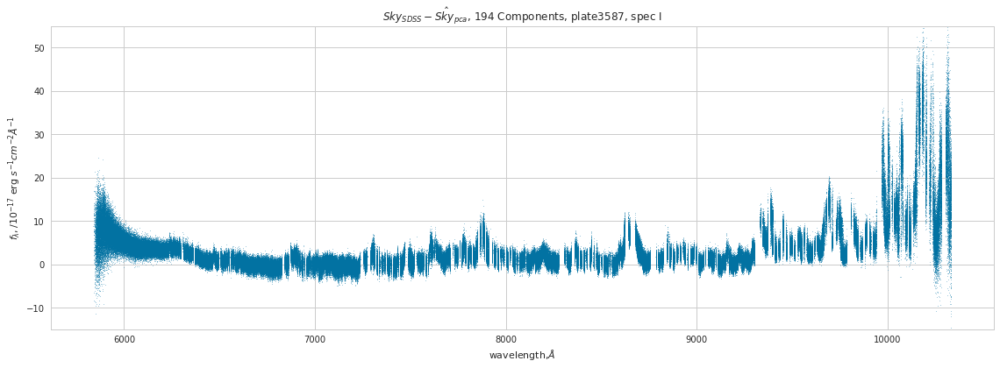

In [1092]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_sdss_sky - plate3587_standard_pca_sky

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c='b')
plt.ylim(-15,55)
plt.title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 194 Components, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

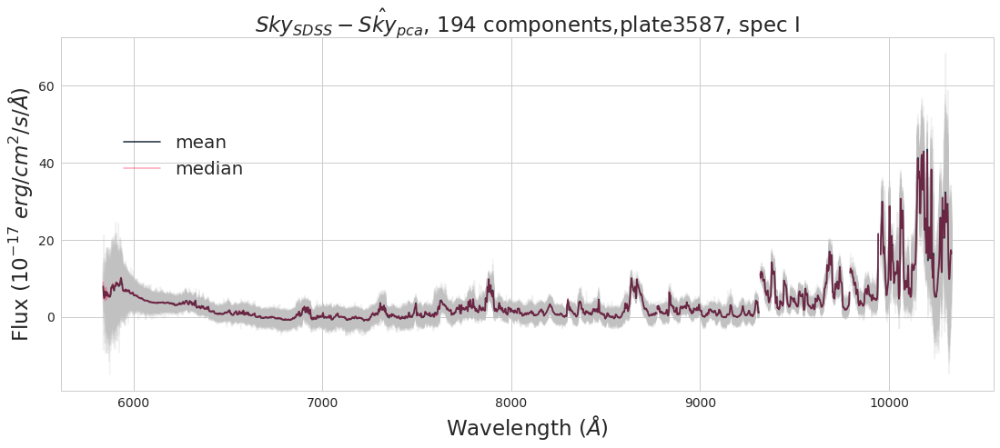

In [1251]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{pca}$, 194 components,plate3587, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate3587_pca_194_SDSSres = plate3587_spec1_sky_sdss_sky - plate3587_standard_pca_sky

for flux in plate3587_pca_194_SDSSres:
    ax.plot(plate3587_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate3587_spec1_sky_wavelength[0,:],np.nanmean(plate3587_pca_194_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate3587_spec1_sky_wavelength[0,:],np.nanmedian(plate3587_pca_194_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

## Weighted PCA

WPCA estimated Sky
Weighted PCA is performed on weighted mean subtracted data.

In [1987]:
from wpca import WPCA
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler

def wpca_model(sky_data, object_data, ncomp):
    '''Compute the weighted pca modeled sky signal.
    
    Parameters
    -------------
    sky_flux: Masked array of valid data from sky fibers to produce the pca model
    object_flux: Masked array of valid data from taget object fibers to project the pca result
    weights: 
    ncomp: number of principal components to keep
    
    Return
    --------
    
    '''
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_residuals)
    scaler_variance = scaler_sky.var_
    
    weights = sky_weights_filled*scaler_variance
    
    if weights is None:
        kwds = {}
    else:
        kwds = {'weights': weights}
        
    wpca_sky = WPCA(n_components = ncomp).fit(standardized_sky, **kwds)
    
    #variance_sum = 0
    #for n in range(ncomp):
    #    variance_sum = variance_sum + wpca_sky.explained_variance_ratio_[n]
    #print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    #reduced_sky = pca_sky.fit_transform(standardized_sky)
    eigenvectors = wpca_sky.components_
    
    #Extract information from input object data
    object_sdss_flux = object_data['flux']
    object_sdss_sky = object_data['sky']
    object_total_flux = np.ma.array(object_sdss_flux.data+object_sdss_sky.data,
                                mask=list(map(op.and_,object_sdss_flux.mask,object_sdss_sky.mask)))

    object_iv = object_data['ivar']
    object_weights_M = np.ma.median(object_iv, axis=0)
    object_weights_filled = np.ma.filled(object_iv, fill_value=object_weights_M)
    
    #weighted average of object fibers
    object_wa= np.ma.average(object_total_flux, axis=0,weights=object_weights_filled, returned=False)
    object_wa_resized = np.tile(object_wa, (object_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    object_wa_residuals = np.ma.array(object_total_flux.data - object_wa_resized.data,
                                  mask=list(map(op.and_, object_total_flux.mask,object_wa_resized.mask)))
    
    #normalized object signal subtracted by weighted average and weighted by noise
    object_wa_normalized = np.ma.array(object_wa_residuals*(object_iv.data**0.5),
                                      mask = list(map(op.and_, object_wa_residuals.mask,object_iv.mask)))
    
    object_wa_normalized_M = np.ma.median(object_wa_normalized, axis=0)
    object_wa_normalized_filled = np.ma.filled(object_wa_normalized, fill_value=object_wa_normalized_M)
    
    #Principal coomponent amplitude of target object flux
    amplitudes = np.dot(object_wa_normalized_filled, eigenvectors.T)
    projection_wa_normalized = np.dot(amplitudes[:],eigenvectors[:])
    
    #Reverse normalization to original data dimension
    projection_standardized = projection_wa_normalized*(object_iv**(-0.5)) + object_weights_filled
    
    projection = scaler_sky.inverse_transform(projection_standardized)
    
    #weighted average and weights of projection result
    projection_wa= np.tile(sky_wa, (projection.shape[0],1))
    
    modeled_sky = projection + projection_wa
    
    return modeled_sky

In [1988]:
QSO_wpca = wpca_model(plate4042_spec1_all_sky,plate4042_spec1_all_QSO,ncomp=45)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2931 results
  r = func(a, **kwargs)


In [707]:
galaxy_wpca = wpca_model(plate4042_spec1_all_sky,plate4042_spec1_all_galaxy, ncomp=45)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 3139 results
  r = func(a, **kwargs)


In [2048]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler
from wpca import WPCA

def wpca_sky(sky_data,ncomp):
    '''Compute the pca modeled sky information
    
    Parameters
    -------------
    sky_flux: Masked array of valid data from sky fibers to produce the pca model
    ncomp: number of principal components to keep
    
    Return
    --------
    
    '''
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_residuals)
    standardized_weights = scaler_sky.transform(sky_weights_filled)
    
    # Weighted PCA
    wpca_sky = WPCA(n_components = ncomp).fit(standardized_sky, standardized_weights)
    
    eigenvectors = wpca_sky.components_
    
    variance_sum = 0
    for n in range(ncomp):
        variance_sum = variance_sum + wpca_sky.explained_variance_ratio_[n]
    print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    #reduced_sky = wpca_sky.fit_transform(standardized_sky, **kwds)
    
    #Reconstruction of input sky information 
    projection_standardized = WPCA(n_components = ncomp).fit_reconstruct(standardized_sky, standardized_weights)
    
    #Reverse standardization
    projection = scaler_sky.inverse_transform(projection_standardized)
    
    #Reverse normalization to original data dimension
    modeled_sky = projection + sky_wa_resized

    return modeled_sky

##### Plate 5298 WPCA Sky Reconstruction

In [2044]:
plate5298_wpca_sky_196 = wpca_sky(plate5298_spec1_all_sky,ncomp=196)

196 components explain 100.00000815392411 % of variation


In [2045]:
plate5298_wpca_sky_196.shape

(196, 4128)

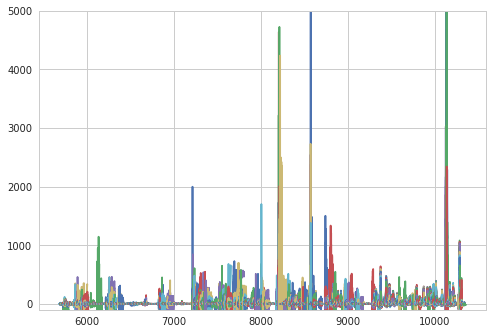

In [2047]:
x = plate5298_spec1_sky_wavelength
y = plate5298_wpca_sky_196
plt.plot(x,y)
plt.ylim(-100,5000)

plt.show()

##### Plate 5298 WPCA QSO Projection

In [1540]:
plate5298_spec1_all_QSO.shape

(332, 4128)

In [1541]:
plate5298_wpca_projected_QSO_196 = wpca_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,ncomp=196)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


In [1542]:
plate5298_wpca_projected_QSO_196.shape

(332, 4128)

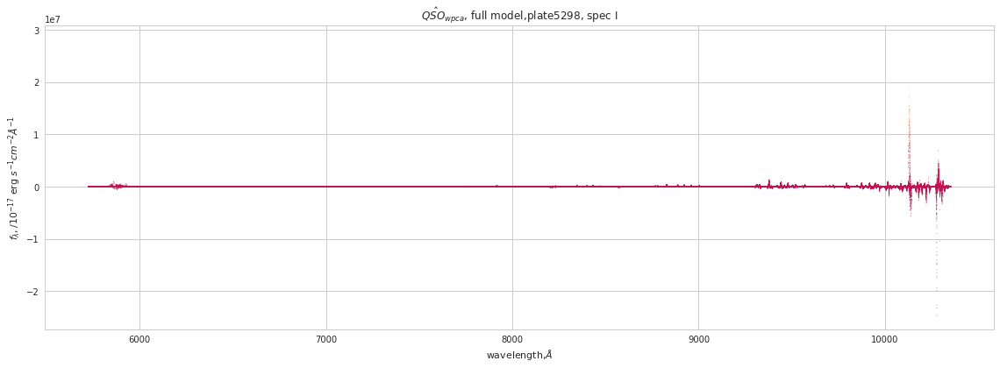

In [1590]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_wpca_projected_QSO_196
plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)


plt.title("$\hat{QSO}_{wpca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

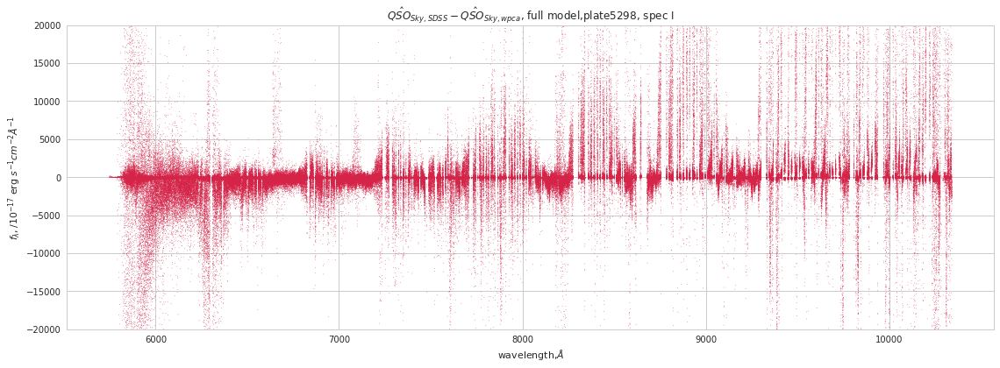

In [1545]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_spec1_QSO_sdss_sky - plate5298_wpca_projected_QSO_196

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20000,20000)
plt.title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,wpca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


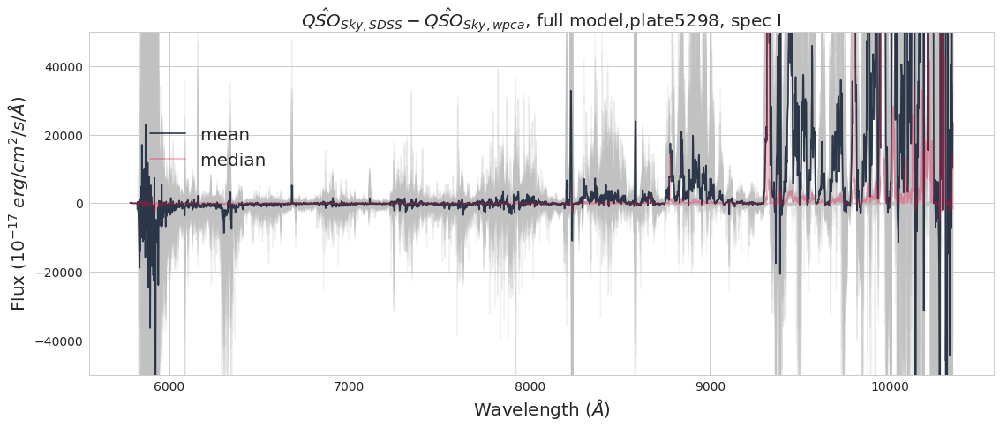

In [1548]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_pca_projected_QSO_196_SDSSres =plate5298_spec1_QSO_sdss_sky - plate5298_wpca_projected_QSO_196

for flux in plate5298_pca_projected_QSO_196_SDSSres:
    ax.plot(plate5298_spec1_QSO_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmean(plate5298_pca_projected_QSO_196_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmedian(plate5298_pca_projected_QSO_196_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,wpca}$, full model,plate5298, spec I",fontsize=20)
ax.set_ylim(-50000,50000)
ax.legend(loc=[0.06,0.58],fontsize=20);

In [1272]:
plate4042_weighted_pca_sky_10 = wpca_sky(plate4042_spec1_all_sky,ncomp=10)

10 components explain 84.91556224108906 % of variation


In [1104]:
plate4042_weighted_pca_sky_full = wpca_sky(plate4042_spec1_all_sky,ncomp=235)

235 components explain 105.17617178493934 % of variation


In [1263]:
plate4042_weighted_pca_sky_128 = wpca_sky(plate4042_spec1_all_sky,ncomp=128)

128 components explain 101.61189937726914 % of variation


In [1170]:
plate3587_weighted_pca_sky_full = wpca_sky(plate3587_spec1_all_sky,ncomp=300)cv

300 components explain 103.45898323681185 % of variation


In [1177]:
plate3587_weighted_pca_sky_194= wpca_sky(plate3587_spec1_all_sky,ncomp=194)

194 components explain 100.0520047087111 % of variation


In [1180]:
plate3587_weighted_pca_sky_10= wpca_sky(plate3587_spec1_all_sky,ncomp=10)

10 components explain 67.48816490609104 % of variation


WPCA, Plate4042, Full Model, 235 components

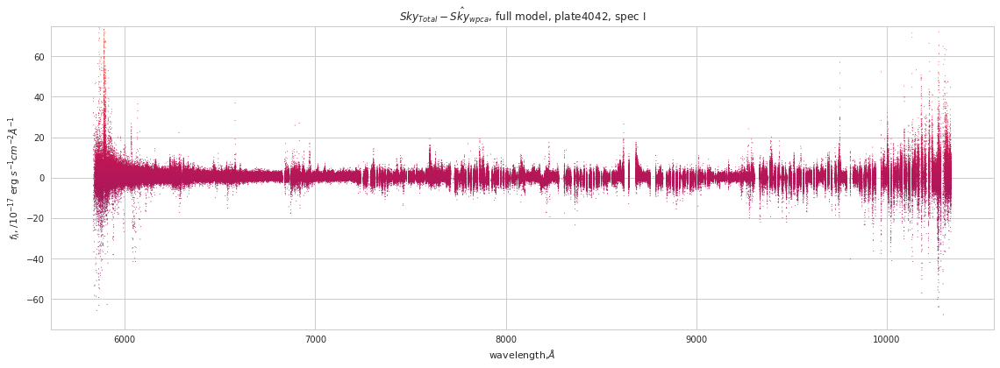

In [1111]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_total_flux - plate4042_weighted_pca_sky_full 

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-75,75)

plt.title("${Sky}_{Total} - \hat{Sky}_{wpca}$, full model, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: All-NaN slice encountered
  r = func(a, **kwargs)


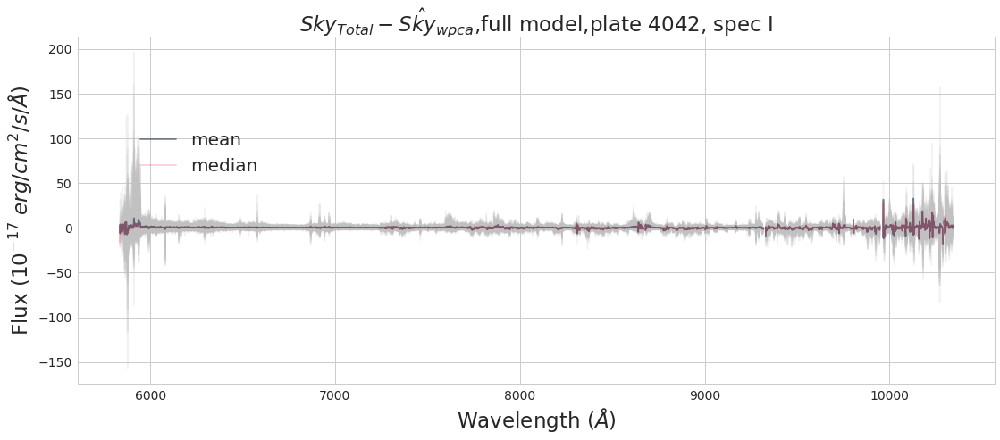

In [1273]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{Total} - \hat{Sky}_{wpca}$,full model,plate 4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_wpca_full_Totalres = plate4042_spec1_sky_total_flux - plate4042_weighted_pca_sky_full

for flux in plate4042_wpca_full_Totalres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_wpca_full_Totalres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_wpca_full_Totalres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

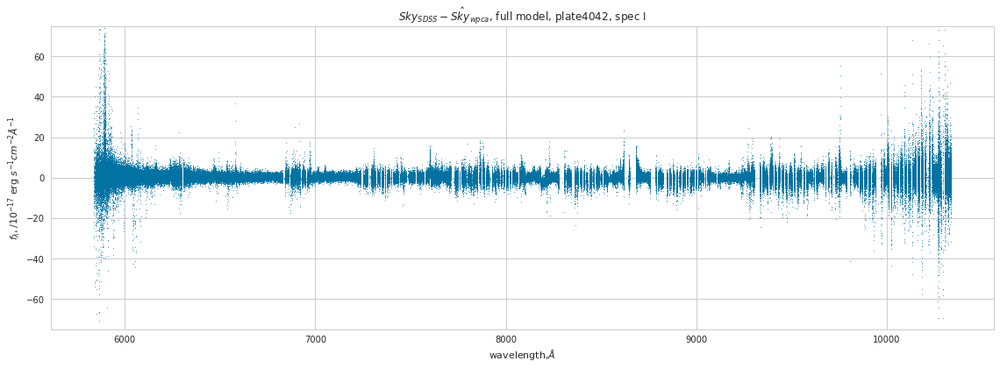

In [1115]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_sdss_sky - plate4042_weighted_pca_sky_full

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c='b')
plt.ylim(-75,75)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$, full model, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

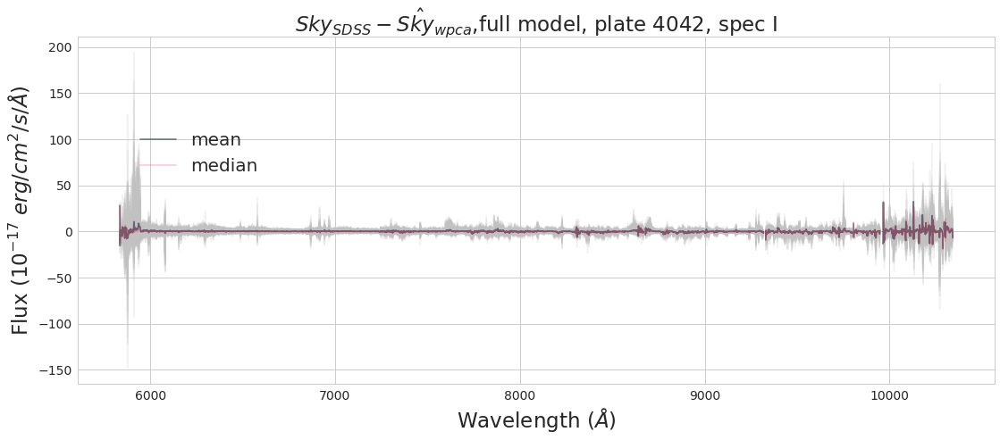

In [1287]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,full model, plate 4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_wpca_full_SDSSres = plate4042_spec1_sky_sdss_sky - plate4042_weighted_pca_sky_full

for flux in plate4042_wpca_full_SDSSres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_wpca_full_SDSSres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_wpca_full_SDSSres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

WPCA, Plate 4042, 128 components

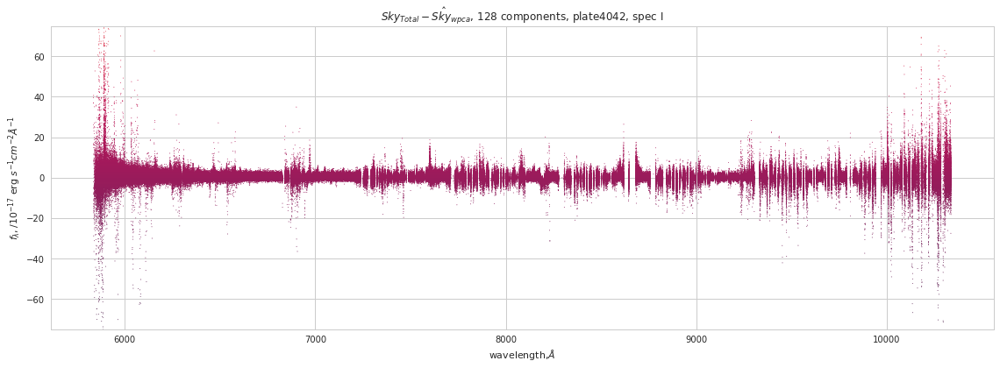

In [1264]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_total_flux - plate4042_weighted_pca_sky_128 

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-75,75)

plt.title("${Sky}_{Total} - \hat{Sky}_{wpca}$, 128 components, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

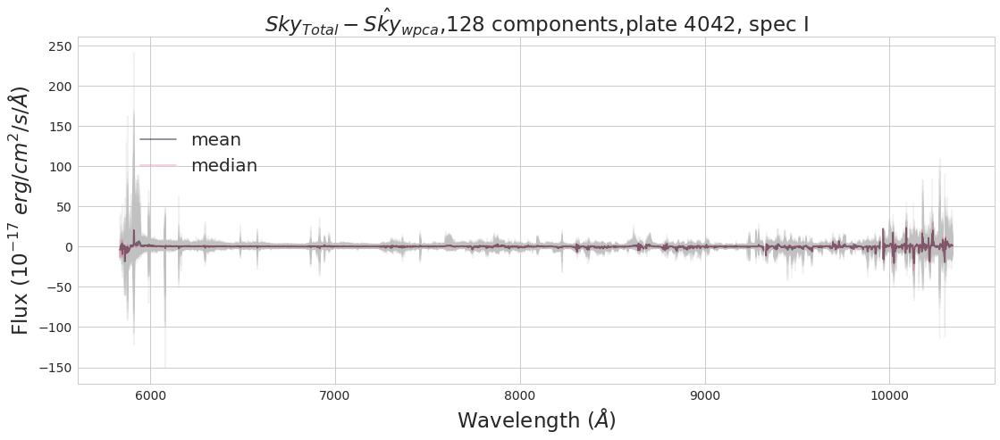

In [1275]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{Total} - \hat{Sky}_{wpca}$,128 components,plate 4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_wpca_128_Totalres = plate4042_spec1_sky_total_flux - plate4042_weighted_pca_sky_128

for flux in plate4042_wpca_128_Totalres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_wpca_128_Totalres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_wpca_128_Totalres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

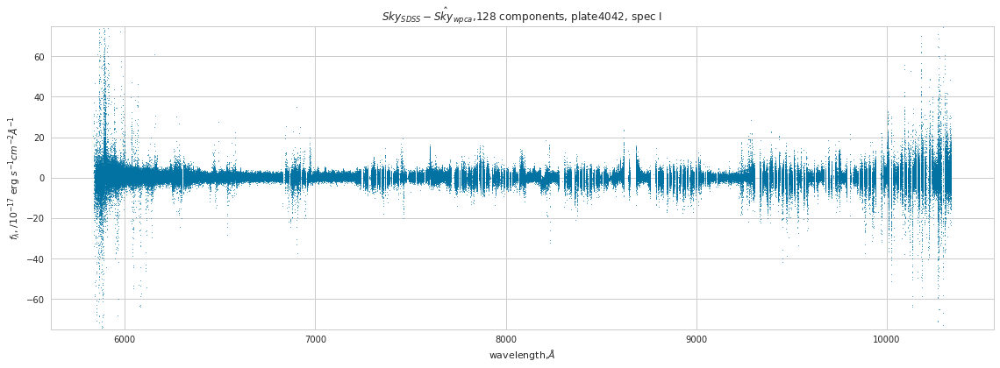

In [1266]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_sdss_sky - plate4042_weighted_pca_sky_128

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c='b')
plt.ylim(-75,75)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,128 components, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

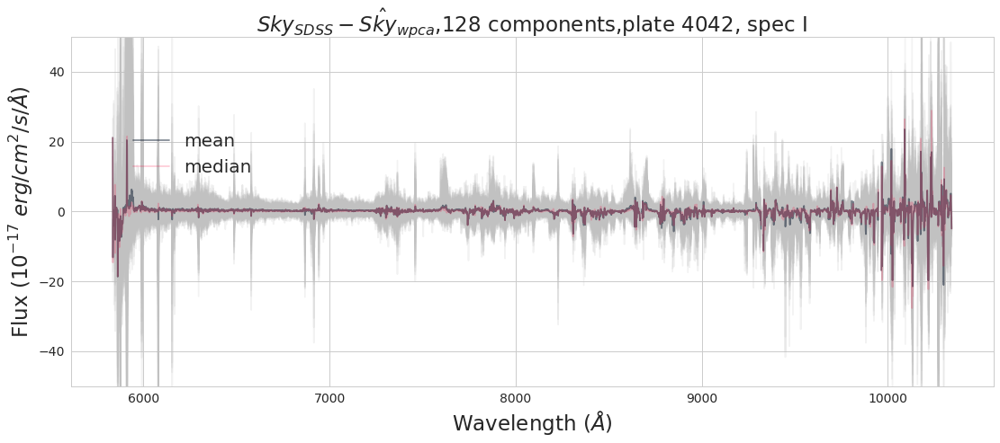

In [1286]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,128 components,plate 4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_wpca_128_SDSSres = plate4042_spec1_sky_sdss_sky - plate4042_weighted_pca_sky_128

for flux in plate4042_wpca_128_SDSSres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_wpca_128_SDSSres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_wpca_128_SDSSres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');
ax.set_ylim(-50,50)


ax.legend(loc=[0.06,0.58],fontsize=20);

WPCA, Plate4042, 10 components

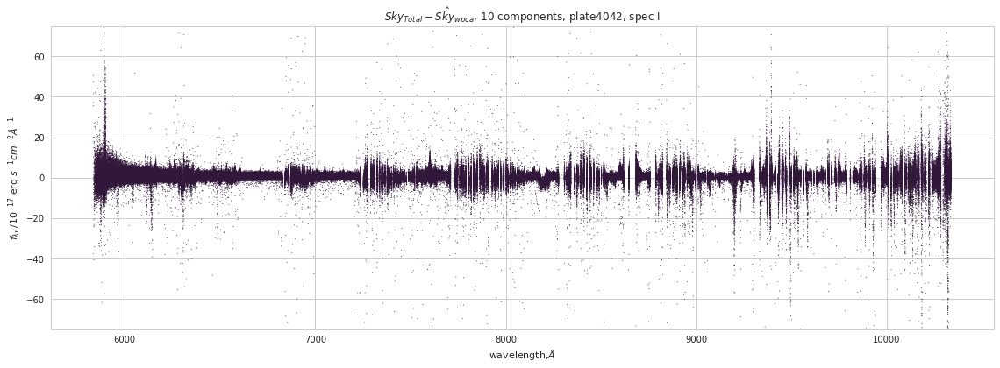

In [1167]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_total_flux - plate4042_weighted_pca_sky10 

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-75,75)

plt.title("${Sky}_{Total} - \hat{Sky}_{wpca}$, 10 components, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

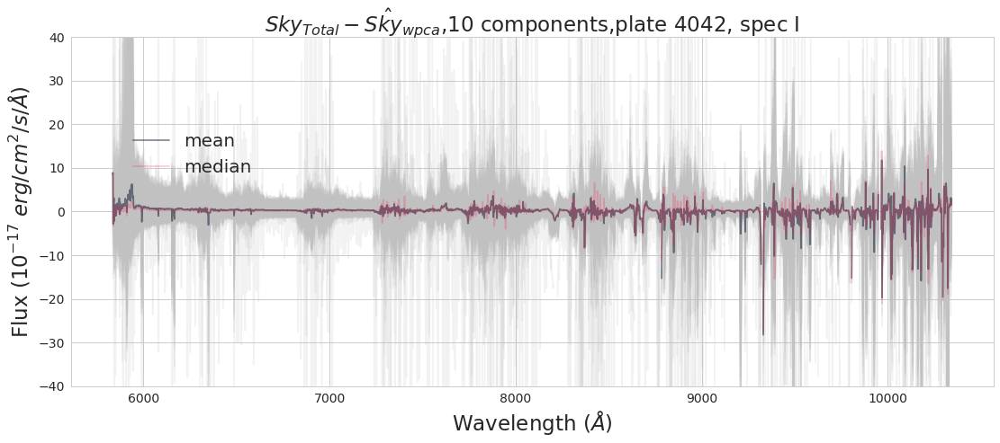

In [1285]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{Total} - \hat{Sky}_{wpca}$,10 components,plate 4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_wpca_10_Totalres = plate4042_spec1_sky_total_flux - plate4042_weighted_pca_sky_10

for flux in plate4042_wpca_10_Totalres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_wpca_10_Totalres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_wpca_10_Totalres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');
ax.set_ylim(-40,40)


ax.legend(loc=[0.06,0.58],fontsize=20);

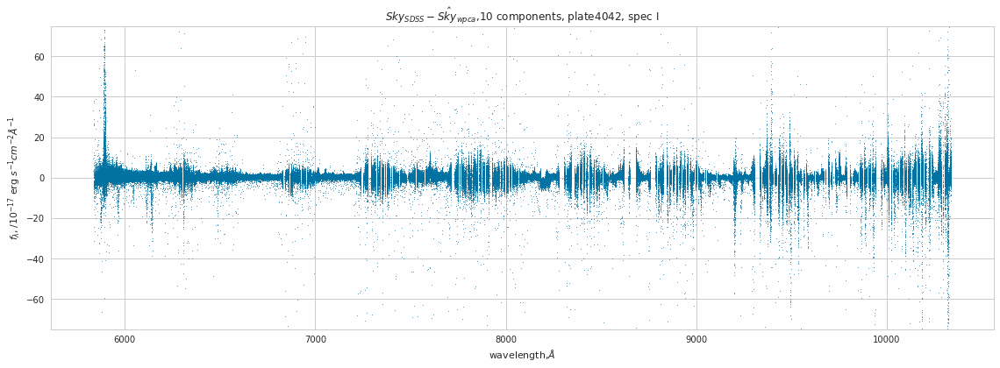

In [1166]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_sdss_sky - plate4042_weighted_pca_sky10

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c='b')
plt.ylim(-75,75)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,10 components, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

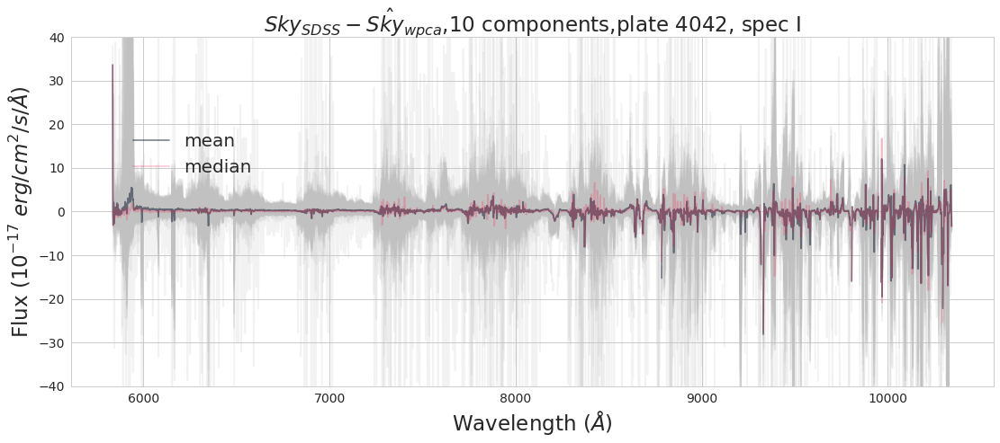

In [1284]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,10 components,plate 4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_wpca_10_SDSSres = plate4042_spec1_sky_sdss_sky - plate4042_weighted_pca_sky_10

for flux in plate4042_wpca_10_SDSSres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_wpca_10_SDSSres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_wpca_10_SDSSres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');
ax.set_ylim(-40,40)


ax.legend(loc=[0.06,0.58],fontsize=20);

Plate 3587

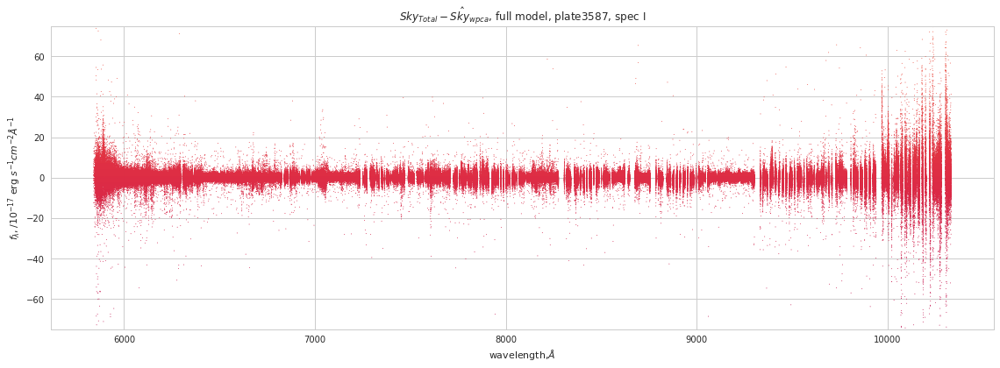

In [1174]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_total_flux - plate3587_weighted_pca_sky_full 

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-75,75)

plt.title("${Sky}_{Total} - \hat{Sky}_{wpca}$, full model, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

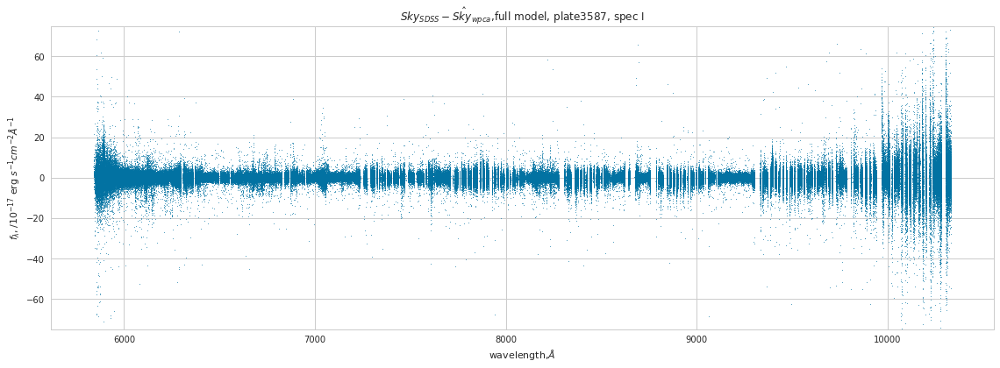

In [1176]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_sdss_sky - plate3587_weighted_pca_sky_full

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c='b')
plt.ylim(-75,75)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,full model, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

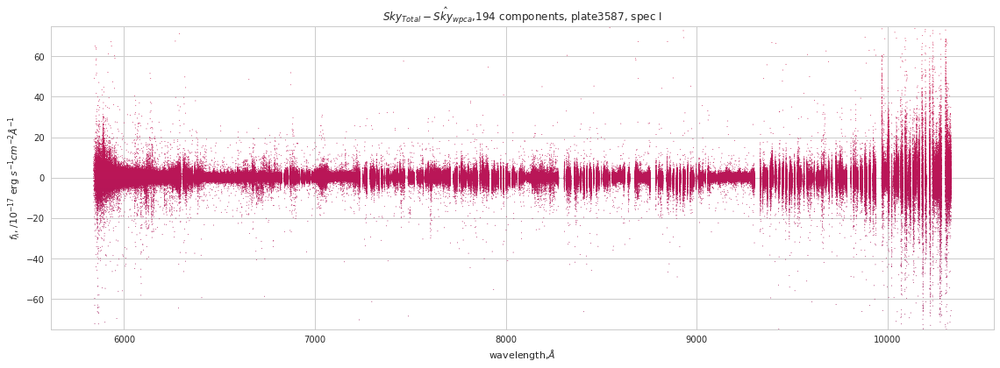

In [1178]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_total_flux - plate3587_weighted_pca_sky_194

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-75,75)

plt.title("${Sky}_{Total} - \hat{Sky}_{wpca}$,194 components, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

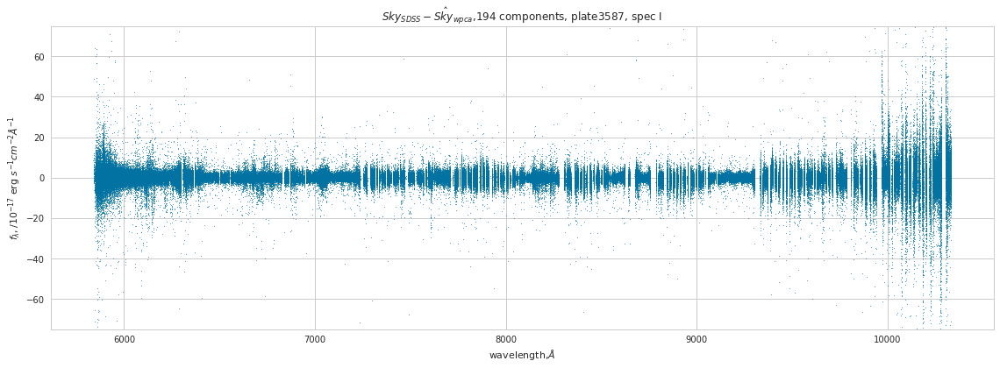

In [1179]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_sdss_sky - plate3587_weighted_pca_sky_194

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c='b')
plt.ylim(-75,75)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,194 components, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

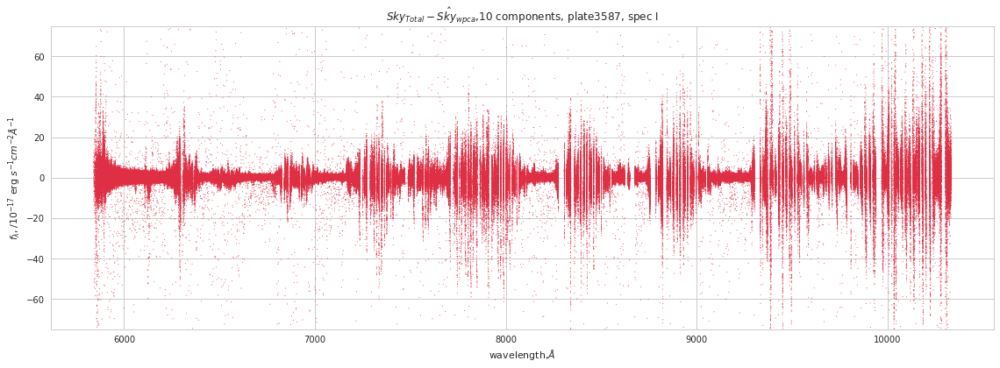

In [1181]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_total_flux - plate3587_weighted_pca_sky_10

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-75,75)

plt.title("${Sky}_{Total} - \hat{Sky}_{wpca}$,10 components, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

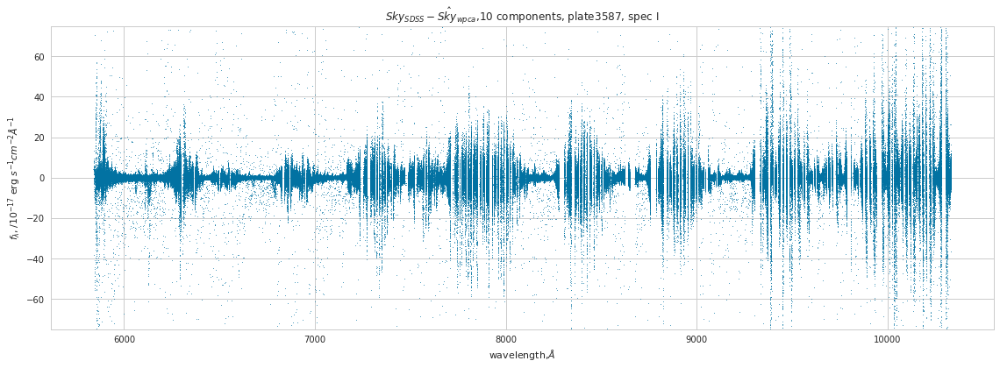

In [1182]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_sdss_sky - plate3587_weighted_pca_sky_10

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c='b')
plt.ylim(-75,75)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,10 components, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

### Robust PCA estimated Sky

In [1549]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler
from tga import TGA

def tga_model(sky_data, object_data, ncomp, random_n):
    "Compute the Robust PCA model sky signal"
    
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_residuals)
    
    

    
    tga_sky =TGA(n_components = ncomp,random_state = random_n)
    tga_sky.fit(standardized_sky)
    
    #variance_sum = 0
    #for n in range(ncomp):
    #    variance_sum = variance_sum + pca_sky.explained_variance_ratio_[n]
    #print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    #reduced_sky = pca_sky.fit_transform(standardized_sky)
    eigenvectors = tga_sky.components_
    
    #Extract information from input object data
    object_sdss_flux = object_data['flux']
    object_sdss_sky = object_data['sky']
    object_total_flux = np.ma.array(object_sdss_flux.data+object_sdss_sky.data,
                                mask=list(map(op.and_,object_sdss_flux.mask,object_sdss_sky.mask)))

    object_iv = object_data['ivar']
    object_weights_M = np.ma.median(object_iv, axis=0)
    object_weights_filled = np.ma.filled(object_iv, fill_value=object_weights_M)
    
    #weighted average of object fibers
    object_wa= np.ma.average(object_total_flux, axis=0,weights=object_weights_filled, returned=False)
    object_wa_resized = np.tile(object_wa, (object_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    object_wa_residuals = np.ma.array(object_total_flux.data - object_wa_resized.data,
                                  mask=list(map(op.and_, object_total_flux.mask,object_wa_resized.mask)))
    
    #normalized object signal subtracted by weighted average and weighted by noise
    object_wa_normalized = np.ma.array(object_wa_residuals*(object_iv.data**0.5),
                                      mask = list(map(op.and_, object_wa_residuals.mask,object_iv.mask)))
    
    object_wa_normalized_M = np.ma.median(object_wa_normalized, axis=0)
    object_wa_normalized_filled = np.ma.filled(object_wa_normalized, fill_value=object_wa_normalized_M)
    
    #Principal coomponent amplitude of target object flux
    amplitudes = np.dot(object_wa_normalized_filled, eigenvectors.T)
    projection_wa_normalized = np.dot(amplitudes[:],eigenvectors[:])
    
    #Reverse normalization to original data dimension
    projection_standardized = projection_wa_normalized*(object_iv**(-0.5)) + object_weights_filled
    
    projection = scaler_sky.inverse_transform(projection_standardized)
    
    #weighted average and weights of projection result
    projection_wa= np.tile(sky_wa, (projection.shape[0],1))
    
    modeled_sky = projection + projection_wa
    
    return modeled_sky

TGA Model to project Sky signals from Sky fibers.

In [2078]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler
from tga import TGA

def tga_model(sky_data, object_data, ncomp, random_n):
    "Compute the Robust PCA model sky signal"
    
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #normalized sky signal subtracted by weighted average and weighted by noise
    
    sky_wa_normalized = sky_wa_residuals*(sky_iv**0.5)
    sky_wa_normalized_M = np.ma.median(sky_wa_normalized, axis=0)
    sky_wa_normalized_filled = np.ma.filled(np.ma.filled(sky_wa_normalized, fill_value=sky_wa_normalized_M),fill_value=0)
    
    #Standardization of sky input signal to prepare for Robust PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_normalized_filled)
    
    #Trimmed Grassmann Average as robust PCA
    tga_sky =TGA(n_components = ncomp,random_state = random_n)
    tga_sky.fit(standardized_sky)
    
    eigenvectors = tga_sky.components_
    
    #Extract information from input object data
    object_sdss_flux = object_data['flux']
    object_sdss_sky = object_data['sky']
    object_total_flux = np.ma.array(object_sdss_flux.data+object_sdss_sky.data,
                                mask=list(map(op.and_,object_sdss_flux.mask,object_sdss_sky.mask)))

    object_iv = object_data['ivar']
    object_weights_M = np.ma.median(object_iv, axis=0)
    object_weights_filled = np.ma.filled(object_iv, fill_value=object_weights_M)
    
    #weighted average of object fibers
    object_wa= np.ma.average(object_total_flux, axis=0,weights=object_weights_filled, returned=False)
    object_wa_resized = np.tile(object_wa, (object_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    object_wa_residuals = np.ma.array(object_total_flux.data - object_wa_resized.data,
                                  mask=list(map(op.and_, object_total_flux.mask,object_wa_resized.mask)))
    
    #normalized object signal subtracted by weighted average and weighted by noise
    object_wa_normalized = object_wa_residuals*(object_iv.data**0.5)
    object_wa_normalized_M = np.ma.median(object_wa_normalized, axis=0)
    object_wa_normalized_filled = np.ma.filled(np.ma.filled(object_wa_normalized, fill_value=object_wa_normalized_M),fill_value=0)
    
    #Standardization of object input signal to prepare for PCA
    scaler_object = StandardScaler()
    standardized_object = scaler_object.fit_transform(object_wa_normalized_filled)
    
    #Principal coomponent amplitude of target object flux
    reduced_object = np.dot(standardized_object, eigenvectors.T)
    
    #Reverse normalization to original data dimension
    projection_object_standardized = np.dot(reduced_object,eigenvectors)
                                               
    projection= scaler_sky.inverse_transform(projection_object_standardized)
    
    #projection_sky_standardized = projection_wa_normalized*(object_iv**(-0.5)) + object_weights_filled
    
    #projection = scaler_sky.inverse_transform(projection_object_standardized)
    
    #weighted average and weights of projection result
    #projection_wa= np.tile(sky_wa, (projection.shape[0],1))
    #projection_weights = np.tile(np.ma.median(sky_weights_filled,axis=0),(projection.shape[0],1))
    
    projection_wa= np.tile(object_wa, (projection.shape[0],1))
    projection_weights = np.tile(np.ma.median(object_weights_filled,axis=0),(projection.shape[0],1))
    
    modeled_sky = projection * (projection_weights**(-0.5)) + projection_wa
    
    return modeled_sky

In [2079]:
plate5298_tga_projected_sky_20 = tga_model(plate5298_spec1_all_sky,plate5298_spec1_all_sky,20,None)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2722 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


In [2114]:
plate5298_tga_projected_Fstar_20 = tga_model(plate5298_spec1_all_sky,plate5298_spec1_all_Fstar,ncomp=20, random_n=None)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 769 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


In [2125]:
plate5298_tga_projected_galaxy_20 = tga_model(plate5298_spec1_all_sky,plate5298_spec1_all_galaxy,ncomp=20, random_n=None)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 3188 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


In [2126]:
plate5298_tga_projected_QSO_20 = tga_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,ncomp=20, random_n=None)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


In [1942]:
plate5298_tga_projected_sky_20.shape

(196, 4128)

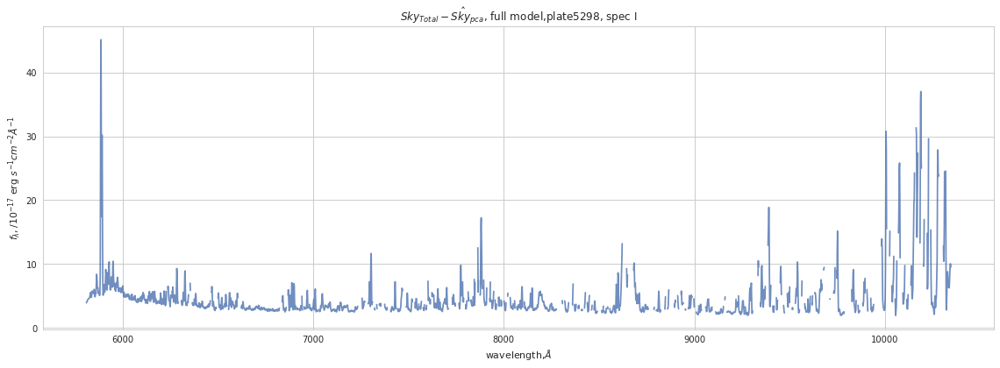

In [2080]:
x = plate5298_spec1_sky_wavelength[84]
y = plate5298_spec1_sdss_sky[84] 


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

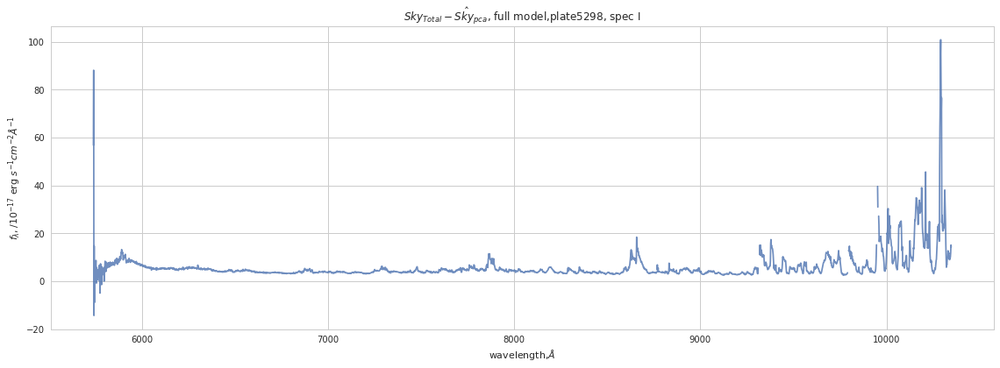

In [2081]:
#modeled sky returned

x = plate5298_spec1_sky_wavelength[84]
y = plate5298_tga_projected_sky_20[84] 


plt.figure(figsize = (16,6))
plt.plot(x,y,'-',alpha=0.8)

plt.title("${Sky}_{Total} - \hat{Sky}_{pca}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

In [1970]:
from sklearn import decomposition
from sklearn.preprocessing import StandardScaler
from tga import TGA

def tga_sky(sky_data, ncomp, random_n):
    "Compute the Robust PCA model sky signal"
    
    #Extract information from input sky data
    sky_sdss_flux = sky_data['flux']
    sky_sdss_sky = sky_data['sky']
    sky_total_flux = np.ma.array(sky_sdss_flux.data+sky_sdss_sky.data,
                                mask=list(map(op.and_,sky_sdss_flux.mask,sky_sdss_sky.mask)))

    sky_iv = sky_data['ivar']
    sky_weights_M = np.ma.median(sky_iv, axis=0)
    sky_weights_filled = np.ma.filled(sky_iv, fill_value=sky_weights_M)
    
    #weighted average of sky fibers
    sky_wa=np.ma.average(sky_total_flux, axis=0,weights=sky_weights_filled, returned=False)
    sky_wa_resized = np.tile(sky_wa, (sky_total_flux.shape[0],1))
    
    #weighted average subtracted total sky flux
    sky_wa_residuals = np.ma.array(sky_total_flux.data - sky_wa_resized.data,
                                  mask=list(map(op.and_, sky_total_flux.mask,sky_wa_resized.mask)))
    
    #normalized sky signal subtracted by weighted average and weighted by noise
    
    sky_wa_normalized = sky_wa_residuals*(sky_iv**0.5)
    
    sky_wa_normalized_M = np.ma.median(sky_wa_normalized, axis=0)
    sky_wa_normalized_filled = np.ma.filled(np.ma.filled(sky_wa_normalized, fill_value=sky_wa_normalized_M),fill_value=0)
    
    
    #Standardization of sky input signal to prepare for PCA
    scaler_sky = StandardScaler()
    standardized_sky = scaler_sky.fit_transform(sky_wa_normalized_filled)
    
    tga_sky = TGA(n_components = ncomp,random_state = random_n)
    tga_sky.fit(standardized_sky)
    
    #variance_sum = 0
    #for n in range(ncomp):
    #    variance_sum = variance_sum + pca_sky.explained_variance_ratio_[n]
    #print(ncomp, "components explain", variance_sum*100, "% of variation")
    
    reduced_sky = tga_sky.fit_transform(standardized_sky)
   
    #Reconstruction of input sky information 
    projection_standardized = tga_sky.inverse_transform(reduced_sky)
    
    #Reverse standardization
    projection= scaler_sky.inverse_transform(projection_standardized)
    #Reverse normalization to original data dimension
    modeled_sky = projection * (sky_iv**(-0.5)) + sky_wa_resized
    
    return modeled_sky

#### Plate 5298 TGA Sky Reconstruction

In [1971]:
plate5298_tga_sky_20= tga_sky(plate5298_spec1_all_sky,20,None)

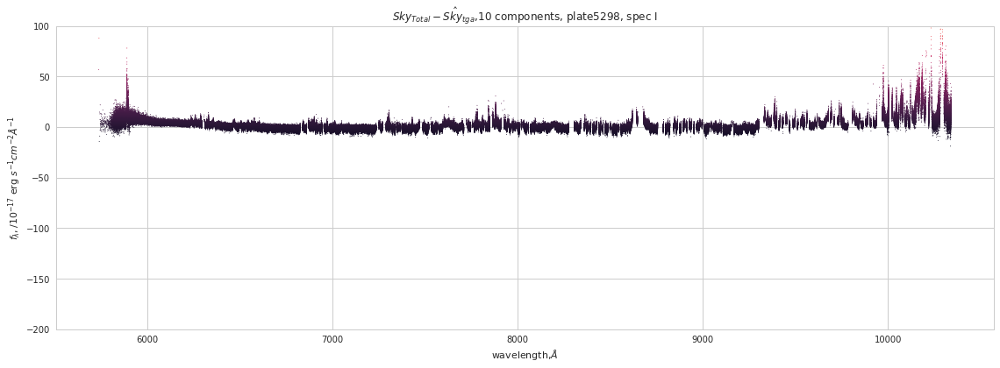

In [1765]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_total_flux - plate5298_tga_sky_20

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-200,100)

plt.title("${Sky}_{Total} - \hat{Sky}_{tga}$,10 components, plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

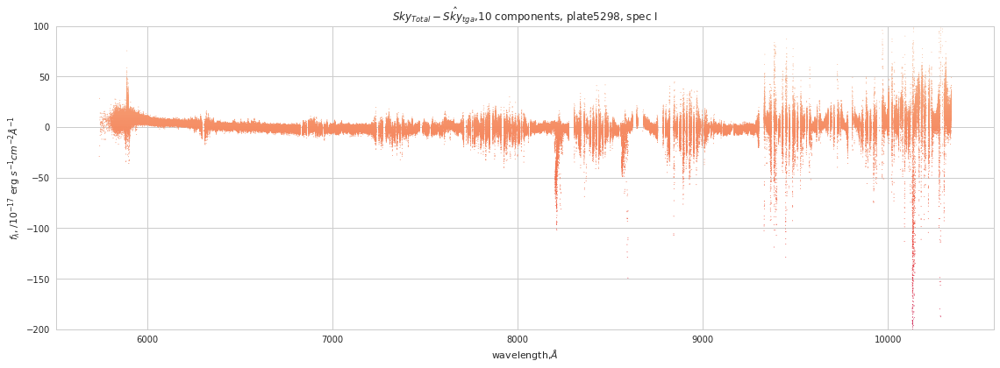

In [1560]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_total_flux - plate5298_tga_sky10

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-200,100)

plt.title("${Sky}_{Total} - \hat{Sky}_{tga}$,10 components, plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

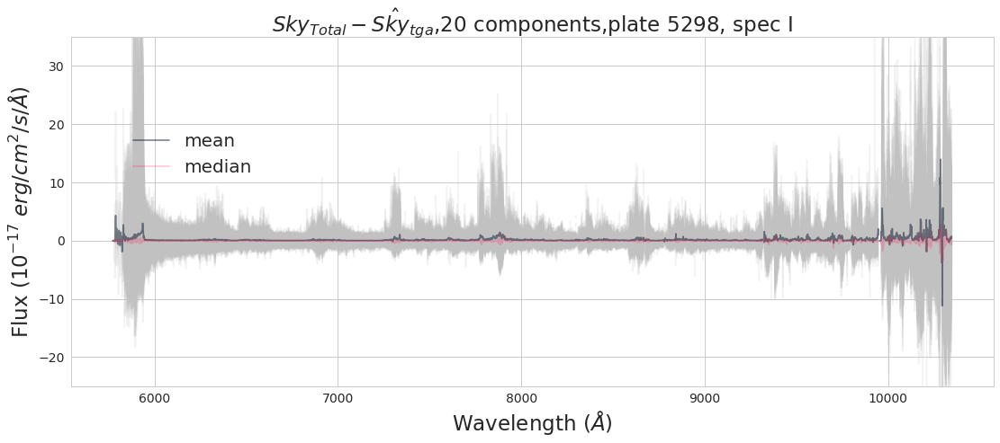

In [2245]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{Total} - \hat{Sky}_{tga}$,20 components,plate 5298, spec I",fontsize=23)
ax.set_ylim(-25,35)
#Standard PCA result compared to total flux
plate5298_tga_20_Totalres = plate5298_spec1_sky_total_flux - plate5298_tga_sky_20

for flux in plate5298_tga_20_Totalres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_tga_20_Totalres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_tga_20_Totalres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

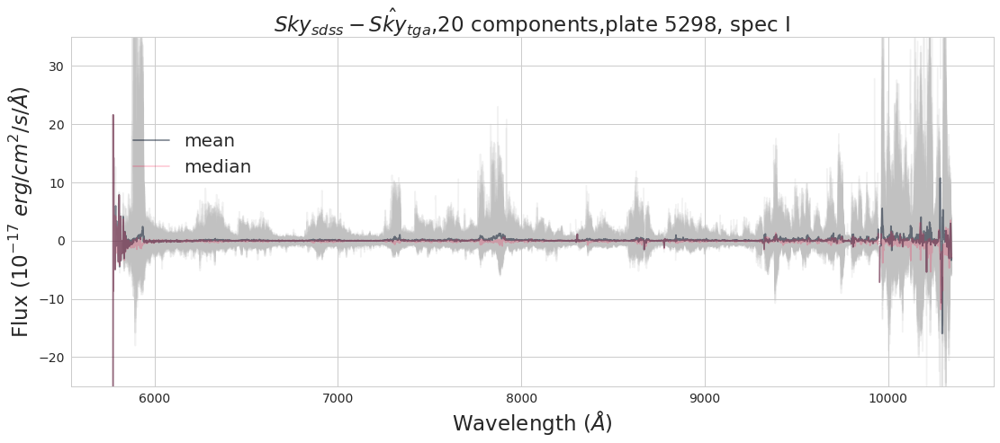

In [2247]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{sdss} - \hat{Sky}_{tga}$,20 components,plate 5298, spec I",fontsize=23)
ax.set_ylim(-25,35)
#Standard PCA result compared to total flux
plate5298_tga_20_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_tga_sky_20

for flux in plate5298_tga_20_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_tga_20_SDSSres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_tga_20_SDSSres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

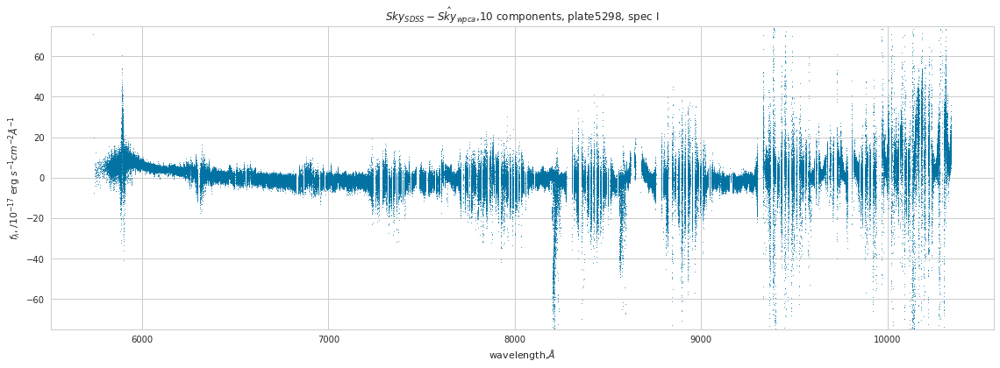

In [1562]:
x = plate5298_spec1_sky_wavelength
y = plate5298_spec1_sky_sdss_sky - plate5298_tga_sky10

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c='b')
plt.ylim(-75,75)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,10 components, plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

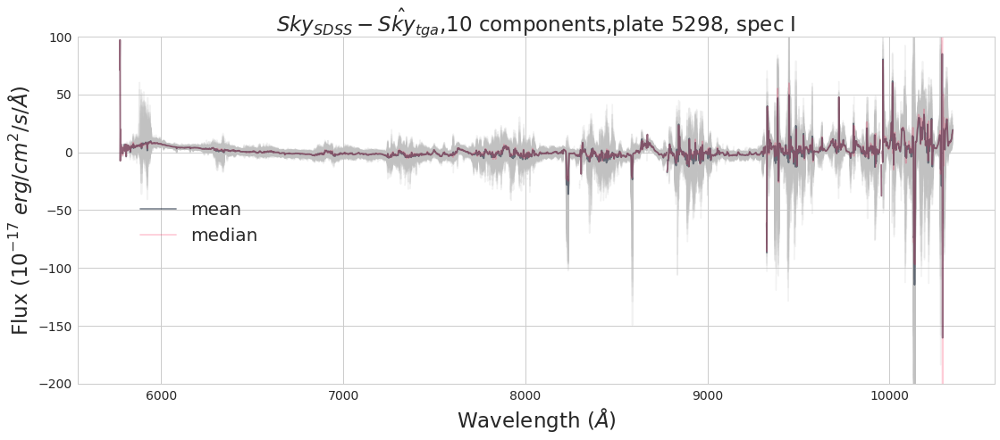

In [1567]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{tga}$,10 components,plate 5298, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate5298_tga_10_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_tga_sky10

for flux in plate5298_tga_10_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_tga_10_SDSSres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_tga_10_SDSSres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');
ax.set_ylim(-200,100)


ax.legend(loc=[0.06,0.38],fontsize=20);

In [ ]:
plate5298_tga_projected_sky_20

##### Plate 5298 TGA Sky Projection

In [ ]:
plate5298_tga_projected_sky_20

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:25: RuntimeWarning: Mean of empty slice


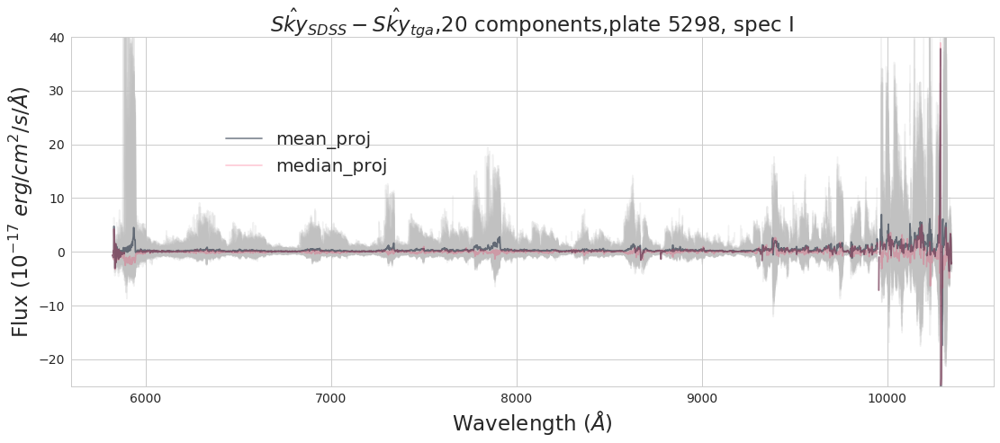

In [2256]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("$\hat{Sky}_{SDSS} - \hat{Sky}_{tga}$,20 components,plate 5298, spec I",fontsize=23)
ax.set_ylim(-25,40)

#Standard PCA result compared to total flux
plate5298_tga_proj_20_SDSSres = plate5298_spec1_sky_sdss_sky - plate5298_tga_projected_sky_20

for flux in plate5298_tga_proj_20_SDSSres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_tga_proj_20_SDSSres,axis=0),'-',color='#06152a',alpha=0.5,label='mean_proj');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_tga_proj_20_SDSSres,axis=0),'-',color='#fe003a',alpha=0.2,label='median_proj');


ax.legend(loc=[0.16,0.58],fontsize=20);

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:25: RuntimeWarning: Mean of empty slice


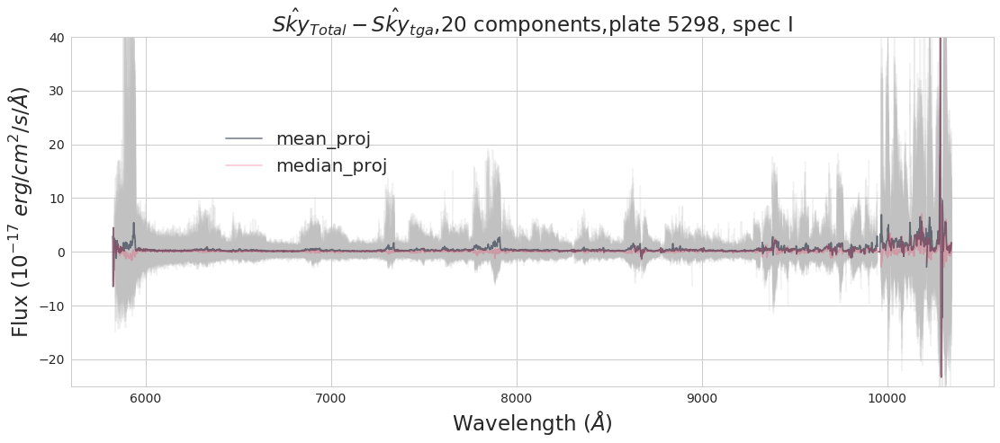

In [2257]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("$\hat{Sky}_{Total} - \hat{Sky}_{tga}$,20 components,plate 5298, spec I",fontsize=23)
ax.set_ylim(-25,40)

#Standard PCA result compared to total flux
plate5298_tga_proj_20_Totalres = plate5298_spec1_sky_total_flux - plate5298_tga_projected_sky_20

for flux in plate5298_tga_proj_20_Totalres:
    ax.plot(plate5298_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmean(plate5298_tga_proj_20_Totalres,axis=0),'-',color='#06152a',alpha=0.5,label='mean_proj');
ax.plot(plate5298_spec1_sky_wavelength[0,:],np.nanmedian(plate5298_tga_proj_20_Totalres,axis=0),'-',color='#fe003a',alpha=0.2,label='median_proj');


ax.legend(loc=[0.16,0.58],fontsize=20);

##### Plate 5298 TGA QSO Projection

In [1552]:
plate5298_spec1_all_QSO.shape

(332, 4128)

In [1573]:
plate5298_tga_projected_QSO_20 = tga_model(plate5298_spec1_all_sky,plate5298_spec1_all_QSO,ncomp=20, random_n=None)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 195 results
  r = func(a, **kwargs)


In [1574]:
plate5298_tga_projected_QSO_20.shape

(332, 4128)

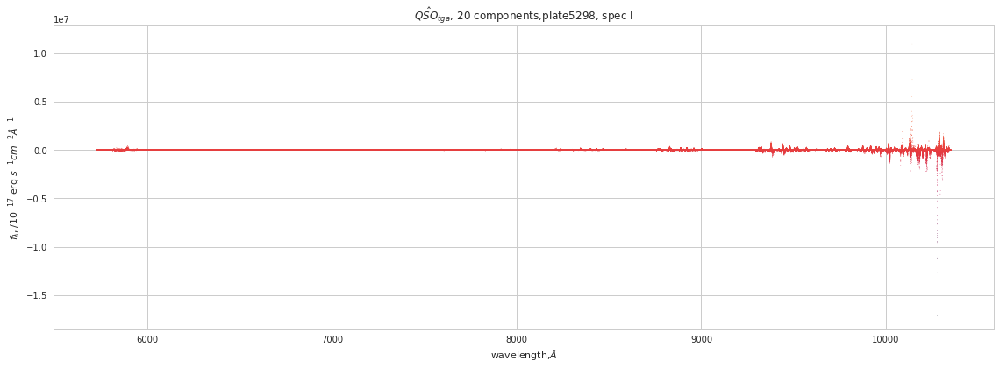

In [1575]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_tga_projected_QSO_20
plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)

plt.title("$\hat{QSO}_{tga}$, 20 components,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

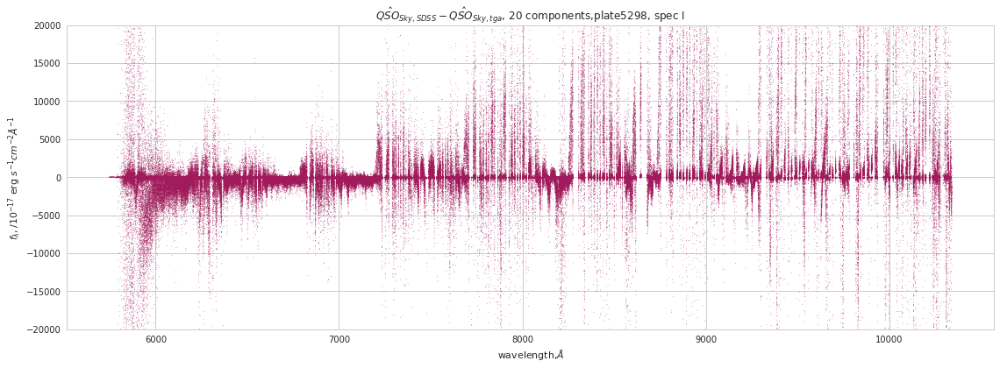

In [1576]:
x = plate5298_spec1_QSO_wavelength
y = plate5298_spec1_QSO_sdss_sky - plate5298_tga_projected_QSO_20

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20000,20000)
plt.title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,tga}$, 20 components,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


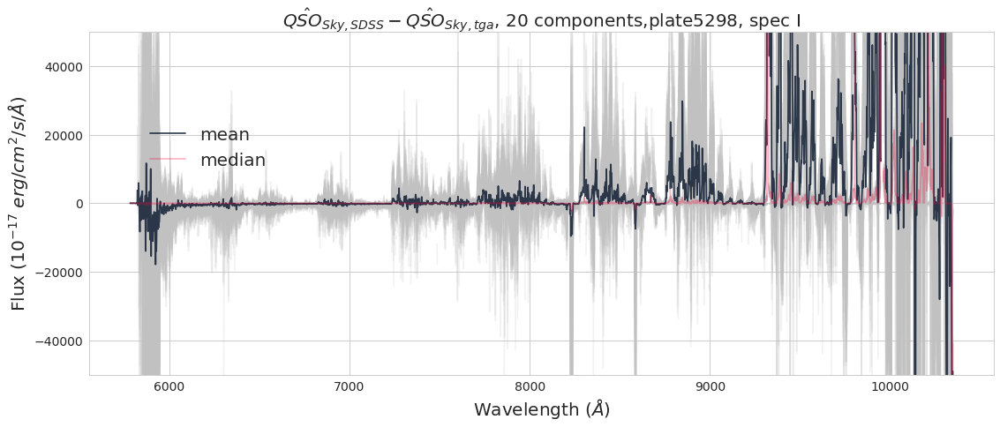

In [1579]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard TGA result compared to total flux
plate5298_tga_projected_QSO_20_SDSSres =plate5298_spec1_QSO_sdss_sky - plate5298_tga_projected_QSO_20

for flux in plate5298_tga_projected_QSO_20_SDSSres:
    ax.plot(plate5298_spec1_QSO_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmean(plate5298_tga_projected_QSO_20_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_QSO_wavelength[0,:],np.nanmedian(plate5298_tga_projected_QSO_20_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,tga}$, 20 components,plate5298, spec I",fontsize=20)
ax.set_ylim(-50000,50000)
ax.legend(loc=[0.06,0.58],fontsize=20);

##### Plate 5298 TGA Fstar Projection

In [1570]:
plate5298_spec1_all_Fstar.shape

(40, 4128)

In [2114]:
plate5298_tga_projected_Fstar_20 = tga_model(plate5298_spec1_all_sky,plate5298_spec1_all_Fstar,ncomp=20, random_n=None)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/ma/core.py:1019: RuntimeWarning: overflow encountered in multiply
  result = self.f(da, db, *args, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 769 results
  r = func(a, **kwargs)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/nanfunctions.py:1431: RuntimeWarning: overflow encountered in multiply
  sqr = np.multiply(arr, arr, out=arr)
/home/kunjias/.local/lib/python3.5/site-packages/numpy/core/fromnumeric.py:83: RuntimeWarning: overflow encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


In [1554]:
plate5298_tga_projected_Fstar_20.shape

(332, 4128)

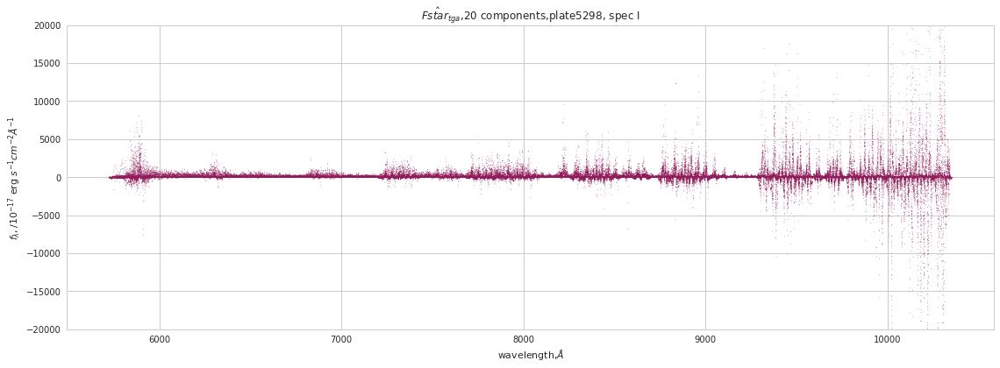

In [1582]:
x = plate5298_spec1_Fstar_wavelength
y = plate5298_tga_projected_Fstar_20
plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-20000,20000)

plt.title("$\hat{Fstar}_{tga}$,20 components,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

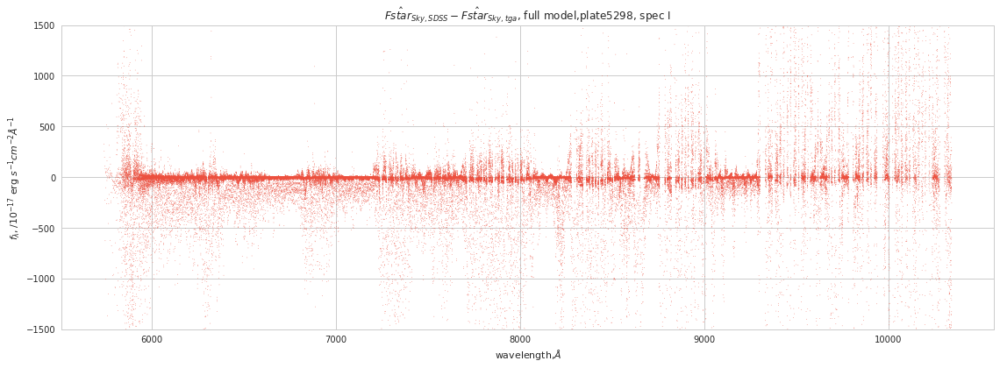

In [1585]:
x = plate5298_spec1_Fstar_wavelength
y = plate5298_spec1_Fstar_sdss_sky - plate5298_tga_projected_Fstar_20

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.1,c=y)
plt.ylim(-1500,1500)

plt.title("$\hat{Fstar}_{Sky,SDSS} - \hat{Fstar}_{Sky,tga}$, full model,plate5298, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: Mean of empty slice


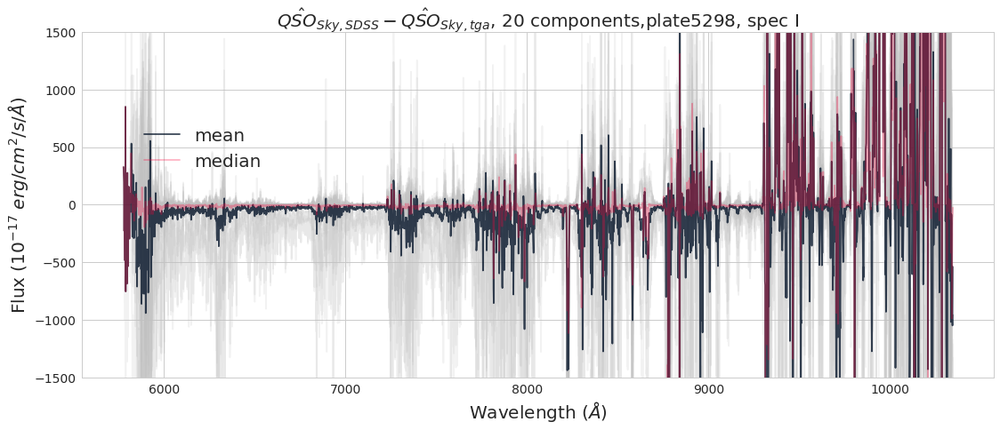

In [1587]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=20)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=20)

#Standard PCA result compared to total flux
plate5298_tga_projected_Fstar_20_SDSSres =plate5298_spec1_Fstar_sdss_sky - plate5298_tga_projected_Fstar_20

for flux in plate5298_tga_projected_Fstar_20_SDSSres:
    ax.plot(plate5298_spec1_Fstar_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate5298_spec1_Fstar_wavelength[0,:],np.nanmean(plate5298_tga_projected_Fstar_20_SDSSres,axis=0),'-',color='#06152a',alpha=0.8,label='mean');
ax.plot(plate5298_spec1_Fstar_wavelength[0,:],np.nanmedian(plate5298_tga_projected_Fstar_20_SDSSres,axis=0),'-',color='#fe003a',alpha=0.3,label='median');
ax.set_title("$\hat{QSO}_{Sky,SDSS} - \hat{QSO}_{Sky,tga}$, 20 components,plate5298, spec I",fontsize=20)
ax.set_ylim(-1500,1500)
ax.legend(loc=[0.06,0.58],fontsize=20);

##### Plate 4042 TGA Sky Reconstruction

In [1185]:
plate4042_tga_sky10= tga_sky(plate4042_spec1_all_sky,ncomp=10, random_n=None)

In [1186]:
plate3587_tga_sky10= tga_sky(plate3587_spec1_all_sky,ncomp=10, random_n=None)

In [897]:
#plate4042_robust_pca_sky_50 = tga_sky(plate4042_spec1_all_sky,ncomp=50, random_n=None)

In [715]:
QSO_tga = tga_model(plate4042_spec1_all_sky,plate4042_spec1_all_QSO,ncomp=45, random_n=None)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 2931 results
  r = func(a, **kwargs)


In [716]:
galaxy_tga = tga_model(plate4042_spec1_all_sky,plate4042_spec1_all_galaxy,ncomp=45, random_n=None)

/home/kunjias/.local/lib/python3.5/site-packages/numpy/lib/function_base.py:3250: RuntimeWarning: Invalid value encountered in median for 3139 results
  r = func(a, **kwargs)


In [718]:
galaxy_tga[50].shape

(4128,)

In [717]:
galaxy_tga.shape

(1675, 4128)

In [684]:
robust_pca_sky_50 = tga_sky(plate4042_spec1_all_sky,ncomp=50, random_n=None)

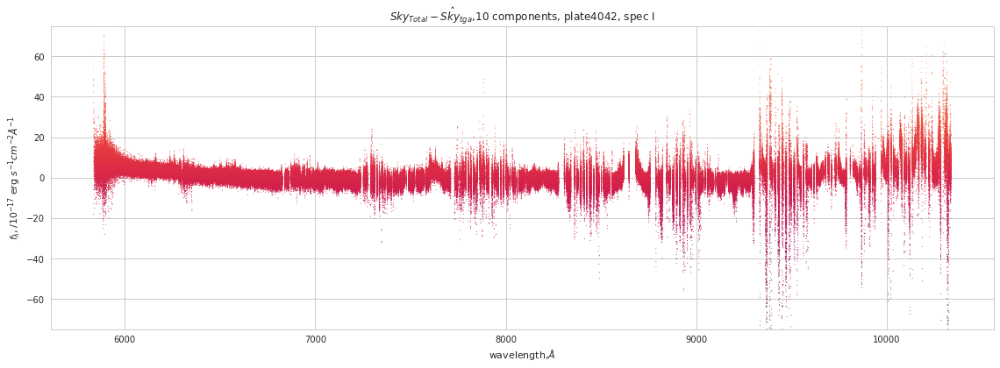

In [1191]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_total_flux - plate4042_tga_sky10

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-75,75)

plt.title("${Sky}_{Total} - \hat{Sky}_{tga}$,10 components, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

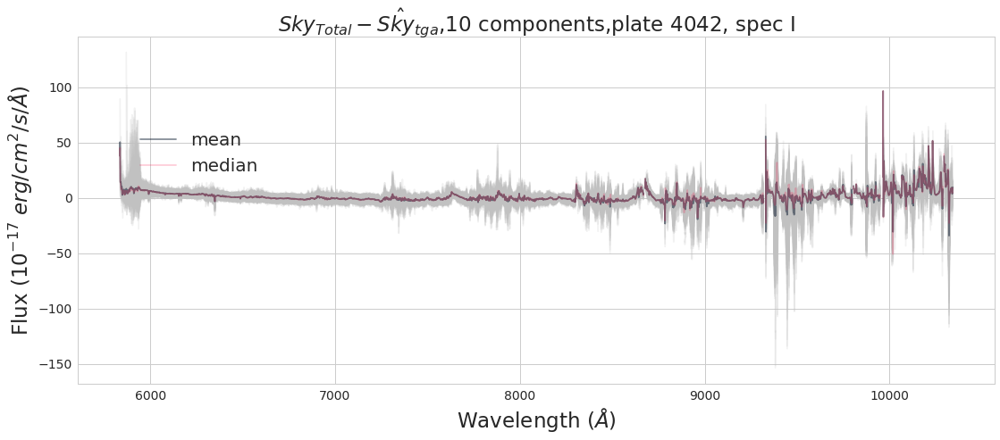

In [1292]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{Total} - \hat{Sky}_{tga}$,10 components,plate 4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_tga_10_Totalres = plate4042_spec1_sky_total_flux - plate4042_tga_sky10

for flux in plate4042_tga_10_Totalres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_tga_10_Totalres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_tga_10_Totalres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

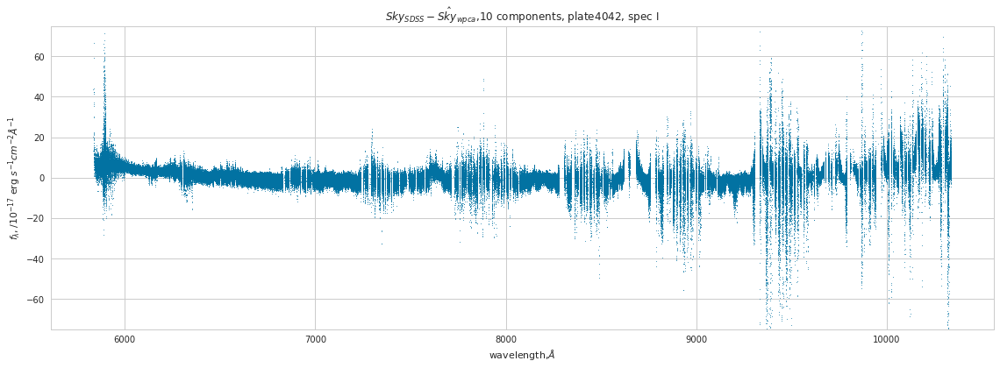

In [1190]:
x = plate4042_spec1_sky_wavelength
y = plate4042_spec1_sky_sdss_sky - plate4042_tga_sky10

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c='b')
plt.ylim(-75,75)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,10 components, plate4042, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

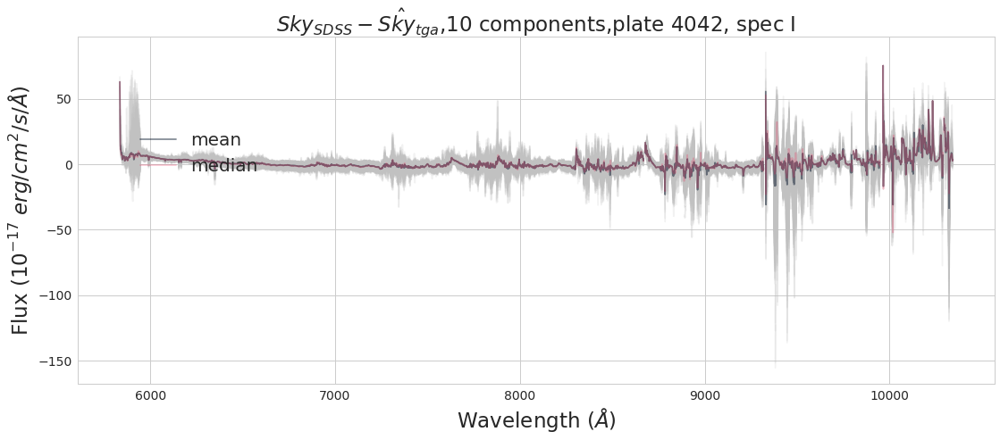

In [1291]:
fig = plt.figure(figsize=(16, 6))
fig.subplots_adjust(hspace=0.1, wspace=0.1, bottom=0.05, left=0.06, 
                    top=0.95, right=0.95)

ax = plt.gca()
fontsize = 14
ax.minorticks_on()

for tick in ax.xaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)
for tick in ax.yaxis.get_major_ticks():
    tick.label1.set_fontsize(fontsize)

ax.set_xlabel('Wavelength ($\AA$)',      fontsize=23)
ax.set_ylabel('Flux ($10^{-17}\ erg/cm^2/s/\AA$)', fontsize=23)
ax.set_title("${Sky}_{SDSS} - \hat{Sky}_{tga}$,10 components,plate 4042, spec I",fontsize=23)

#Standard PCA result compared to total flux
plate4042_tga_10_SDSSres = plate4042_spec1_sky_sdss_sky - plate4042_tga_sky10

for flux in plate4042_tga_10_SDSSres:
    ax.plot(plate4042_spec1_sky_wavelength[0,:],flux,'-',color='#c1c1c1',alpha=0.2);

ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmean(plate4042_tga_10_SDSSres,axis=0),'-',color='#06152a',alpha=0.5,label='mean');
ax.plot(plate4042_spec1_sky_wavelength[0,:],np.nanmedian(plate4042_tga_10_SDSSres,axis=0),'-',color='#fe003a',alpha=0.2,label='median');



ax.legend(loc=[0.06,0.58],fontsize=20);

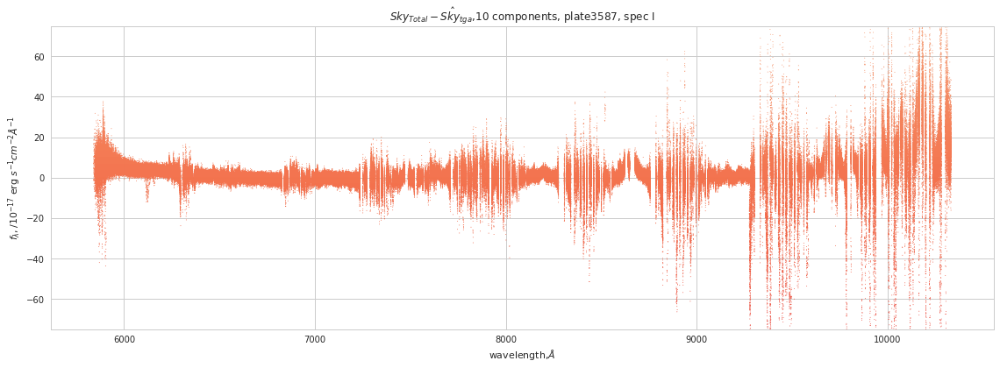

In [1189]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_total_flux - plate3587_tga_sky10

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c=y)
plt.ylim(-75,75)

plt.title("${Sky}_{Total} - \hat{Sky}_{tga}$,10 components, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

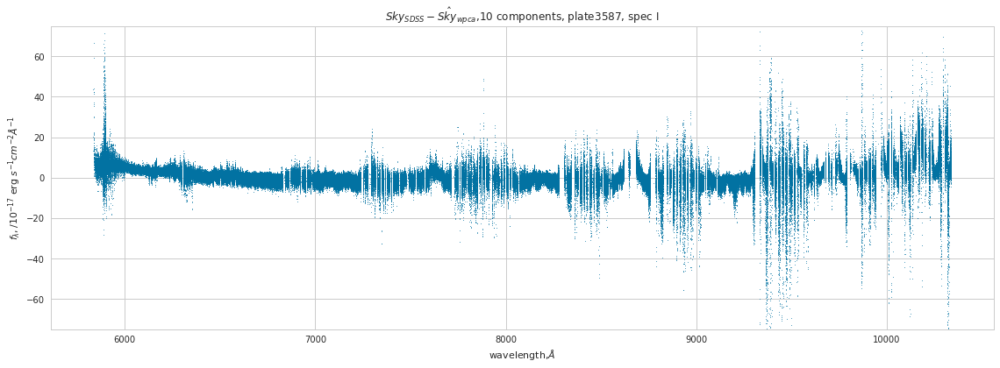

In [1188]:
x = plate3587_spec1_sky_wavelength
y = plate3587_spec1_sky_sdss_sky - plate3587_tga_sky10

plt.figure(figsize = (16,6))
plt.scatter(x,y,s=0.3,c='b')
plt.ylim(-75,75)

plt.title("${Sky}_{SDSS} - \hat{Sky}_{wpca}$,10 components, plate3587, spec I")
plt.xlabel("wavelength,$\AA$")
plt.ylabel("$f_{\lambda}, / 10^{-17}$ erg $s^{-1} cm^{-2} \AA^{-1}$")
plt.tight_layout()
plt.show()

## Object projection

In [729]:
galaxy_pca_flux = plate4042_spec1_galaxy_total_flux - galaxy_pca
galaxy_wpca_flux =  plate4042_spec1_galaxy_total_flux - galaxy_wpca
galaxy_tga_flux = plate4042_spec1_galaxy_total_flux - galaxy_tga

In [730]:
QSO_pca_flux = plate4042_spec1_QSO_total_flux - QSO_pca
QSO_wpca_flux =  plate4042_spec1_QSO_total_flux - QSO_wpca
QSO_tga_flux = plate4042_spec1_QSO_total_flux - QSO_tga

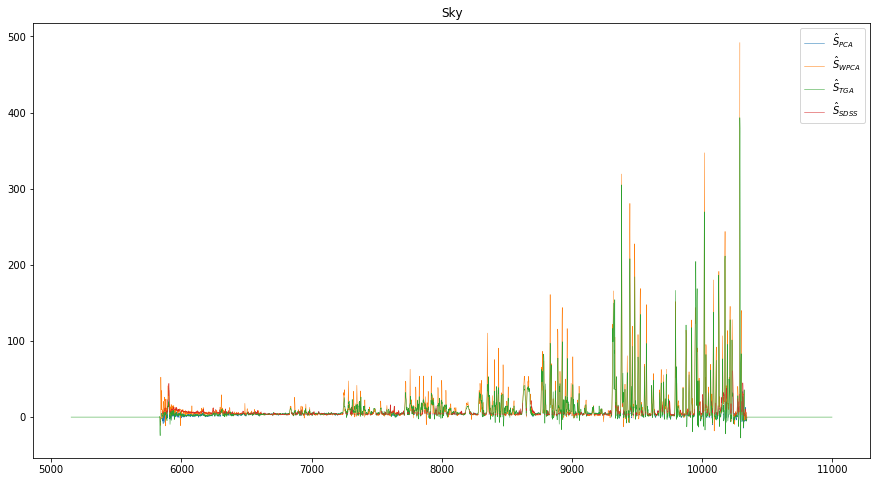

In [911]:
x = plate4042_spec1_sky_wavelength[0,:].data
y1 = plate4042_standard_pca_sky[50]
y2 = plate4042_weighted_pca_sky[50]
y3 = plate4042_robust_pca_sky[50]
y4 = plate4042_spec1_sky_sdss_sky[50]

plt.figure(figsize = (15,8))
plt.plot(x,y1,label = '$\hat{S}_{PCA}$',lw=0.5)
plt.plot(x,y2,label = '$\hat{S}_{WPCA}$',lw=0.5)
plt.plot(x,y3,label = '$\hat{S}_{TGA}$',lw=0.5)
plt.plot(x,y4,label = '$\hat{S}_{SDSS}$',lw=0.5)
plt.title("Sky")
plt.legend()

plt.show()

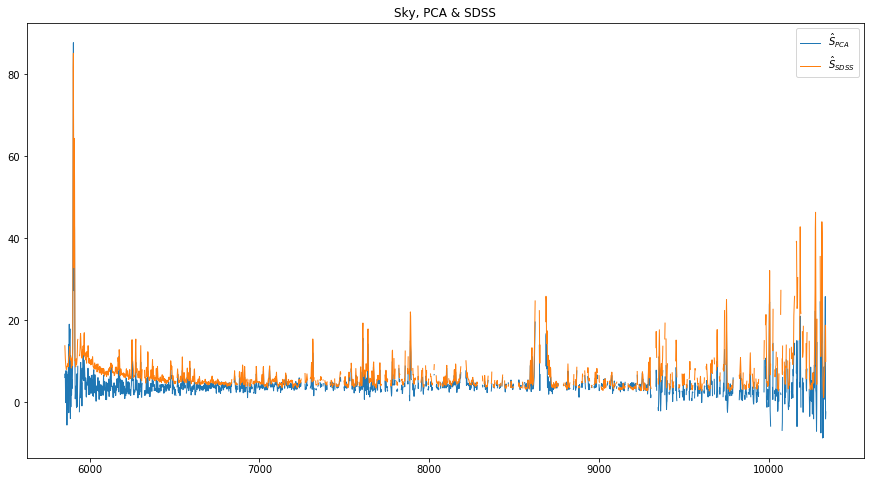

In [909]:
x = plate4042_spec1_sky_wavelength[0,:].data
y1 = plate4042_standard_pca_sky[5]
#y2 = plate4042_weighted_pca_sky[5]
#y3 = plate4042_robust_pca_sky[5]
y4 = plate4042_spec1_sky_sdss_sky[5]

plt.figure(figsize = (15,8))
plt.plot(x,y1,label = '$\hat{S}_{PCA}$',lw=1)
#plt.plot(x,y2,label = '$\hat{S}_{WPCA}$',lw=0.5)
#plt.plot(x,y3,label = '$\hat{S}_{TGA}$',lw=0.5)
plt.plot(x,y4,label = '$\hat{S}_{SDSS}$',lw=1)
plt.title("Sky, PCA & SDSS")
plt.legend()

plt.show()

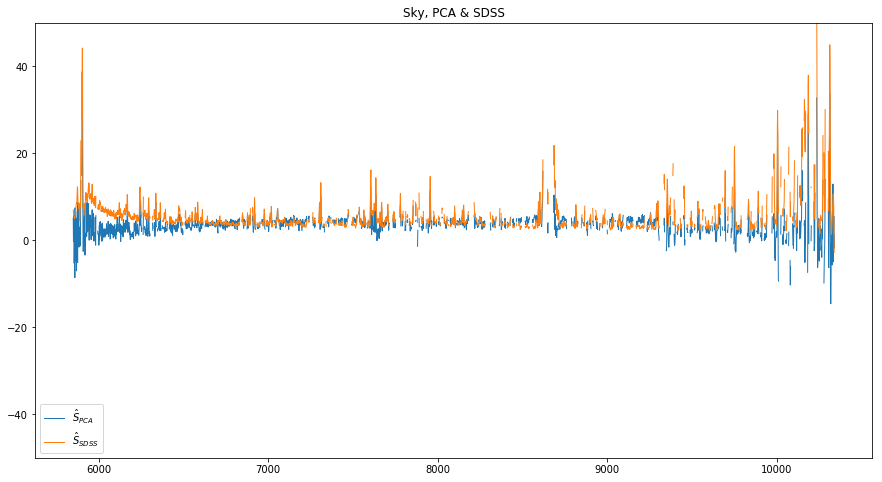

In [907]:
x = plate4042_spec1_sky_wavelength[0,:].data
y1 = plate4042_standard_pca_sky[50]
#y2 = plate4042_weighted_pca_sky[5]
#y3 = plate4042_robust_pca_sky[5]
y4 = plate4042_spec1_sky_sdss_sky[50]

plt.figure(figsize = (15,8))
plt.plot(x,y1,label = '$\hat{S}_{PCA}$',lw=1)
#plt.plot(x,y2,label = '$\hat{S}_{WPCA}$',lw=0.5)
#plt.plot(x,y3,label = '$\hat{S}_{TGA}$',lw=0.5)
plt.plot(x,y4,label = '$\hat{S}_{SDSS}$',lw=1)
plt.title("Sky, PCA & SDSS")
plt.ylim(-50,50)
plt.legend()

plt.show()

In [ ]:
x = plate4042_spec1_sky_wavelength[0,:].data
y1 = plate4042_standard_pca_sky[50]
#y2 = plate4042_weighted_pca_sky[5]
#y3 = plate4042_robust_pca_sky[5]
y4 = plate4042_spec1_sky_sdss_sky[50]

plt.figure(figsize = (15,8))
plt.plot(x,y1,label = '$\hat{S}_{PCA}$',lw=1)
#plt.plot(x,y2,label = '$\hat{S}_{WPCA}$',lw=0.5)
#plt.plot(x,y3,label = '$\hat{S}_{TGA}$',lw=0.5)
plt.plot(x,y4,label = '$\hat{S}_{SDSS}$',lw=1)
plt.title("Sky")
plt.ylim(-50,50)
plt.legend()

plt.show()

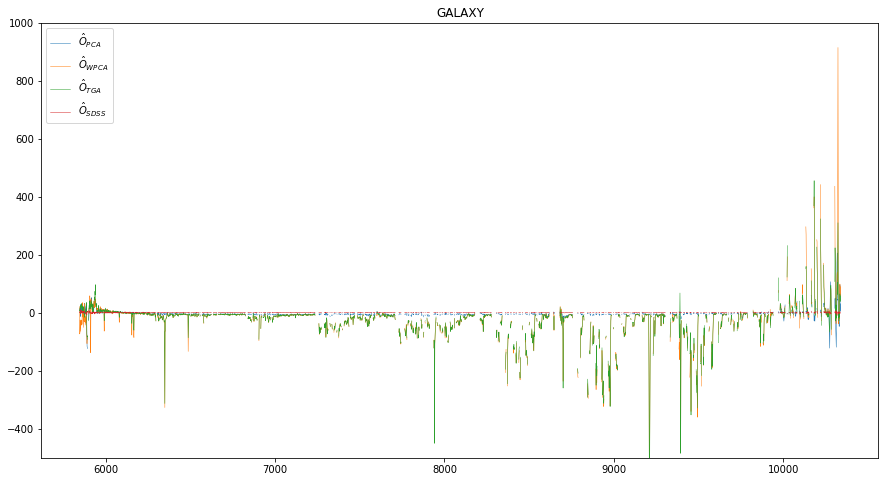

In [738]:
x = plate4042_spec1_sky_wavelength[0,:].data
y1 = galaxy_pca_flux[5]
y2 = galaxy_wpca_flux[5]
y3 = galaxy_tga_flux[5]
y4 = plate4042_spec1_galaxy_sdss_flux[5]

plt.figure(figsize = (15,8))
plt.plot(x,y1,label = '$\hat{O}_{PCA}$',lw=0.5)
plt.plot(x,y2,label = '$\hat{O}_{WPCA}$',lw=0.5)
plt.plot(x,y3,label = '$\hat{O}_{TGA}$',lw=0.5)
plt.plot(x,y4,label = '$\hat{O}_{SDSS}$',lw=0.5)
plt.title("GALAXY")
plt.ylim(-500,1000)
plt.legend()

plt.show()

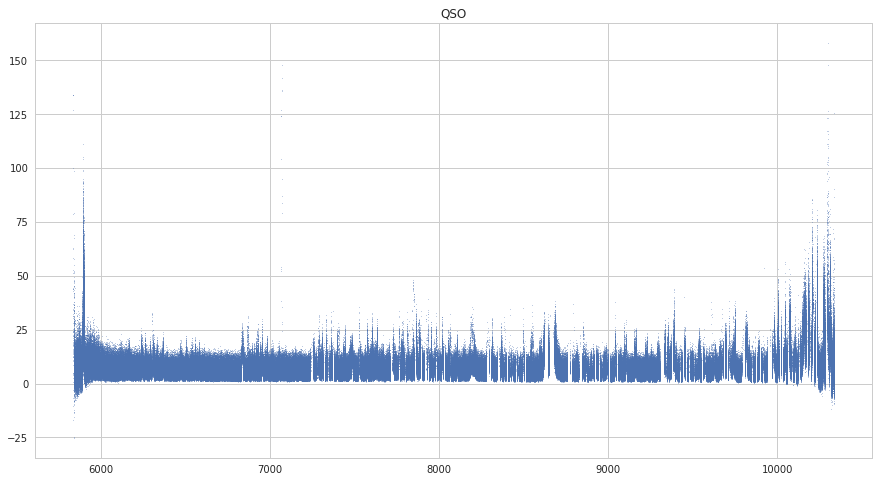

In [1120]:
x = plate4042_spec1_galaxy_wavelength.data
y = plate4042_spec1_galaxy_total_flux

plt.figure(figsize = (15,8))
plt.scatter(x,y, s=0.1)
plt.title("QSO")


plt.show()

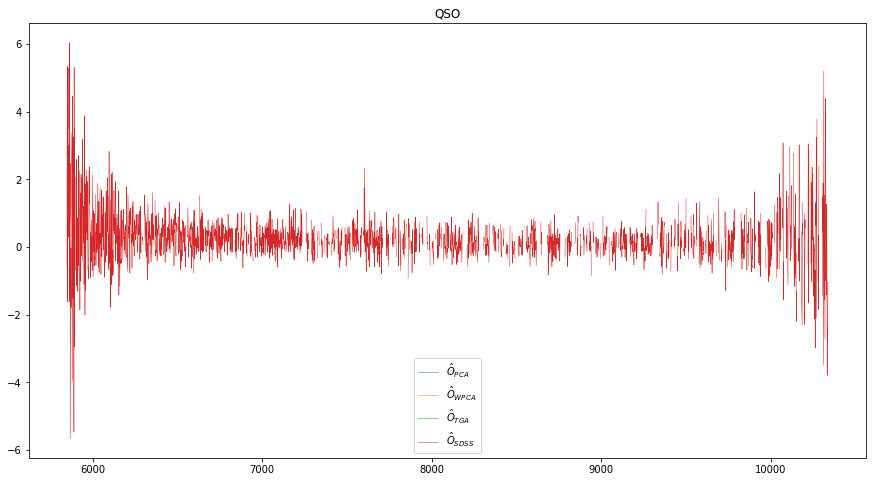

In [739]:
x = plate4042_spec1_sky_wavelength[0,:].data
y1 = QSO_pca_flux[5]
y2 = QSO_wpca_flux[5]
y3 = QSO_tga_flux[5]
y4 = plate4042_spec1_QSO_sdss_flux[5]

plt.figure(figsize = (15,8))
plt.plot(x,y1,label = '$\hat{O}_{PCA}$',lw=0.5)
plt.plot(x,y2,label = '$\hat{O}_{WPCA}$',lw=0.5)
plt.plot(x,y3,label = '$\hat{O}_{TGA}$',lw=0.5)
plt.plot(x,y4,label = '$\hat{O}_{SDSS}$',lw=0.5)
plt.title("QSO")
plt.legend()

plt.show()

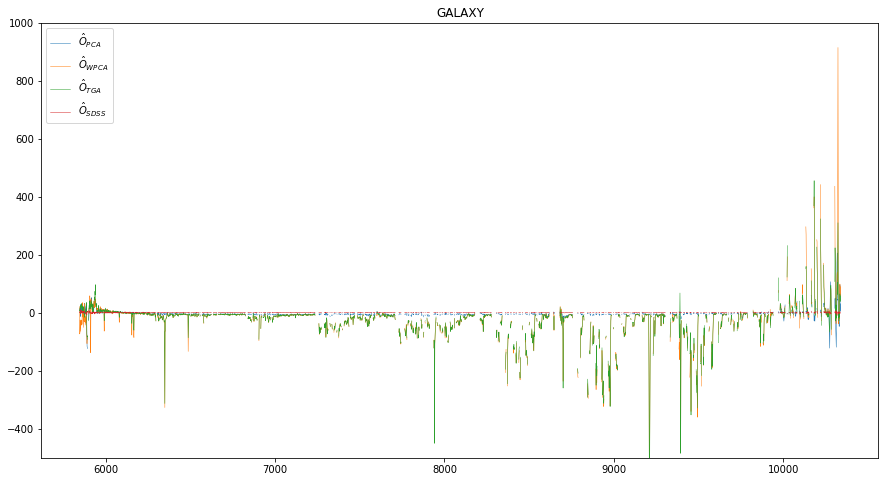

In [737]:
x = plate4042_spec1_sky_wavelength[0,:].data
y1 = galaxy_pca_flux[5]
y2 = galaxy_wpca_flux[5]
y3 = galaxy_tga_flux[5]
y4 = plate4042_spec1_galaxy_sdss_flux[5]

plt.figure(figsize = (15,8))
plt.plot(x,y1,label = '$\hat{O}_{PCA}$',lw=0.5)
plt.plot(x,y2,label = '$\hat{O}_{WPCA}$',lw=0.5)
plt.plot(x,y3,label = '$\hat{O}_{TGA}$',lw=0.5)
plt.plot(x,y4,label = '$\hat{O}_{SDSS}$',lw=0.5)
plt.ylim(-500,1000)
plt.title("GALAXY")
plt.legend()

plt.show()

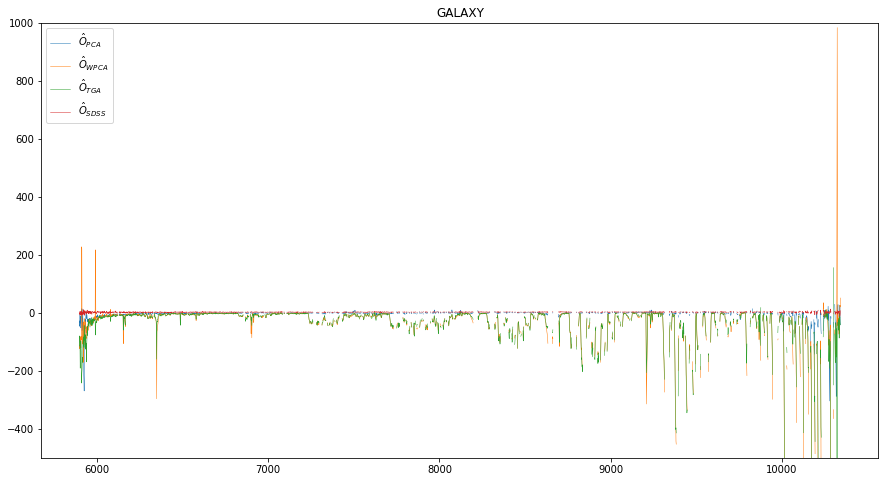

In [741]:
x = plate4042_spec1_sky_wavelength[0,:].data
y1 = galaxy_pca_flux[80]
y2 = galaxy_wpca_flux[80]
y3 = galaxy_tga_flux[80]
y4 = plate4042_spec1_galaxy_sdss_flux[80]

plt.figure(figsize = (15,8))
plt.plot(x,y1,label = '$\hat{O}_{PCA}$',lw=0.5)
plt.plot(x,y2,label = '$\hat{O}_{WPCA}$',lw=0.5)
plt.plot(x,y3,label = '$\hat{O}_{TGA}$',lw=0.5)
plt.plot(x,y4,label = '$\hat{O}_{SDSS}$',lw=0.5)
plt.ylim(-500,1000)
plt.title("GALAXY")
plt.legend()

plt.show()